In [1]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

In [2]:
df = pd.read_csv("dataport-export_gas_oct2015-mar2016.csv")

In [3]:
df.head()

,localminute,dataid,meter_value
0,2015-10-01 00:00:10-05,739,88858
1,2015-10-01 00:00:13-05,8890,197164
2,2015-10-01 00:00:20-05,6910,179118
3,2015-10-01 00:00:22-05,3635,151318
4,2015-10-01 00:00:22-05,1507,390354


In [4]:
df.dtypes

localminute    object
dataid          int64
meter_value     int64
dtype: object

In [5]:
df.groupby('dataid')['meter_value'].describe()

,count,mean,std,min,25%,50%,75%,max
dataid,,,,,,,,
35,11872.0,98799.541779,3585.696685,93470.0,95402.0,98397.0,102309.0,104692.0
44,1549.0,168857.252421,1621.907607,165674.0,167868.0,168188.0,169672.0,175070.0
77,10683.0,61162.735748,1655.197037,58832.0,59790.0,60742.0,62590.0,64652.0
94,36335.0,126452.122086,8260.652894,116642.0,117894.0,124482.0,134538.0,140358.0
114,2597.0,136067.471698,6187.644319,128294.0,129930.0,134774.0,143072.0,145298.0
...,...,...,...,...,...,...,...,...
9729,12361.0,129427.883019,5794.697171,122186.0,123380.0,128152.0,135684.0,138146.0
9766,2282.0,171690.504820,7682.217141,158512.0,161656.0,176406.0,177428.0,179902.0
9849,2741.0,35566.648668,1675.226417,33632.0,34070.0,35172.0,36632.0,39292.0


In [6]:
df['localminute'].head()

0    2015-10-01 00:00:10-05
1    2015-10-01 00:00:13-05
2    2015-10-01 00:00:20-05
3    2015-10-01 00:00:22-05
4    2015-10-01 00:00:22-05
Name: localminute, dtype: object

As we can see, the localminute column containing the timestamp for each meter reading is:
1. Incorrectly formatted - the the "-05" or "-06" at the end is timezone data, indicating when Daylight Savings Time begins and ends. We can extract this to create a new feature
2. Not in the datetime datatype

In [7]:
df['DST'] = pd.to_numeric(df['localminute'].str[-2:]) == 5
df

,localminute,dataid,meter_value,DST
0,2015-10-01 00:00:10-05,739,88858,True
1,2015-10-01 00:00:13-05,8890,197164,True
2,2015-10-01 00:00:20-05,6910,179118,True
3,2015-10-01 00:00:22-05,3635,151318,True
4,2015-10-01 00:00:22-05,1507,390354,True
...,...,...,...,...
1584818,2016-03-31 23:59:14.336743-05,2129,201726,True
1584819,2016-03-31 23:59:17.427165-05,2945,161232,True
1584820,2016-03-31 23:59:35.370782-05,9729,138146,True
1584821,2016-03-31 23:59:47.816286-05,5129,166488,True


In [8]:
df['localminute'] = df['localminute'].str[:-3]
df['localminute'] = pd.to_datetime(df['localminute'], format='mixed').dt.strftime('%Y-%m-%d %H:%M:%S')
df['localminute'] = pd.to_datetime(df['localminute'])

In [9]:
df

,localminute,dataid,meter_value,DST
0,2015-10-01 00:00:10,739,88858,True
1,2015-10-01 00:00:13,8890,197164,True
2,2015-10-01 00:00:20,6910,179118,True
3,2015-10-01 00:00:22,3635,151318,True
4,2015-10-01 00:00:22,1507,390354,True
...,...,...,...,...
1584818,2016-03-31 23:59:14,2129,201726,True
1584819,2016-03-31 23:59:17,2945,161232,True
1584820,2016-03-31 23:59:35,9729,138146,True
1584821,2016-03-31 23:59:47,5129,166488,True


In [10]:
df.dtypes

localminute    datetime64[ns]
dataid                  int64
meter_value             int64
DST                      bool
dtype: object

In [11]:
df['dataid'].value_counts()

dataid
2034    75991
6910    69349
484     44034
5814    42424
5810    42234
        ...  
7566       32
9620       23
4671       21
6101        3
4874        2
Name: count, Length: 157, dtype: int64

Let's plot a time series graph for each dataid and try to see if there are any outliers, anomalies, or any patterns in the data. The meter values we have currently measure cumulative consumption and not marginal consumption.

In [12]:
df = df.set_index(df['dataid'])
df = df.drop(columns='dataid')

In [13]:
df.index.value_counts()

dataid
2034    75991
6910    69349
484     44034
5814    42424
5810    42234
        ...  
7566       32
9620       23
4671       21
6101        3
4874        2
Name: count, Length: 157, dtype: int64

In [14]:
df = df.drop([7566, 9620, 4671, 6101, 4874, 9160, 2755, 2946, 2814, 5545, 2645, 6685, 1403])
df.index.value_counts()

dataid
2034    75991
6910    69349
484     44034
5814    42424
5810    42234
        ...  
8059      529
5658      493
3036      336
9600      330
8703      258
Name: count, Length: 144, dtype: int64

I've gone ahead and dropped all the dataids that have less than 250 readings. I've seen later that these end up being quite problematic and irregular, so I've decided that they don't have enough data to be included in our investigation

In [15]:
df = df.reset_index()
df

,dataid,localminute,meter_value,DST
0,739,2015-10-01 00:00:10,88858,True
1,8890,2015-10-01 00:00:13,197164,True
2,6910,2015-10-01 00:00:20,179118,True
3,3635,2015-10-01 00:00:22,151318,True
4,1507,2015-10-01 00:00:22,390354,True
...,...,...,...,...
1584128,2129,2016-03-31 23:59:14,201726,True
1584129,2945,2016-03-31 23:59:17,161232,True
1584130,9729,2016-03-31 23:59:35,138146,True
1584131,5129,2016-03-31 23:59:47,166488,True


In [16]:
df = df.sort_values(by=['dataid', 'localminute'])

As we can see, the data is irregularly sampled, which is inconvenient to handle and creates a lot of uneccesary noise, especially as there is barely any difference at small intervals. Therefore we will extract the marginal consumption per hour from the cumulative readings using resampling.

In [17]:
# for dataid, group in df.groupby('dataid'):
#     fig, ax = plt.subplots(figsize=(10,5))
#     plt.plot(df[df['dataid'] == dataid].set_index("localminute")['meter_value'].diff())
#     ax.set_title(f'meter value by time for dataid {dataid}')
#     plt.show()

In [18]:
marginal_consumption = []
for dataid, group in df.groupby('dataid'):
    meter_value_diff = group['meter_value'].diff()
    marginal_consumption.append(meter_value_diff)


In [19]:
marginal_consumption = pd.concat(marginal_consumption)
df['marginal_consumption'] = marginal_consumption
df['marginal_consumption']

83          NaN
244         0.0
723         0.0
790         0.0
829         0.0
           ... 
1560987     0.0
1561582     2.0
1566451    48.0
1576619    68.0
1580897    72.0
Name: marginal_consumption, Length: 1584133, dtype: float64

In [20]:
df['marginal_consumption'] = df['marginal_consumption'].fillna(0)

In [21]:
df

,dataid,localminute,meter_value,DST,marginal_consumption
83,35,2015-10-01 00:14:44,93470,True,0.0
244,35,2015-10-01 00:42:34,93470,True,0.0
723,35,2015-10-01 02:02:37,93470,True,0.0
790,35,2015-10-01 02:12:38,93470,True,0.0
829,35,2015-10-01 02:20:36,93470,True,0.0
...,...,...,...,...,...
1560987,9982,2016-03-28 09:25:54,119734,True,0.0
1561582,9982,2016-03-28 11:29:41,119736,True,2.0
1566451,9982,2016-03-29 04:38:38,119784,True,48.0
1576619,9982,2016-03-30 17:46:42,119852,True,68.0


In [22]:
resampled_consumption = []
dataid_column = []
table = []

for dataid, group in df.groupby('dataid'):
    resample = group.resample('h', on='localminute')['marginal_consumption'].sum()
    resampled_consumption.append(resample)
    for i in range(len(resample)):
        dataid_column.append(dataid)

In [23]:
consumption_series = pd.concat(resampled_consumption)
consumption_series

localminute
2015-10-01 00:00:00     0.0
2015-10-01 01:00:00     0.0
2015-10-01 02:00:00     0.0
2015-10-01 03:00:00     0.0
2015-10-01 04:00:00     0.0
                       ... 
2016-03-31 07:00:00     0.0
2016-03-31 08:00:00     0.0
2016-03-31 09:00:00     0.0
2016-03-31 10:00:00     0.0
2016-03-31 11:00:00    72.0
Name: marginal_consumption, Length: 591478, dtype: float64

In [24]:
df = pd.DataFrame(consumption_series)

In [25]:
len(dataid_column)

591478

In [26]:
df['dataid'] = dataid_column
df

,marginal_consumption,dataid
localminute,,
2015-10-01 00:00:00,0.0,35
2015-10-01 01:00:00,0.0,35
2015-10-01 02:00:00,0.0,35
2015-10-01 03:00:00,0.0,35
2015-10-01 04:00:00,0.0,35
...,...,...
2016-03-31 07:00:00,0.0,9982
2016-03-31 08:00:00,0.0,9982
2016-03-31 09:00:00,0.0,9982


In [27]:
df['DST'] = df.index.map( lambda x: 1 if x < pd.to_datetime('2015-11-01 01:00:00', format='mixed') or x > pd.to_datetime('2016-03-13 02:00:00', format='mixed') else 0 )

In [28]:
df

,marginal_consumption,dataid,DST
localminute,,,
2015-10-01 00:00:00,0.0,35,1
2015-10-01 01:00:00,0.0,35,1
2015-10-01 02:00:00,0.0,35,1
2015-10-01 03:00:00,0.0,35,1
2015-10-01 04:00:00,0.0,35,1
...,...,...,...
2016-03-31 07:00:00,0.0,9982,1
2016-03-31 08:00:00,0.0,9982,1
2016-03-31 09:00:00,0.0,9982,1


Now we have our new dataset resampled by the hour, with marginal consumption extracted. Let's have a look at the time series graphs now.

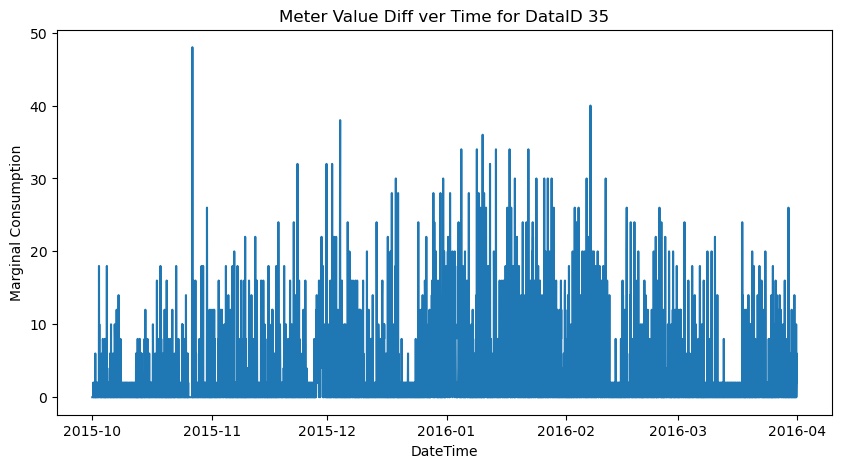

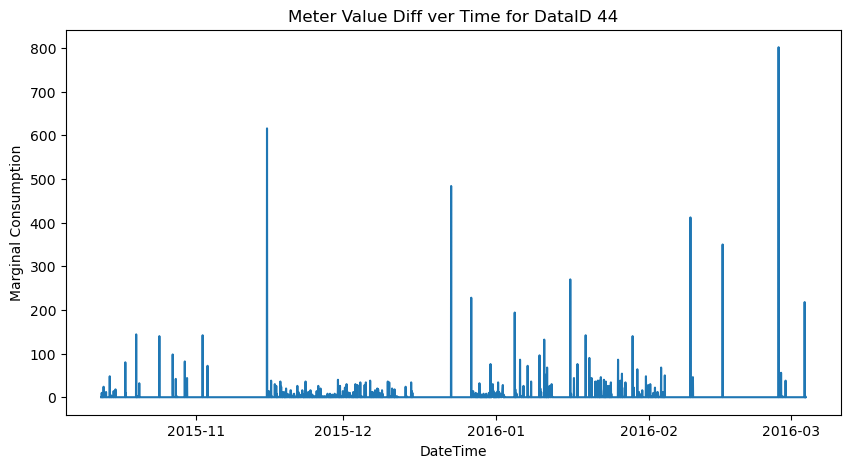

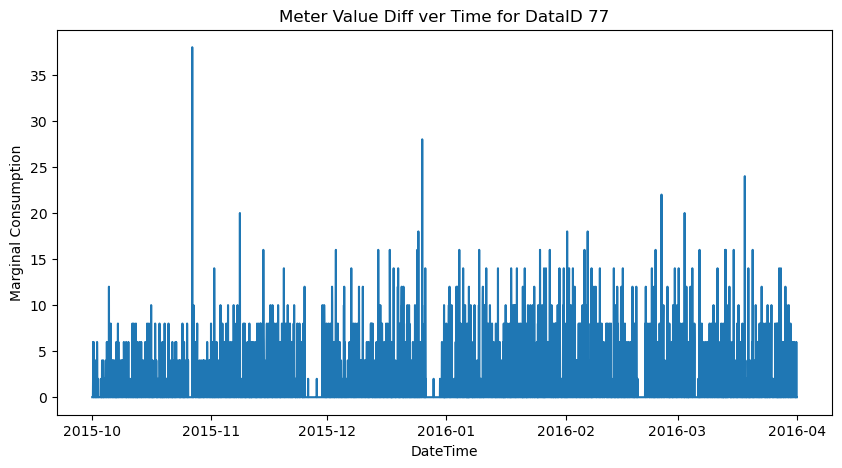

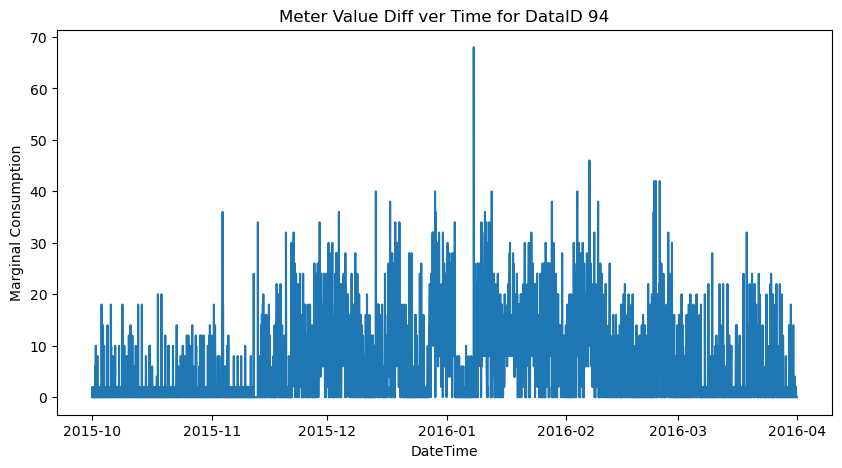

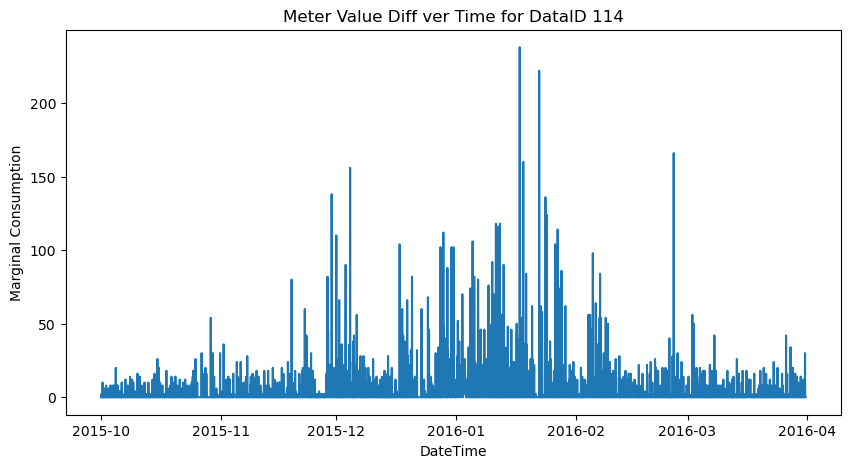

...

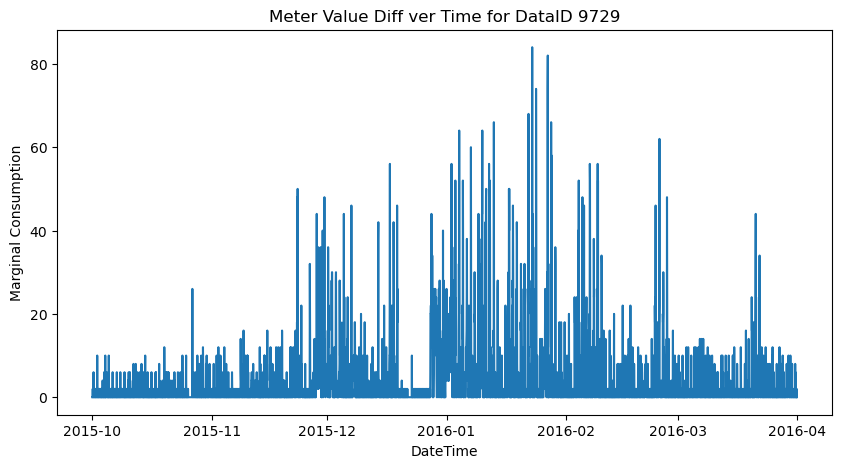

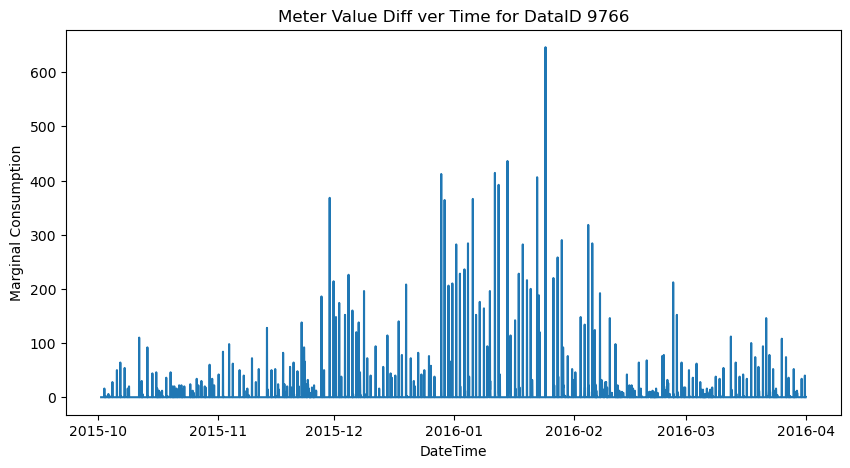

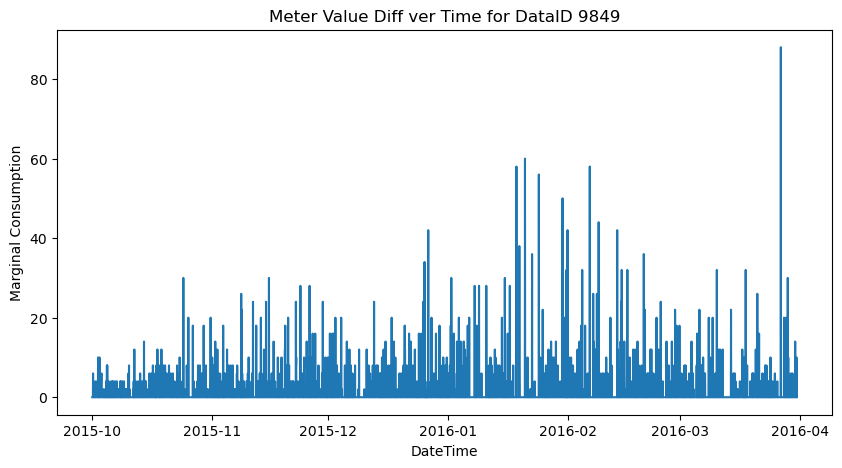

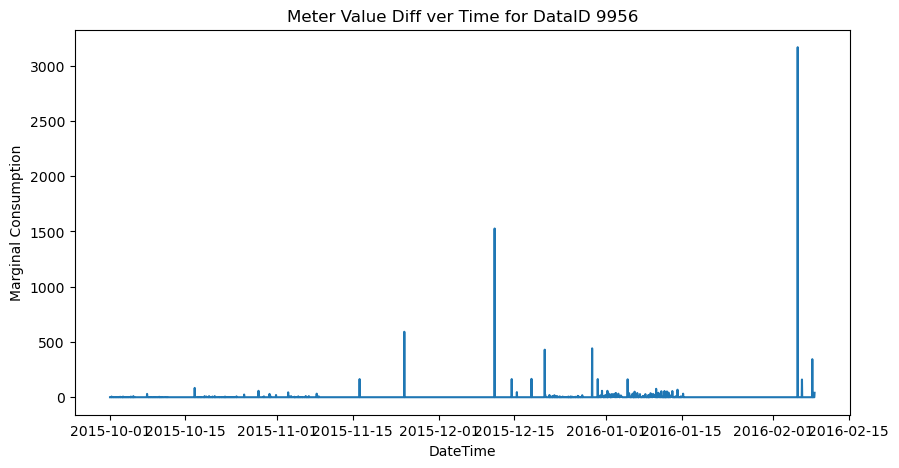

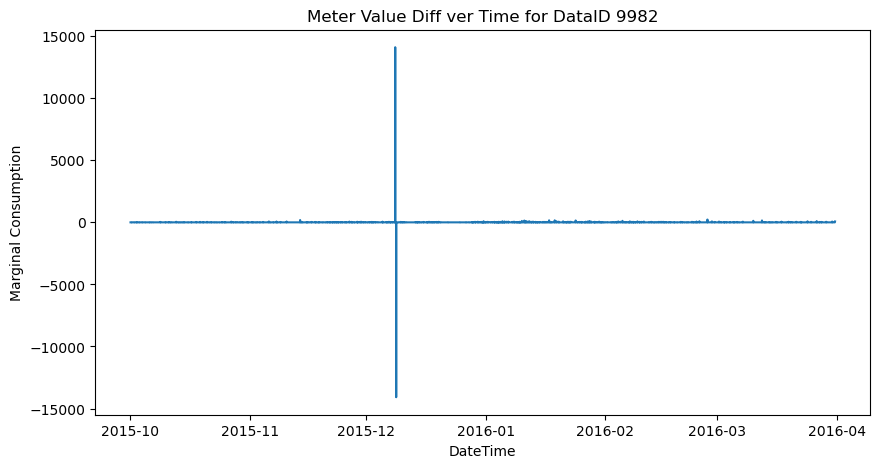

In [29]:
for dataid, group in df.groupby('dataid'):
    plt.figure(figsize=(10, 5))
    plt.plot(group.index, group['marginal_consumption'], label=f'Meter {dataid}')
    plt.xlabel('DateTime')
    plt.ylabel('Marginal Consumption')
    plt.title(f'Meter Value Diff ver Time for DataID {dataid}')
    plt.show()

It seems there are outliers present that could hamper our model performance. Let us try and remove them. Firstly, let's start with the ones with a large negative marginal consumption. Since our meter value data is cumulative, the marginal consumption cannot be negative

In [30]:
df = df[~df['dataid'].isin(df[df['marginal_consumption'] < -50]['dataid'].unique())]   

In [31]:
len(df[df['marginal_consumption'] < -50]['dataid'].unique())

0

In [32]:
len(df['dataid'].unique())

129

In [33]:
extreme = df[df['marginal_consumption'] > 5000]['dataid'].unique()

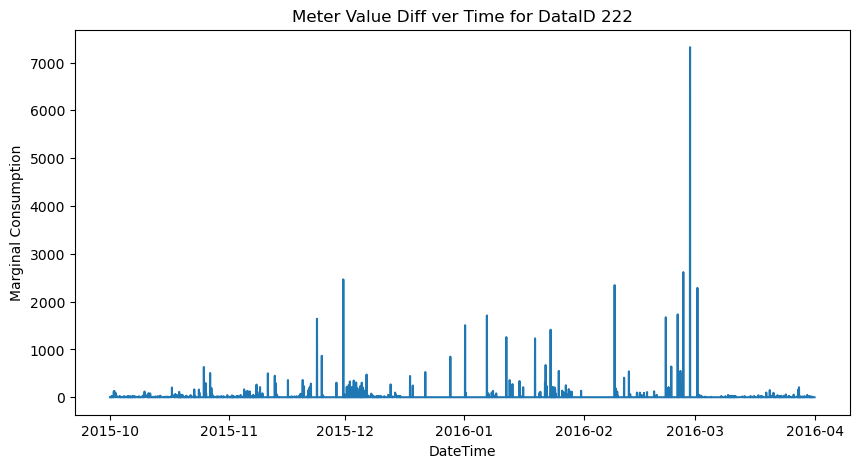

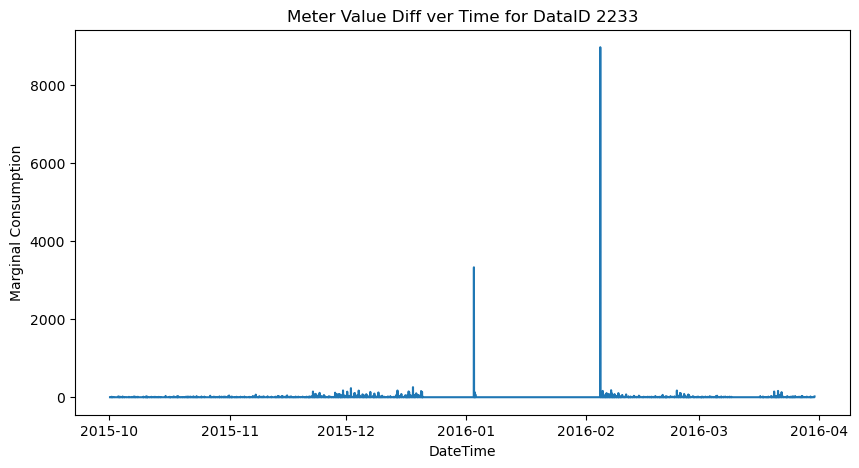

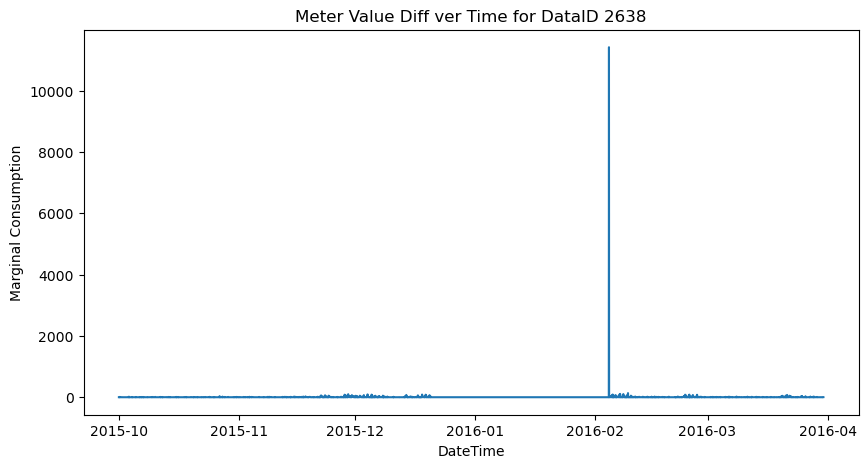

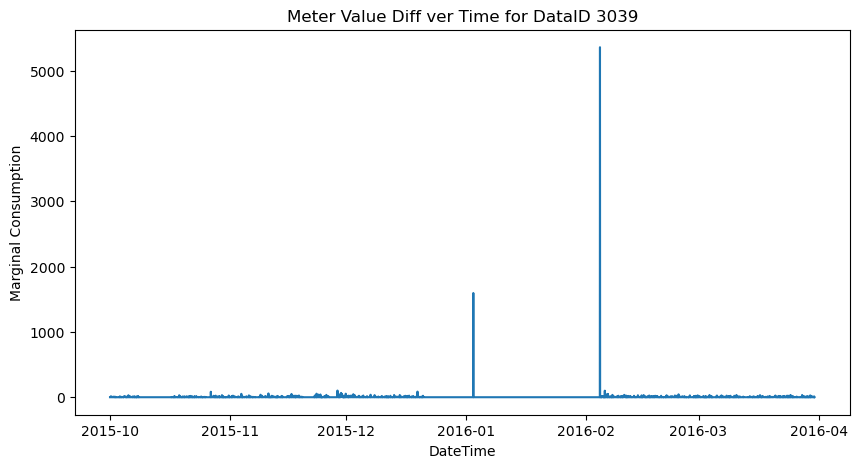

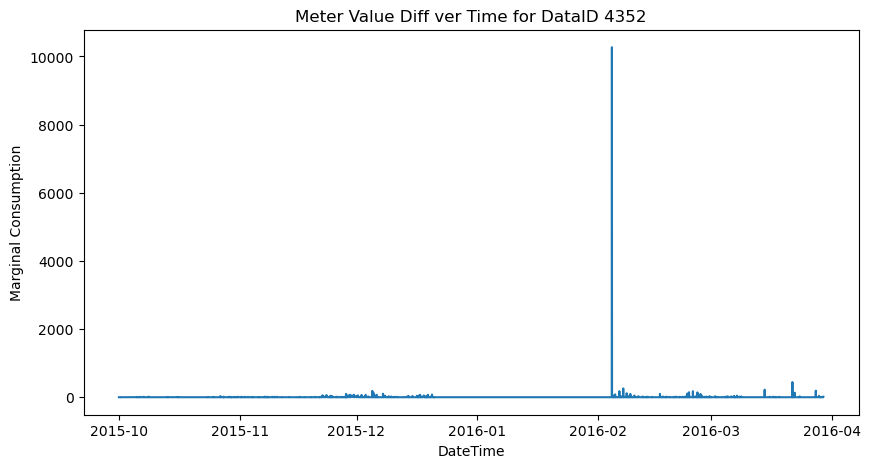

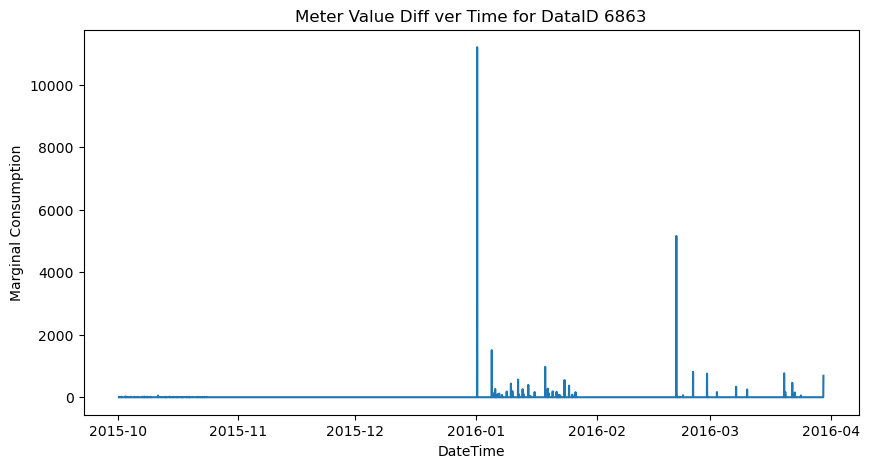

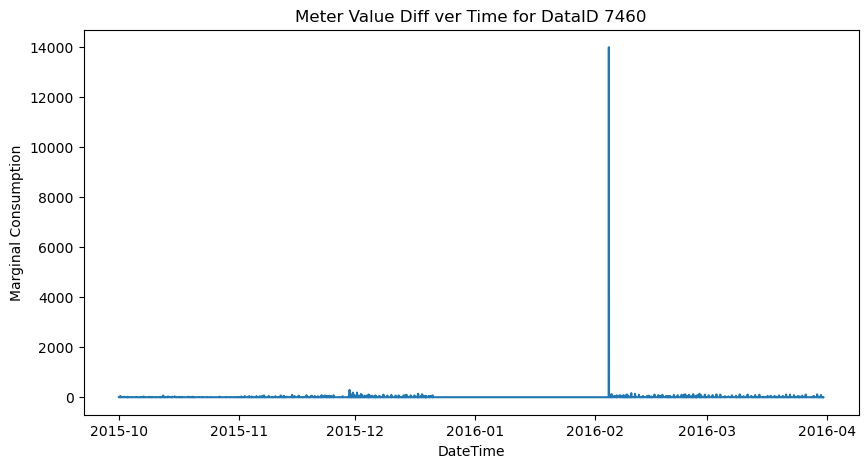

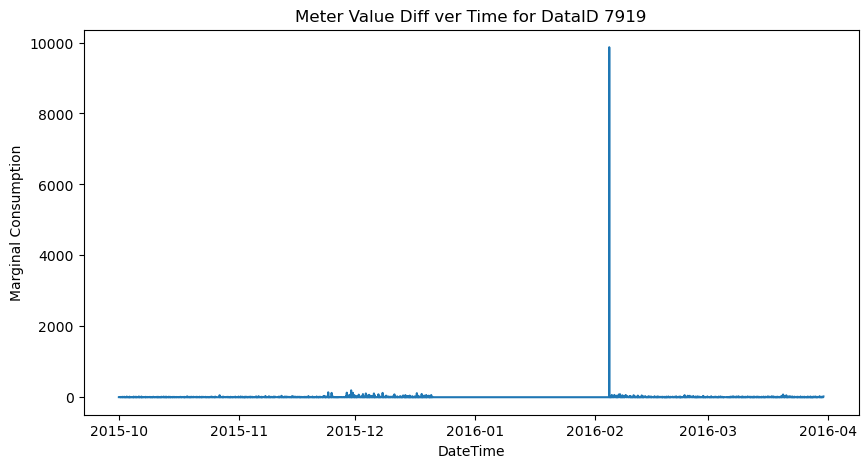

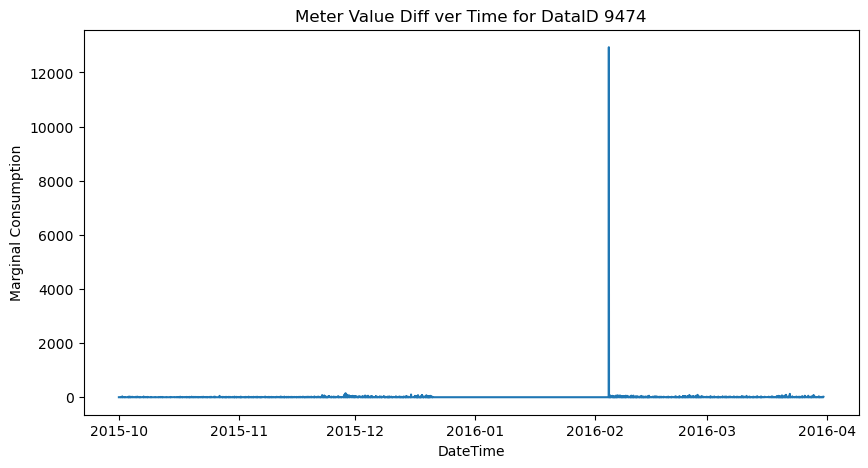

In [34]:
for dataid, group in df.groupby('dataid'):
    if dataid in extreme:
        plt.figure(figsize=(10, 5))
        plt.plot(group.index, group['marginal_consumption'], label=f'Meter {dataid}')
        plt.xlabel('DateTime') 
        plt.ylabel('Marginal Consumption')
        plt.title(f'Meter Value Diff ver Time for DataID {dataid}')
        plt.show() 

In [35]:
len(df[df['dataid'] == 4874])

0

In [36]:
df['marginal_consumption'].min()

0.0

In [37]:
len(df[df['marginal_consumption'] > 1000]['dataid'].unique())

22

In [38]:
df.to_csv("./formatted_data.csv")

In [76]:
from scipy import stats

In [41]:
# for dataid, group in df.groupby('dataid'):
#     plt.hist(group.marginal_consumption, bins=20, rwidth=0.8)
#     plt.title(f'Marginal consumption Dist for DataID {dataid}')
#     plt.show()



In [42]:
# for dataid, group in df.groupby('dataid'):
#     cap = group['marginal_consumption'].quantile(0.997)
#     print(f"Dataid {dataid} threshold: {cap}")
#     # group["marginal_consumption"] = np.where(group["marginal_consumption"] > cap, cap, group['marginal_consumption'])

In [77]:
from scipy.stats.mstats import winsorize

Dataid 35 threshold: 18.0


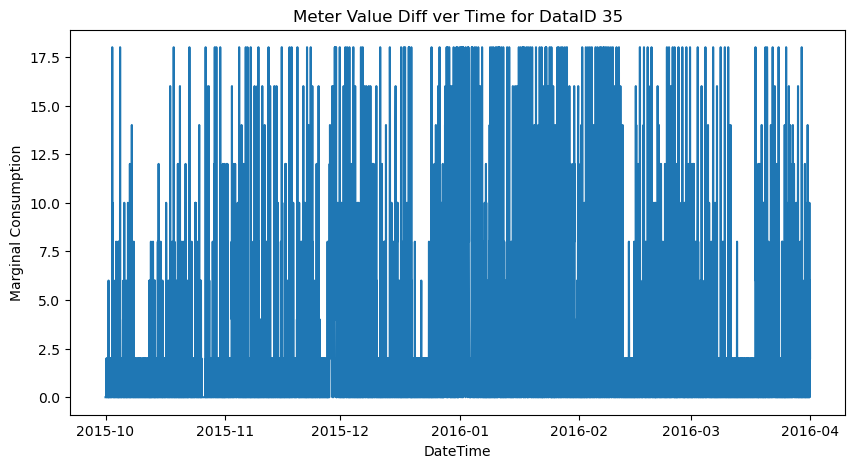

Dataid 44 threshold: 18.0


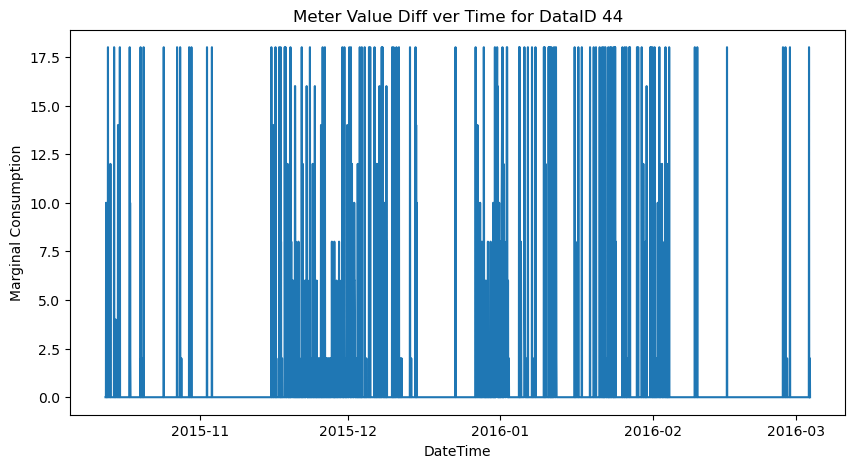

Dataid 77 threshold: 10.0


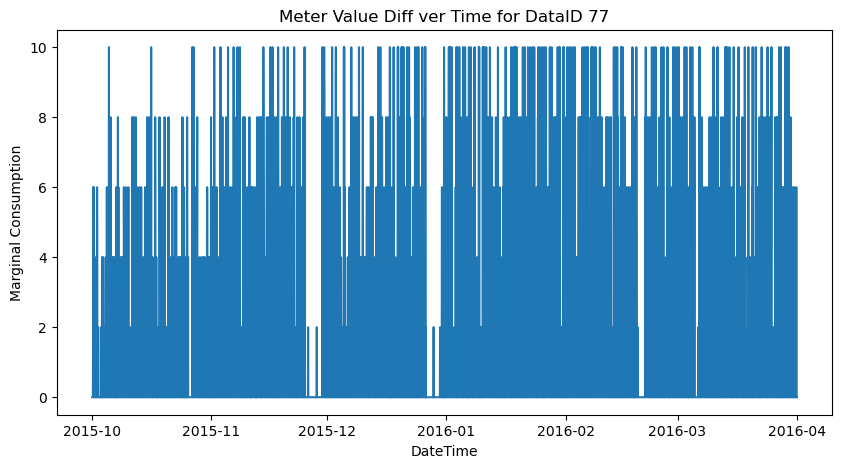

Dataid 94 threshold: 24.0


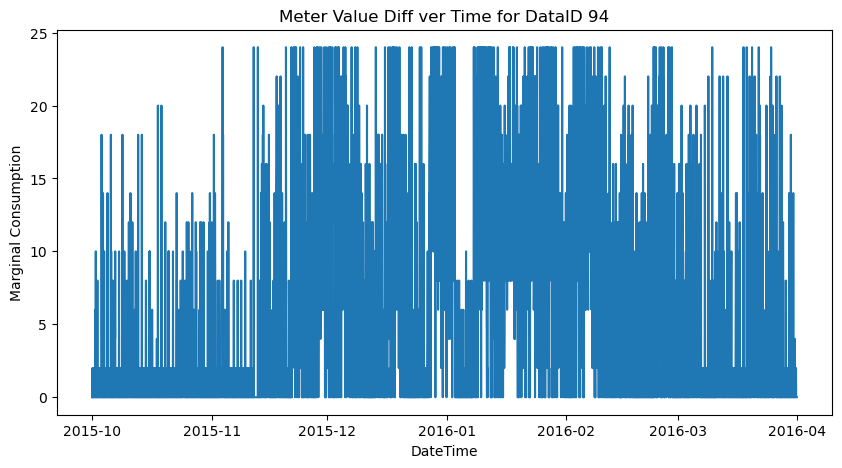

Dataid 114 threshold: 30.0


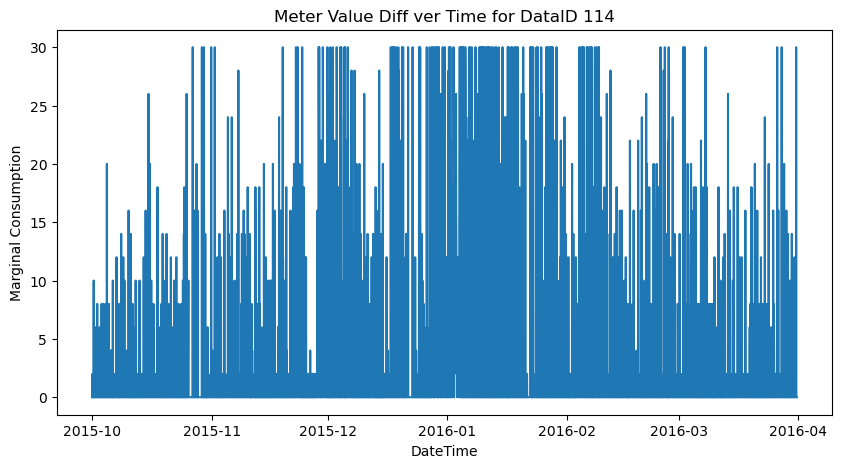

Dataid 187 threshold: 34.0


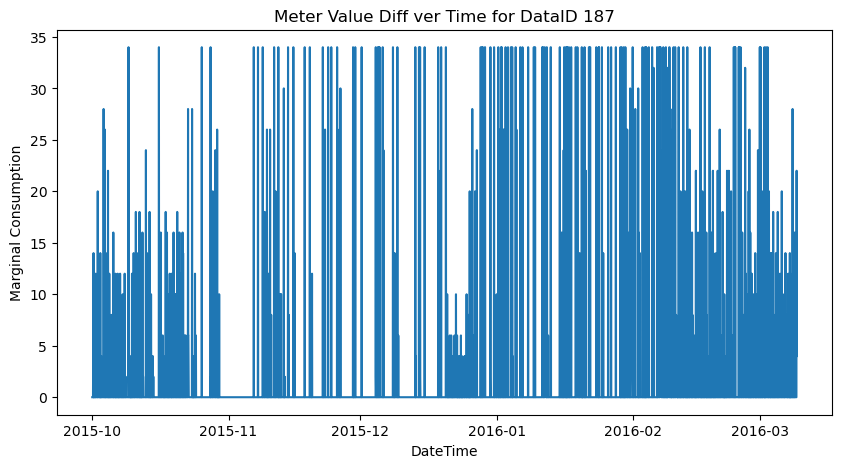

Dataid 222 threshold: 74.0


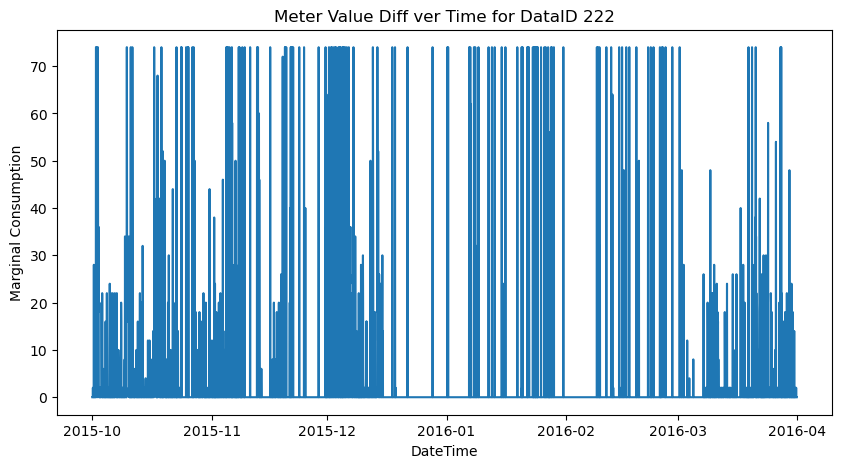

Dataid 252 threshold: 34.0


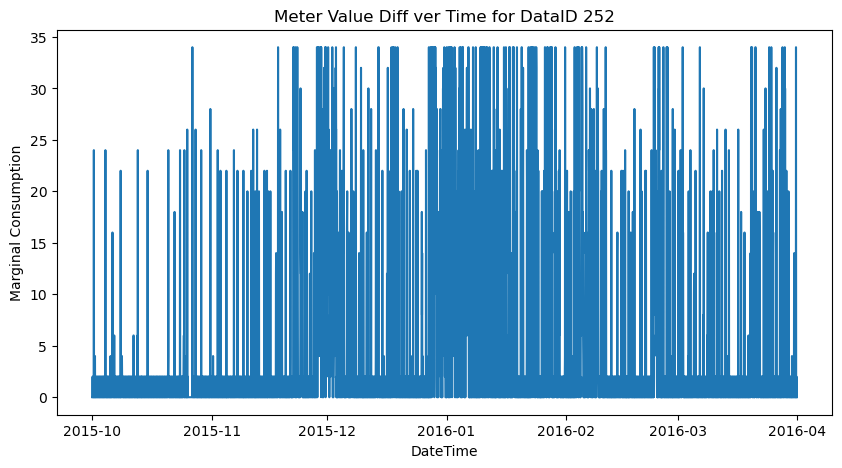

Dataid 370 threshold: 20.0


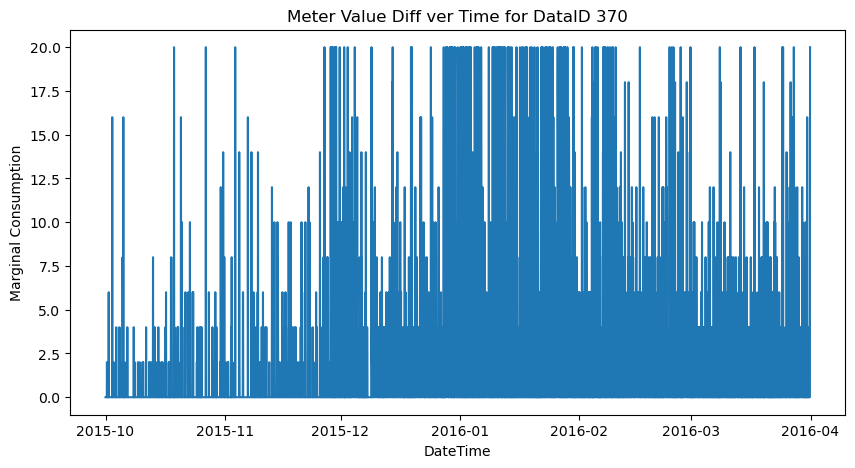

Dataid 483 threshold: 34.0


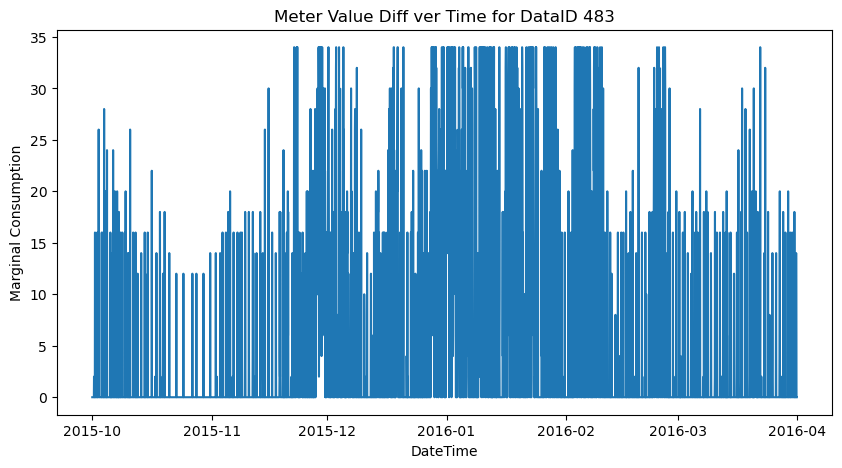

Dataid 484 threshold: 18.0


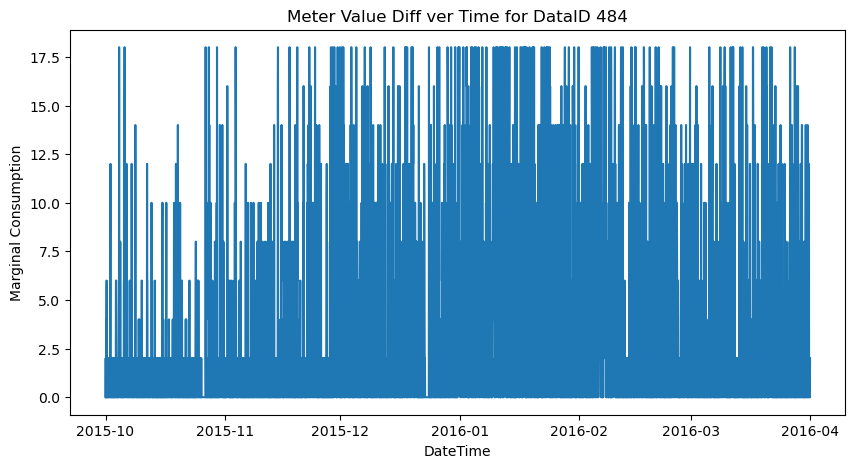

Dataid 661 threshold: 48.0


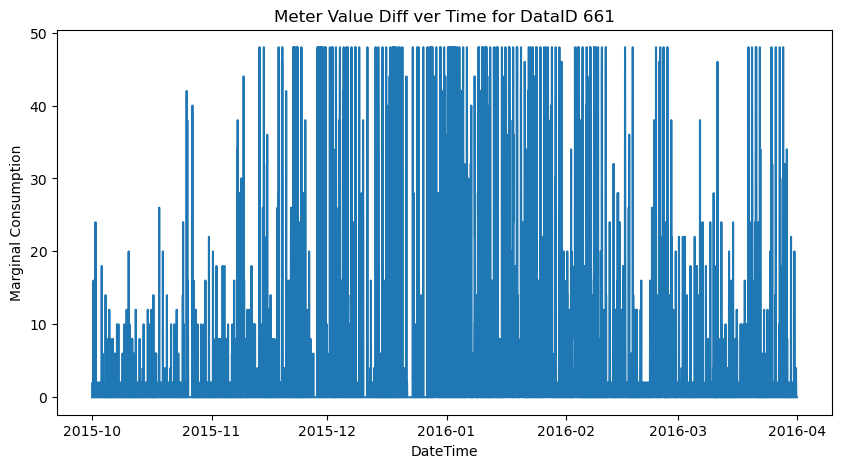

Dataid 739 threshold: 18.0


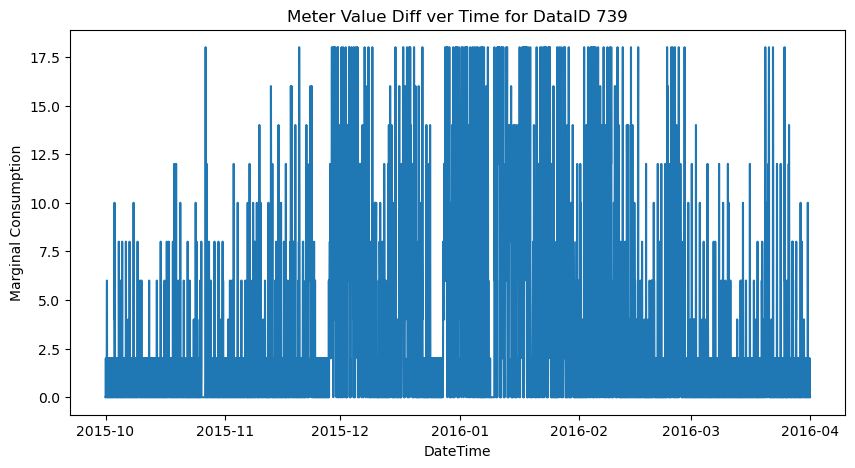

Dataid 744 threshold: 38.0


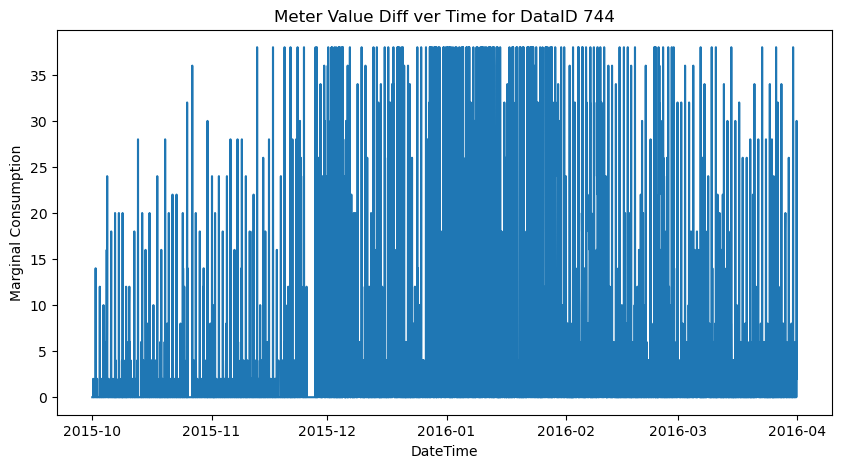

Dataid 871 threshold: 24.0


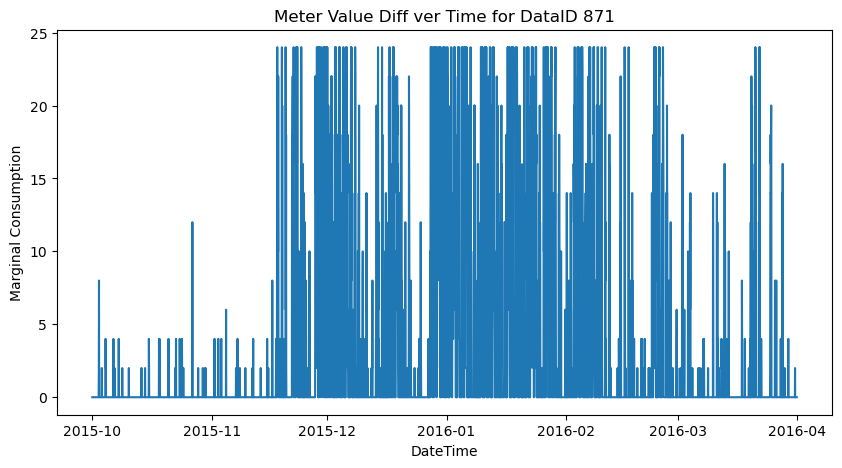

Dataid 1042 threshold: 26.0


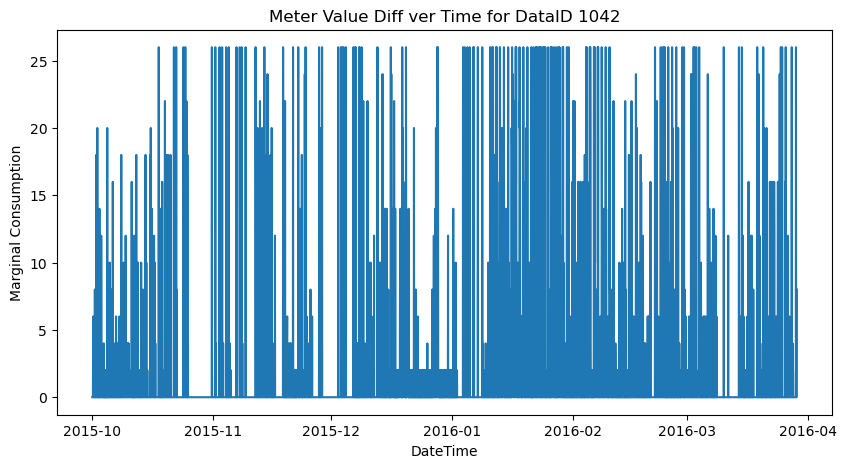

Dataid 1086 threshold: 28.0


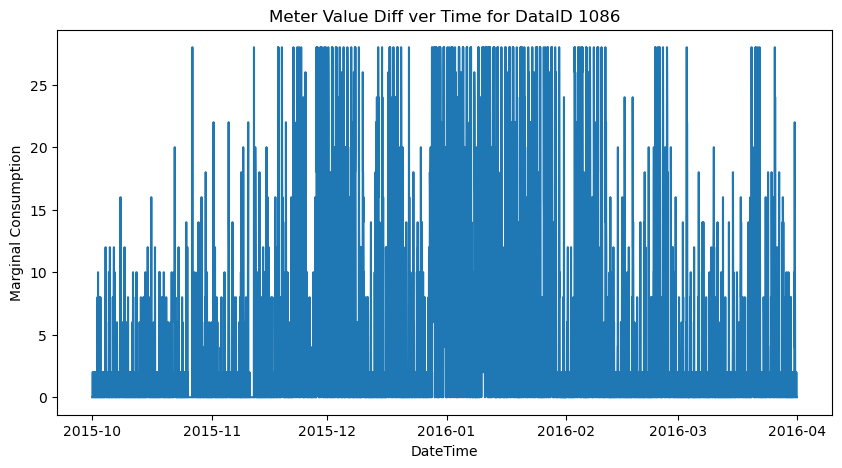

Dataid 1103 threshold: 44.0


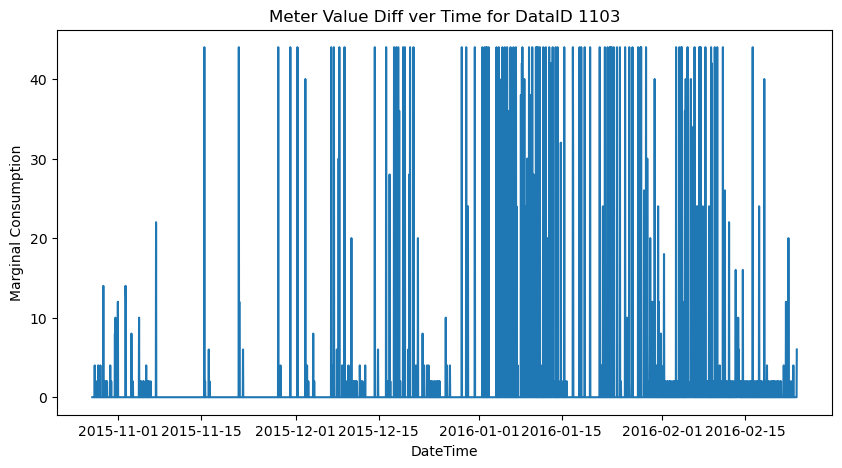

Dataid 1283 threshold: 32.0


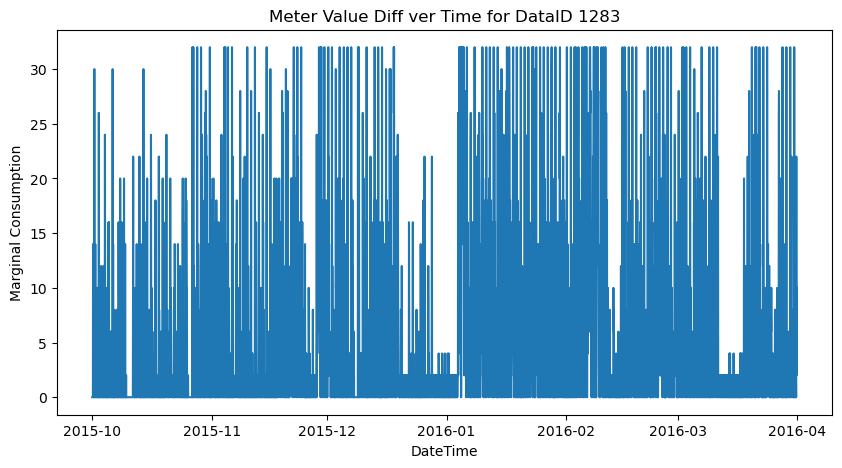

Dataid 1415 threshold: 40.0


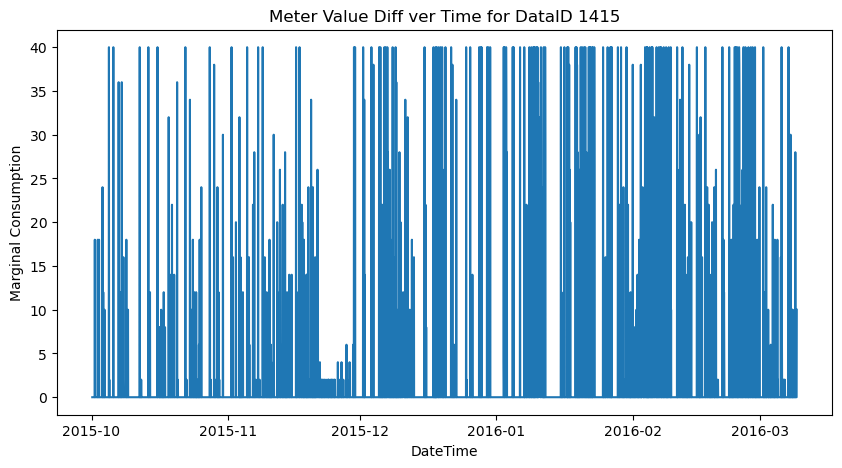

Dataid 1507 threshold: 34.0


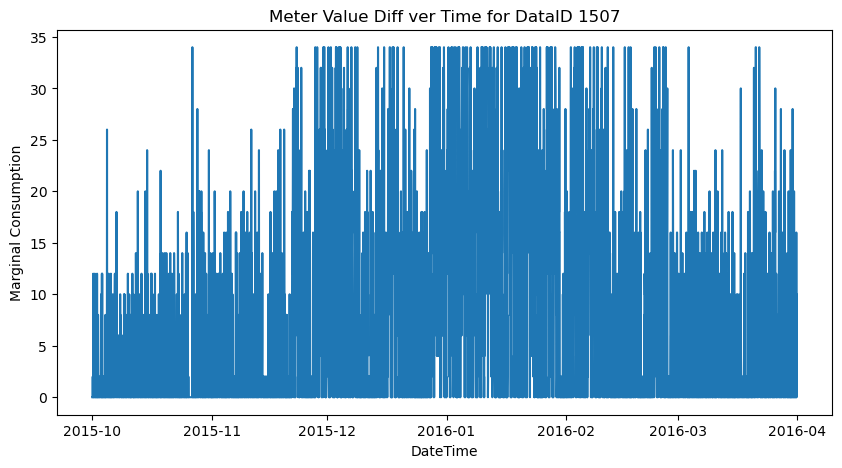

Dataid 1589 threshold: 62.0


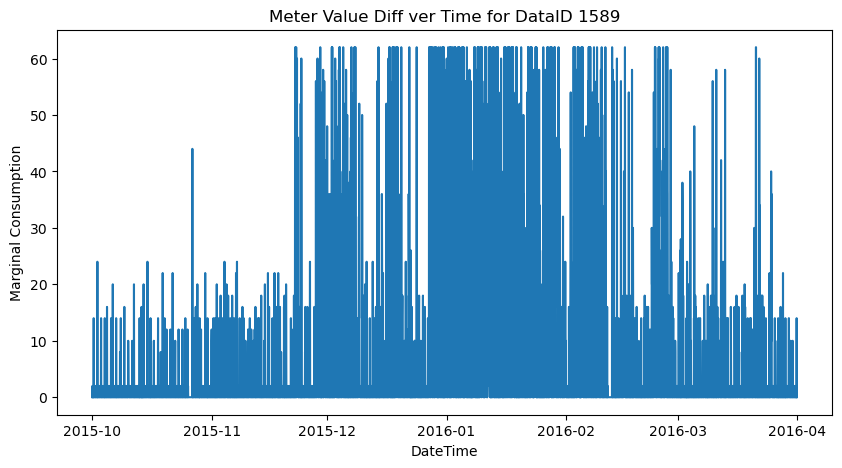

Dataid 1619 threshold: 22.0


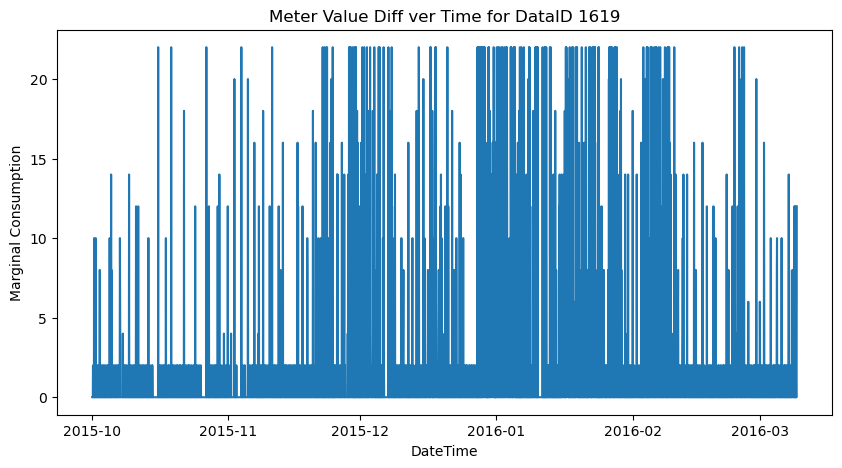

Dataid 1697 threshold: 32.0


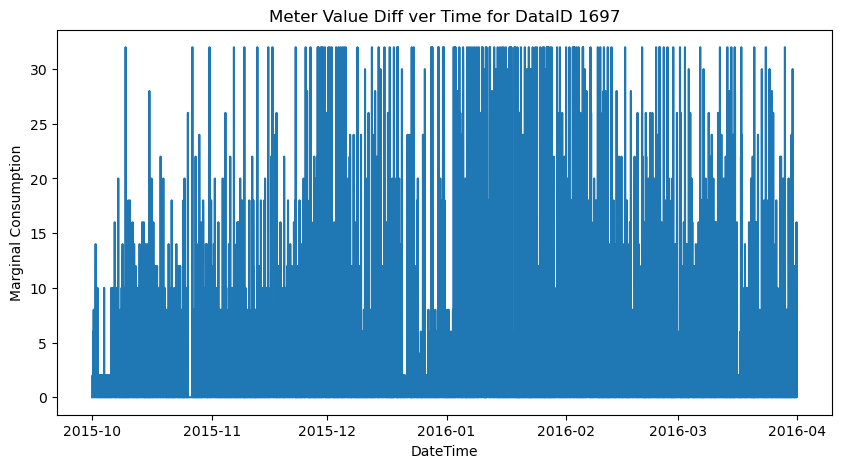

Dataid 1714 threshold: 34.0


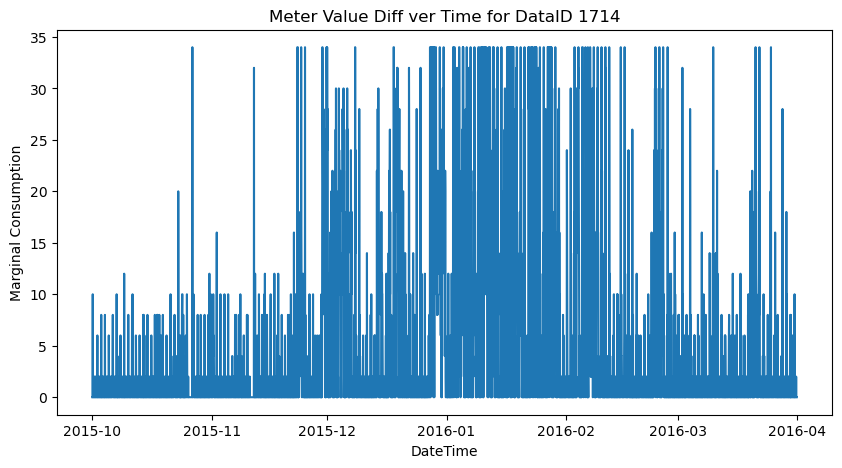

Dataid 1718 threshold: 30.0


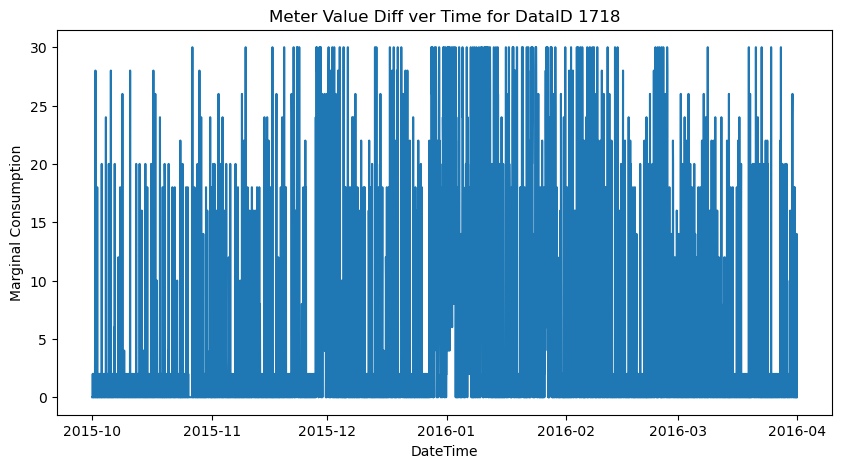

Dataid 1790 threshold: 80.0


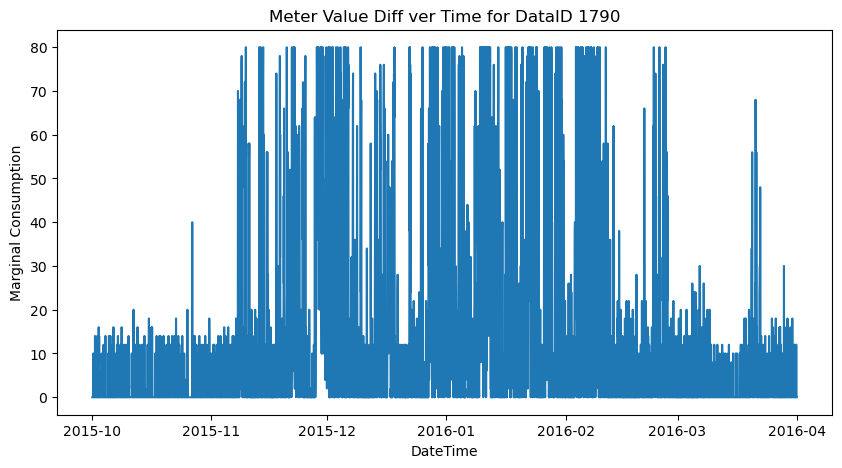

Dataid 1791 threshold: 16.0


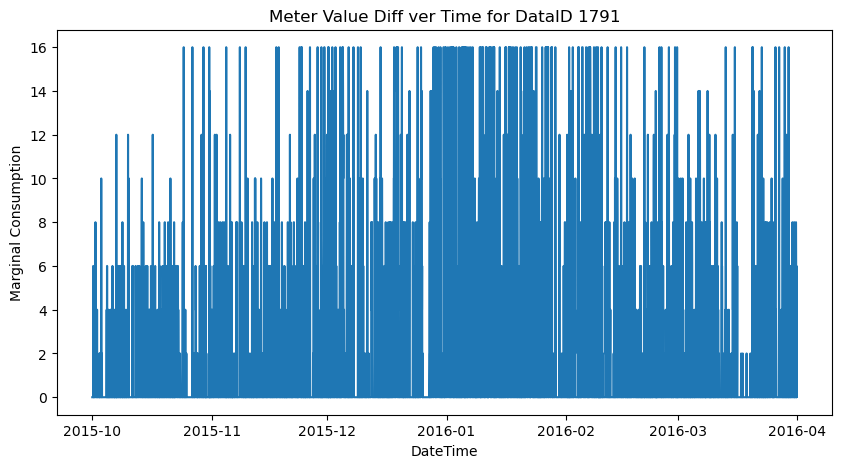

Dataid 1792 threshold: 12.0


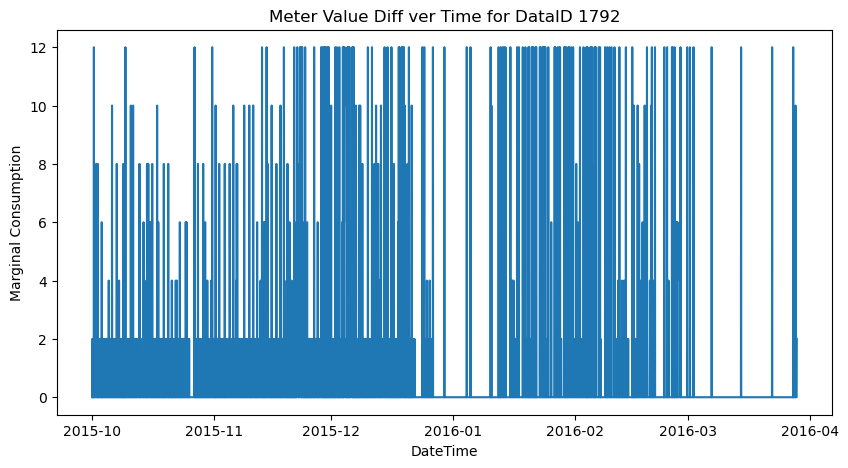

Dataid 1800 threshold: 36.0


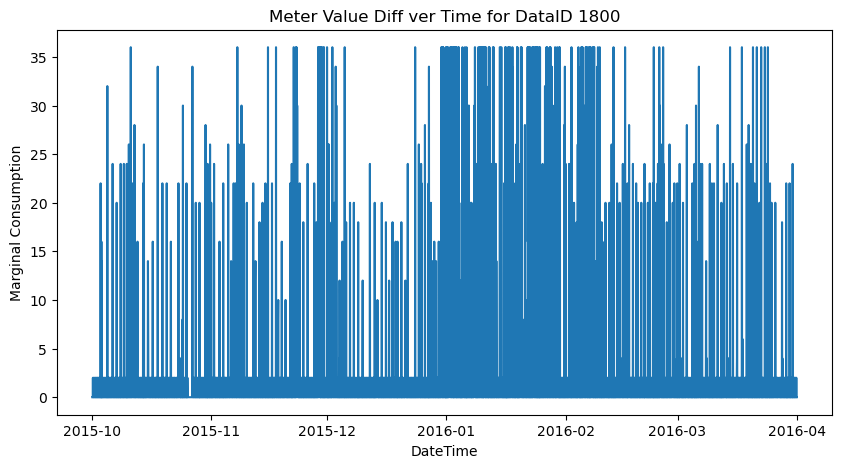

Dataid 1801 threshold: 32.0


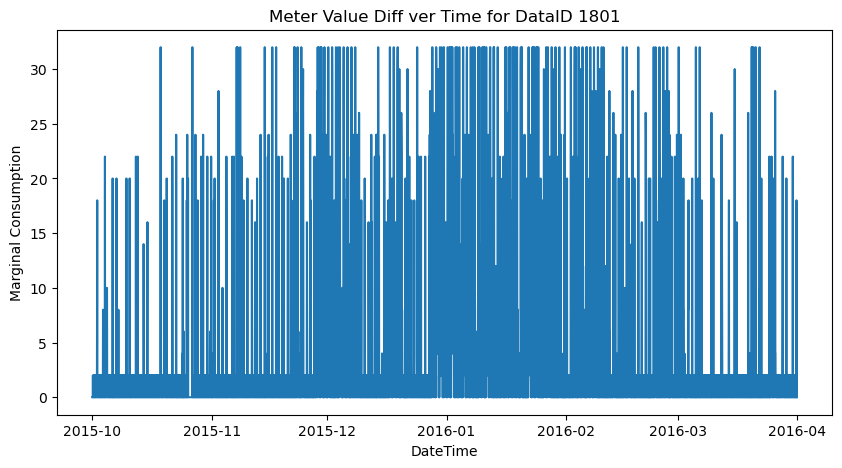

Dataid 2018 threshold: 54.0


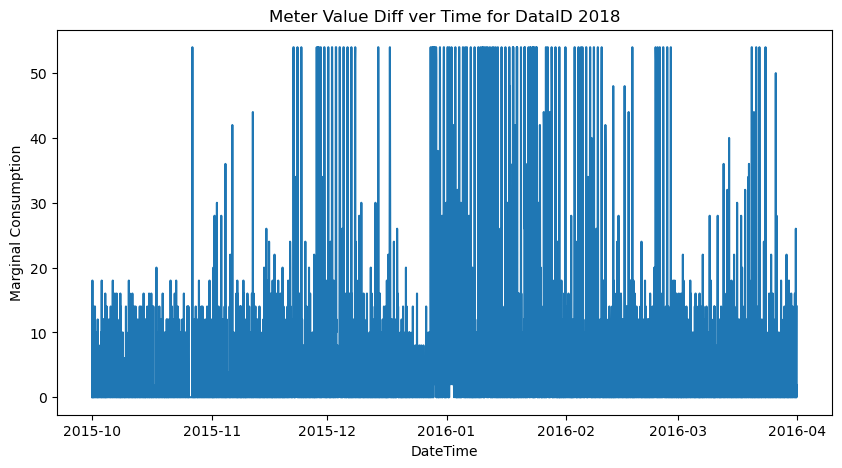

Dataid 2034 threshold: 18.0


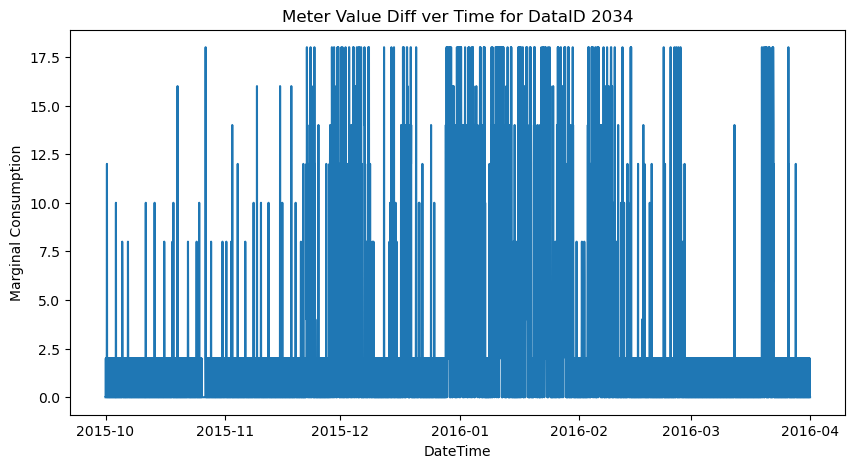

Dataid 2072 threshold: 34.0


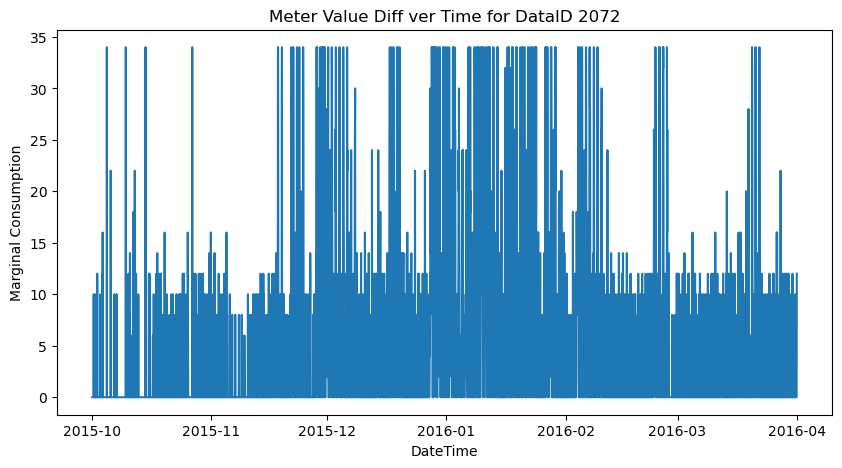

Dataid 2094 threshold: 24.0


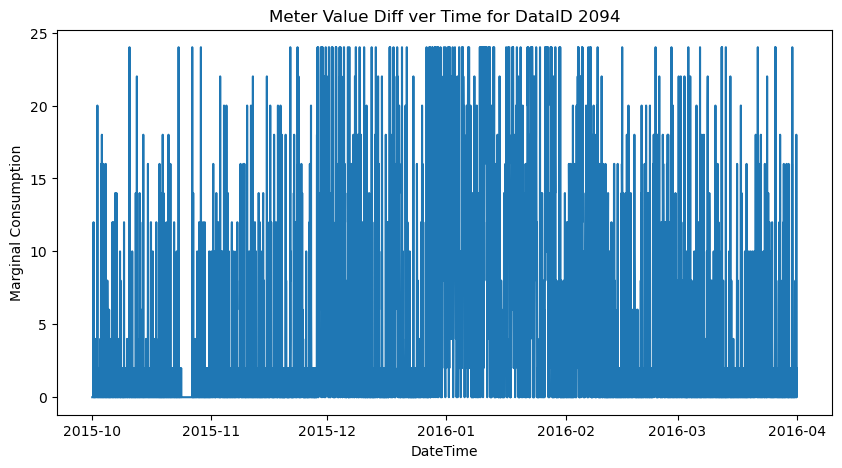

Dataid 2129 threshold: 34.0


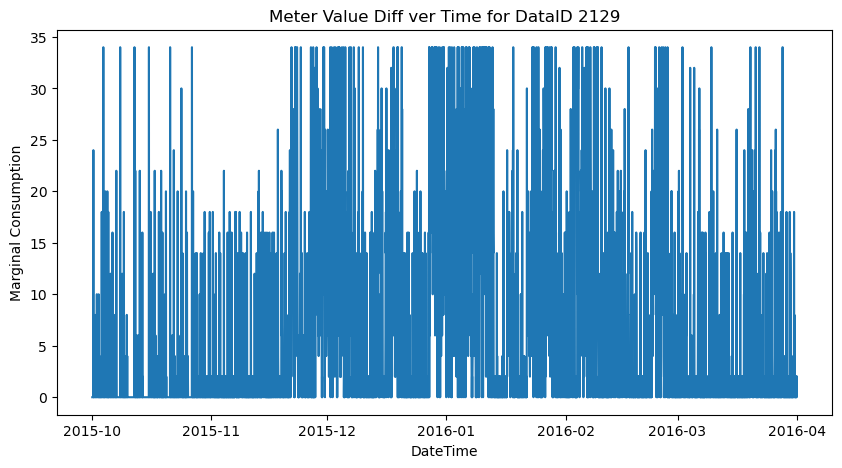

Dataid 2233 threshold: 30.0


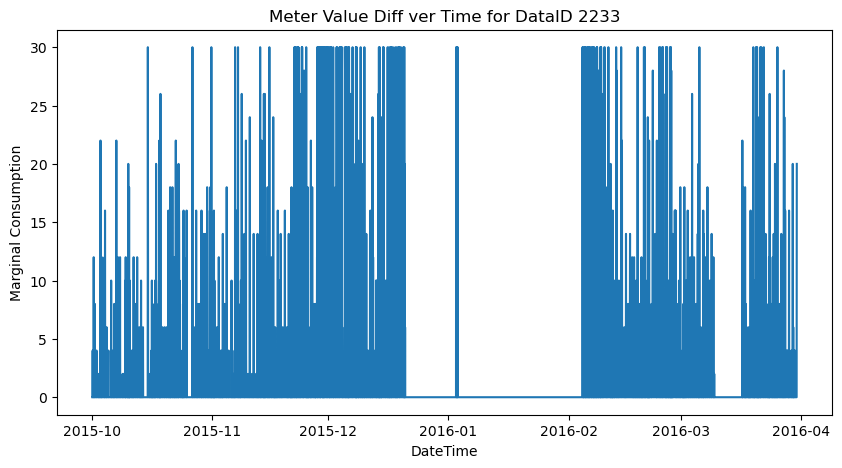

Dataid 2378 threshold: 78.0


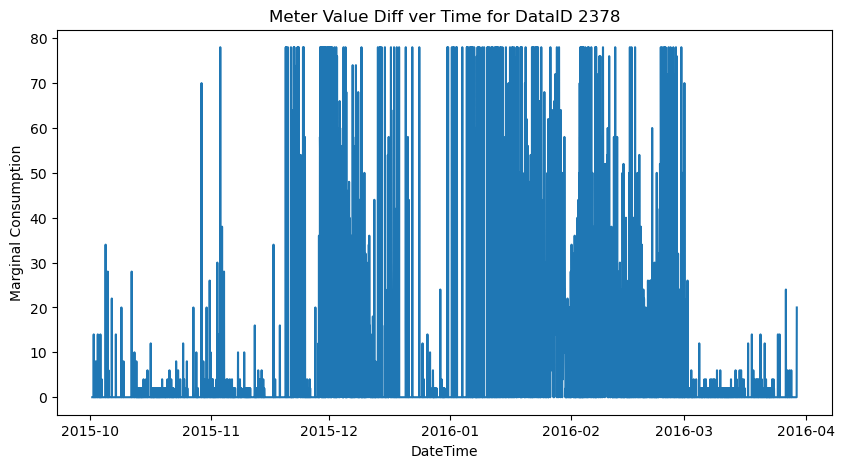

Dataid 2461 threshold: 30.0


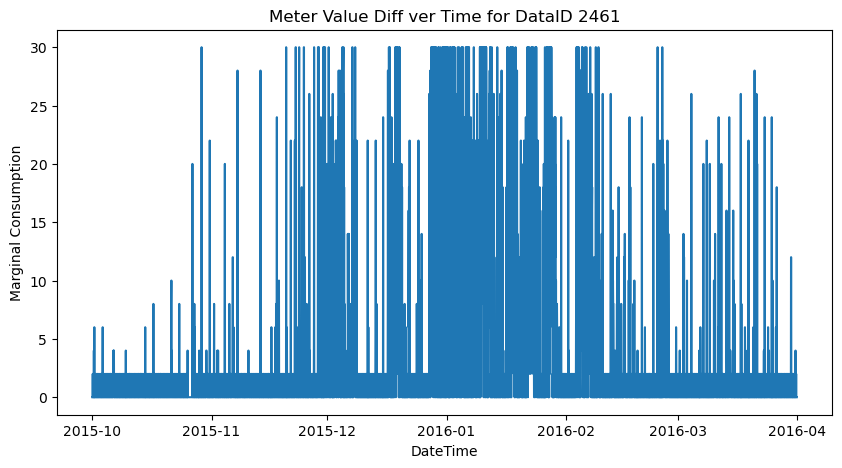

Dataid 2470 threshold: 38.0


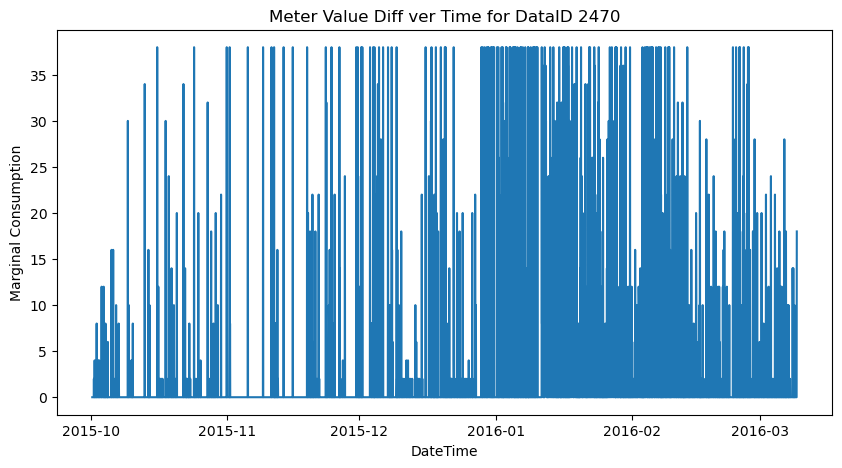

Dataid 2575 threshold: 54.0


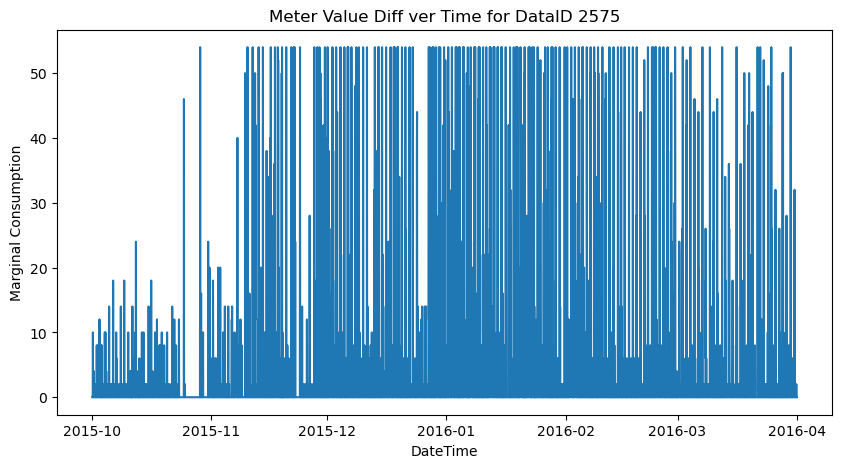

Dataid 2638 threshold: 22.0


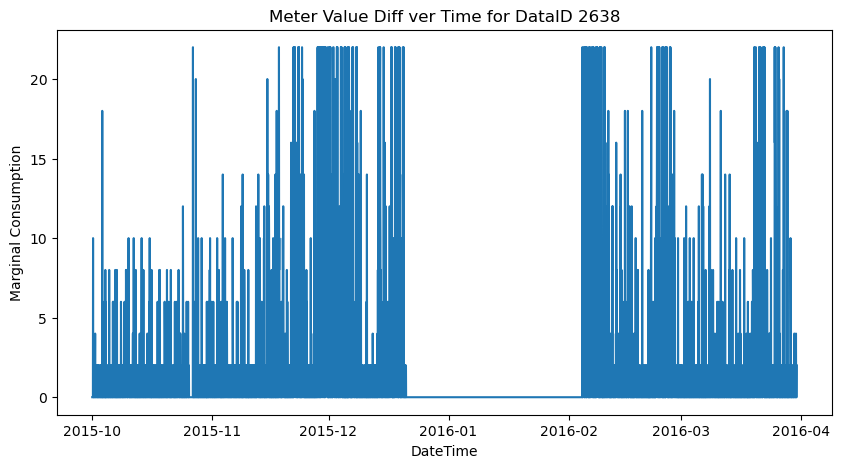

Dataid 2818 threshold: 42.0


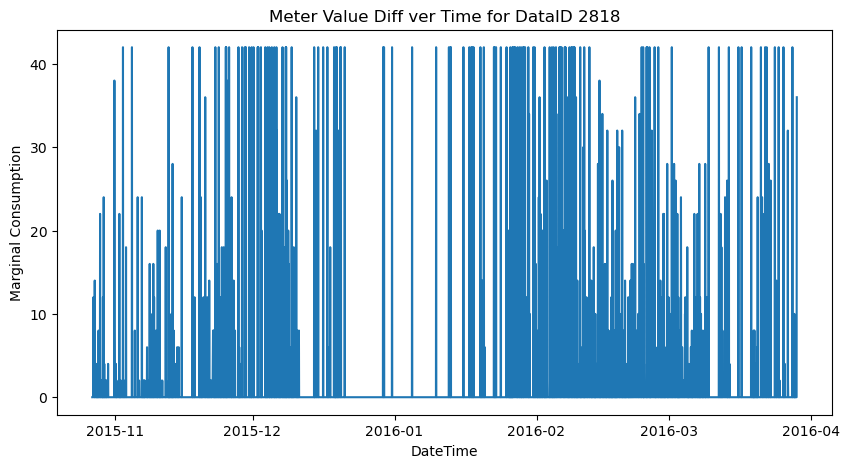

Dataid 2945 threshold: 24.0


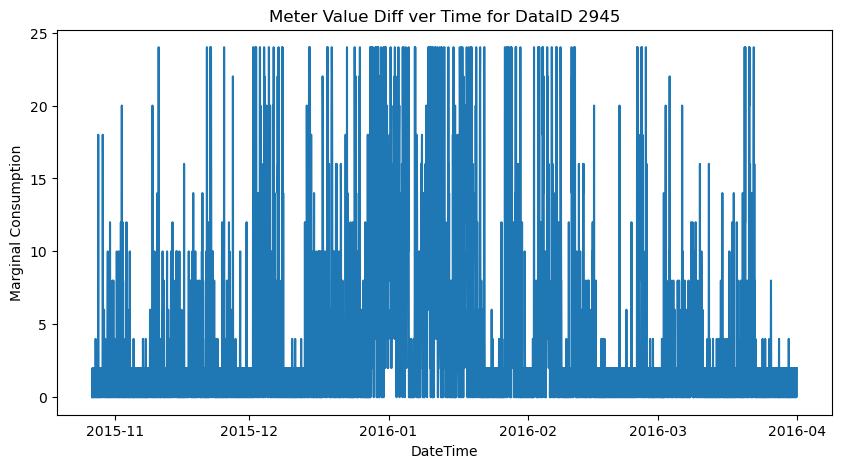

Dataid 2965 threshold: 24.0


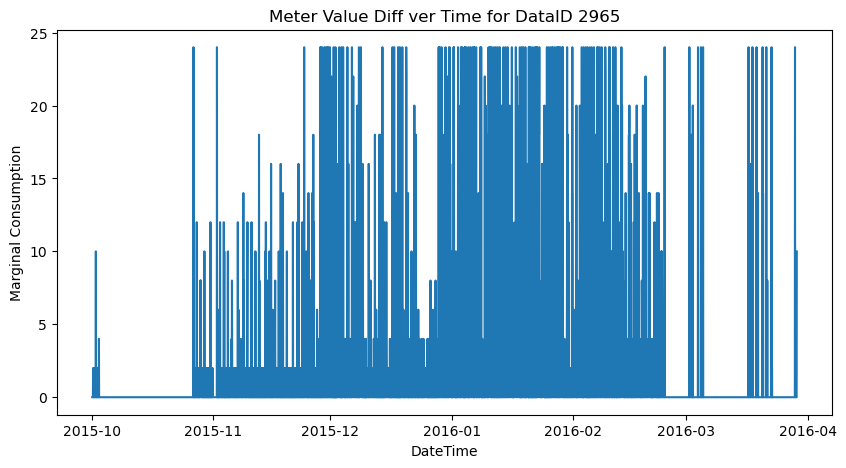

Dataid 2980 threshold: 20.0


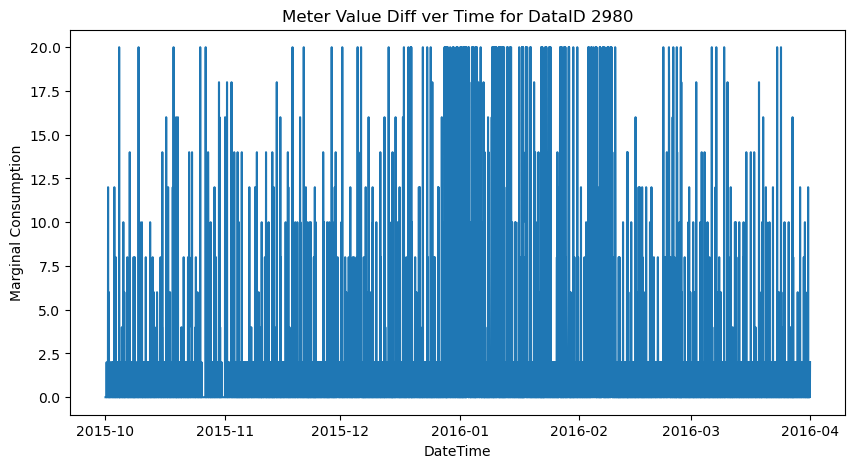

Dataid 3036 threshold: 60.0


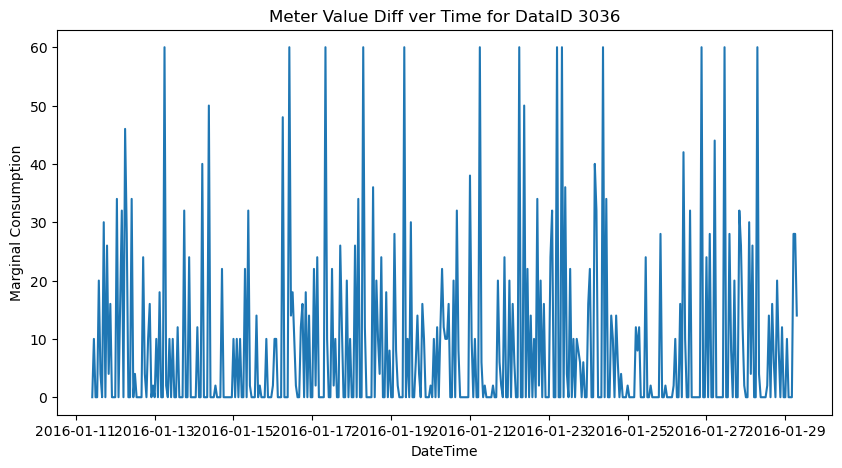

Dataid 3039 threshold: 18.0


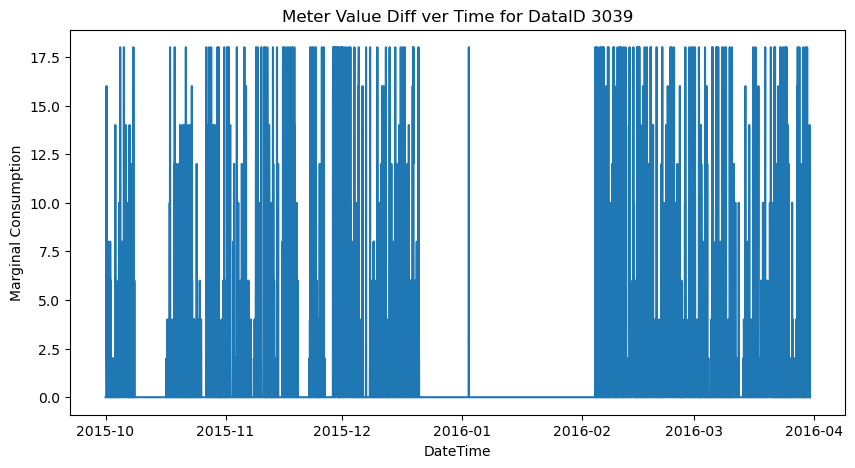

Dataid 3310 threshold: 32.0


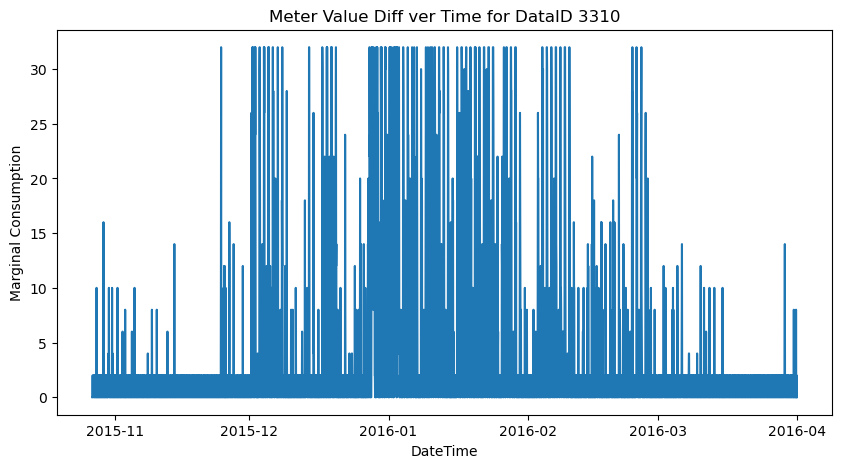

Dataid 3367 threshold: 32.0


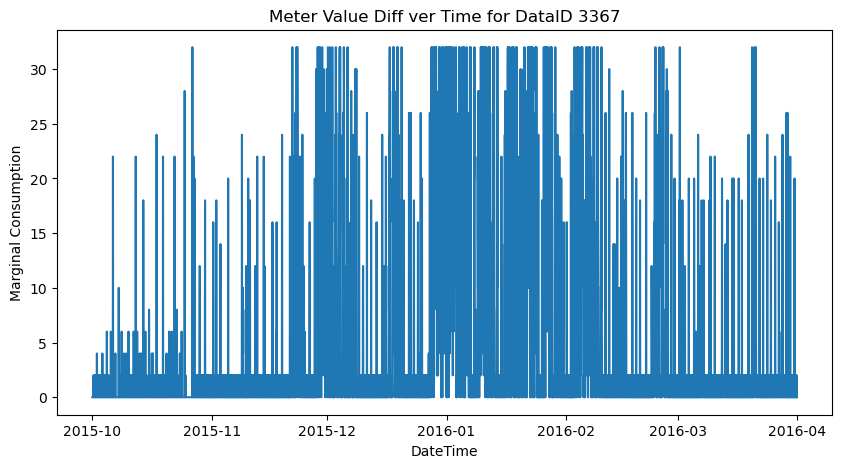

Dataid 3527 threshold: 30.0


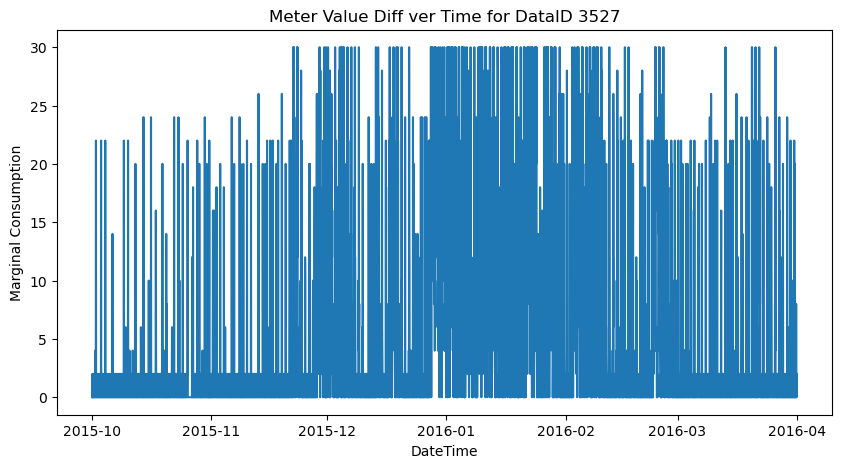

Dataid 3577 threshold: 48.0


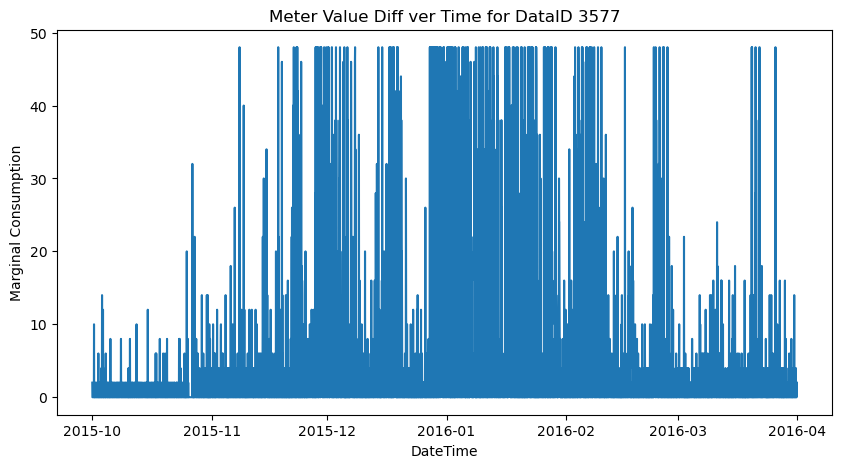

Dataid 3635 threshold: 28.0


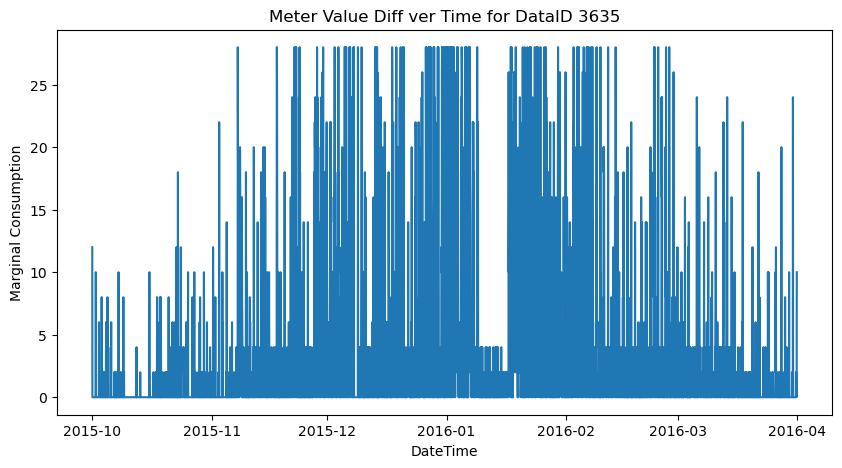

Dataid 3723 threshold: 36.0


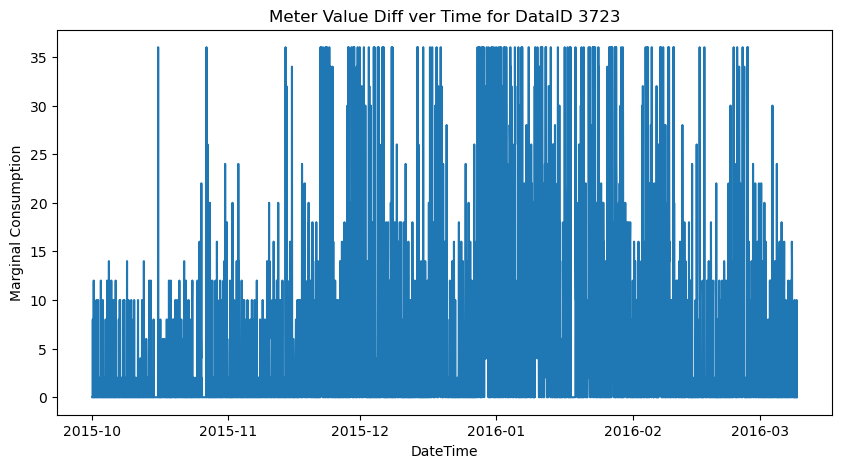

Dataid 3778 threshold: 20.0


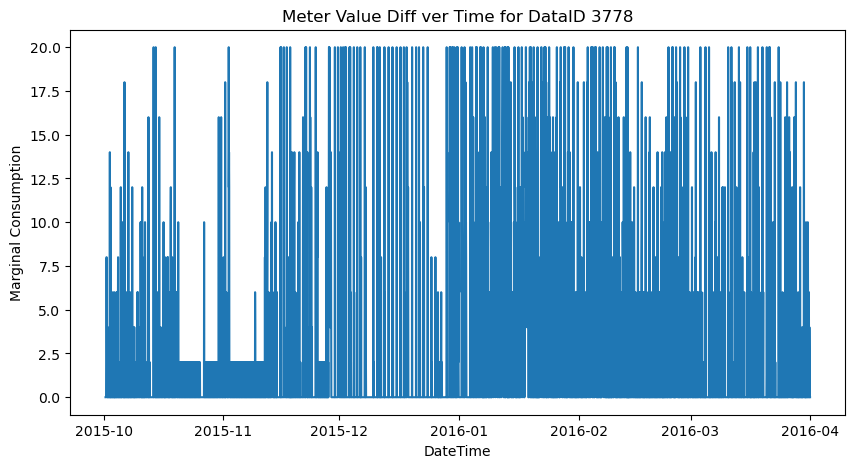

Dataid 3849 threshold: 34.0


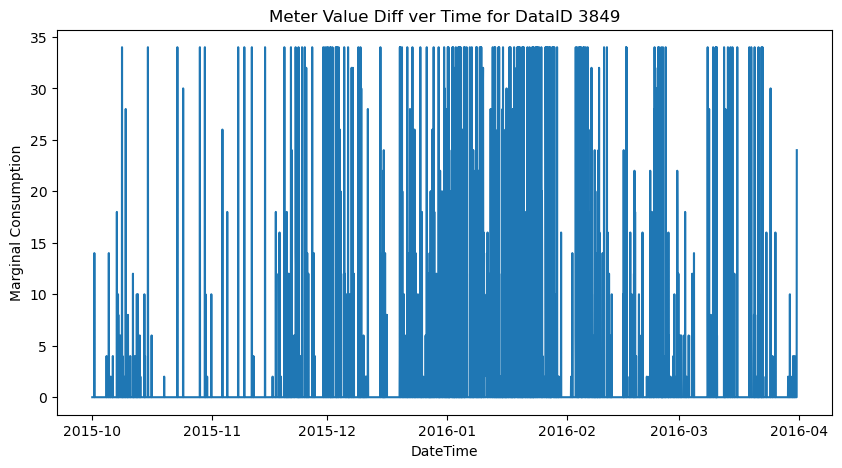

Dataid 3893 threshold: 28.0


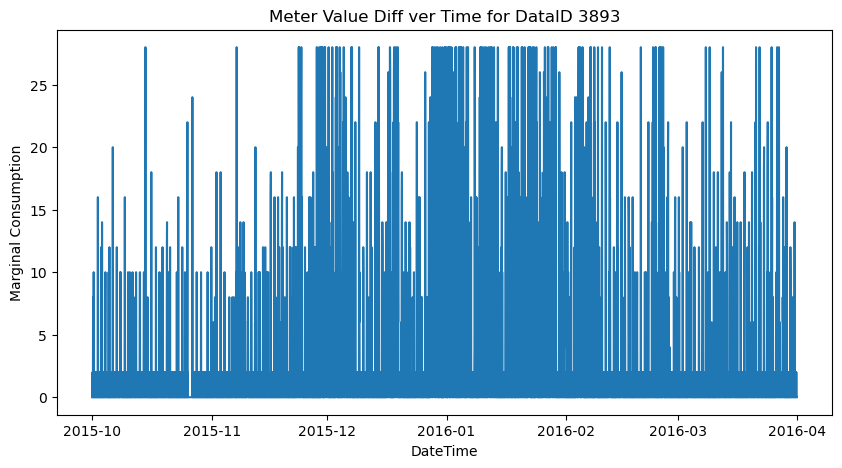

Dataid 3918 threshold: 50.0


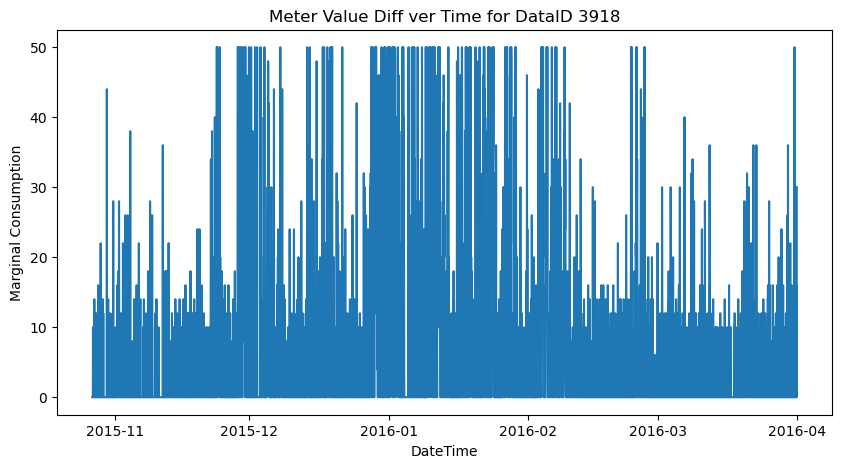

Dataid 4029 threshold: 28.0


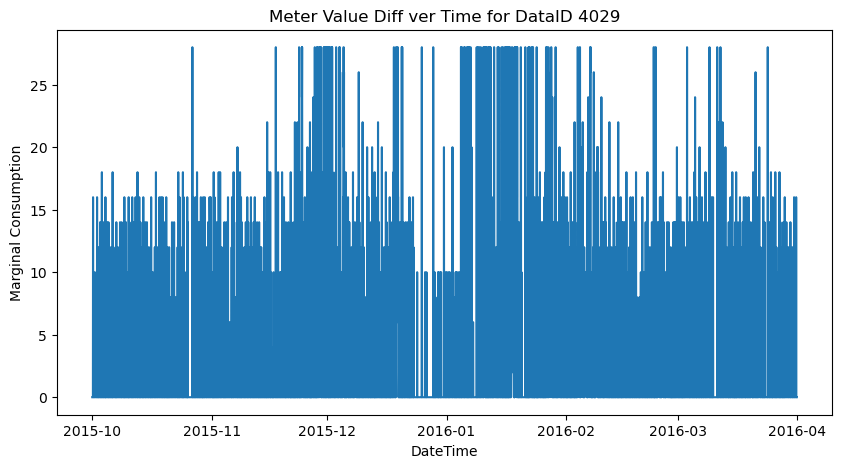

Dataid 4031 threshold: 26.0


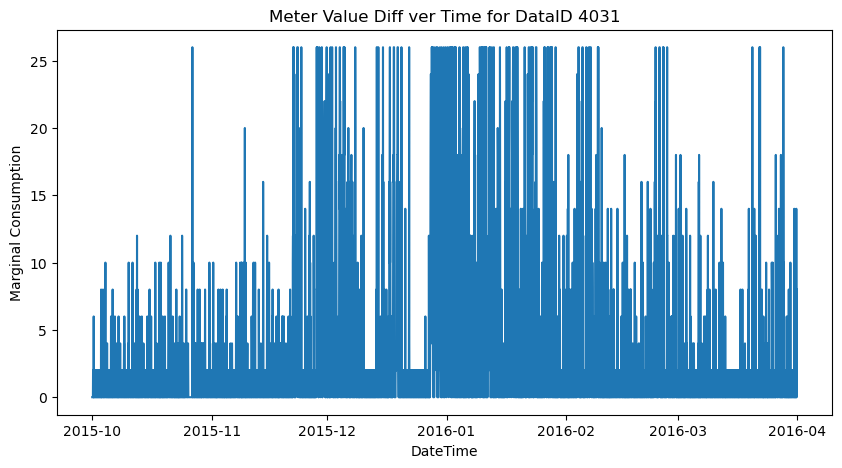

Dataid 4193 threshold: 50.0


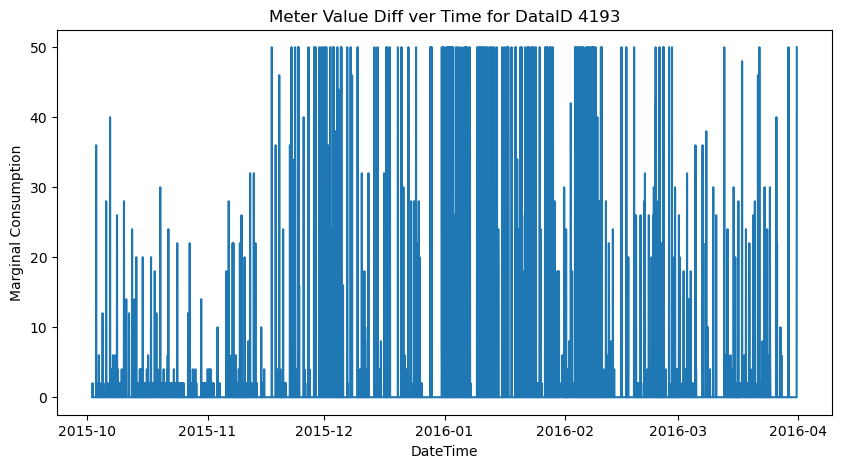

Dataid 4228 threshold: 22.0


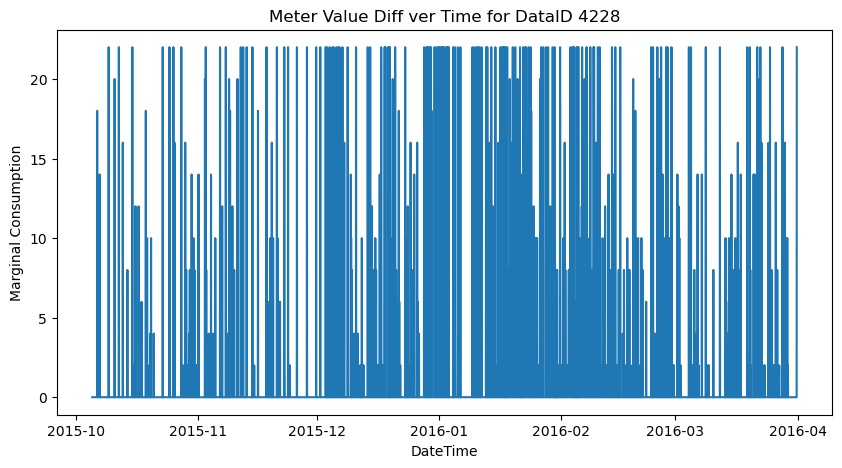

Dataid 4296 threshold: 34.0


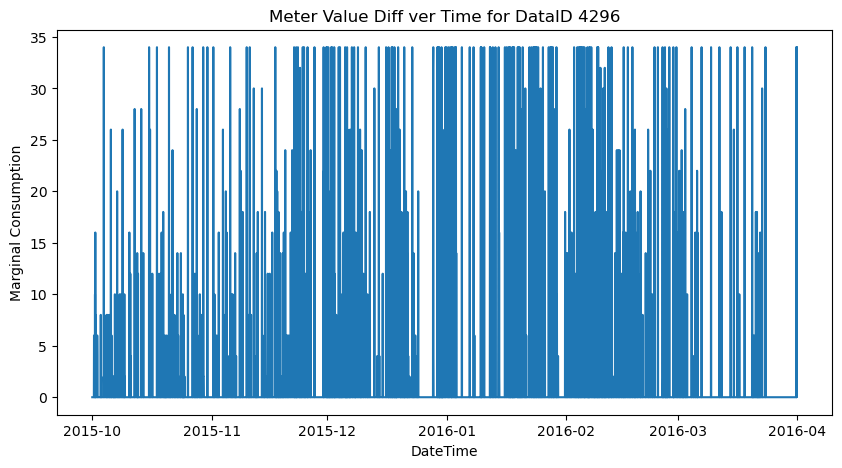

Dataid 4352 threshold: 18.0


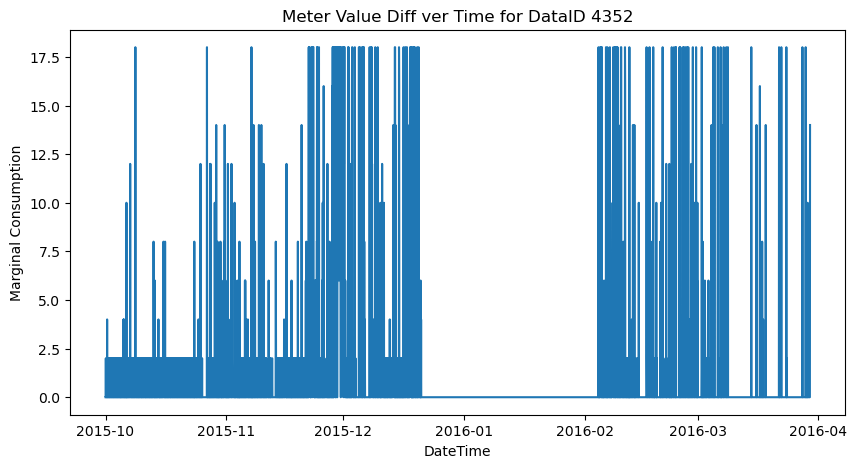

Dataid 4356 threshold: 46.0


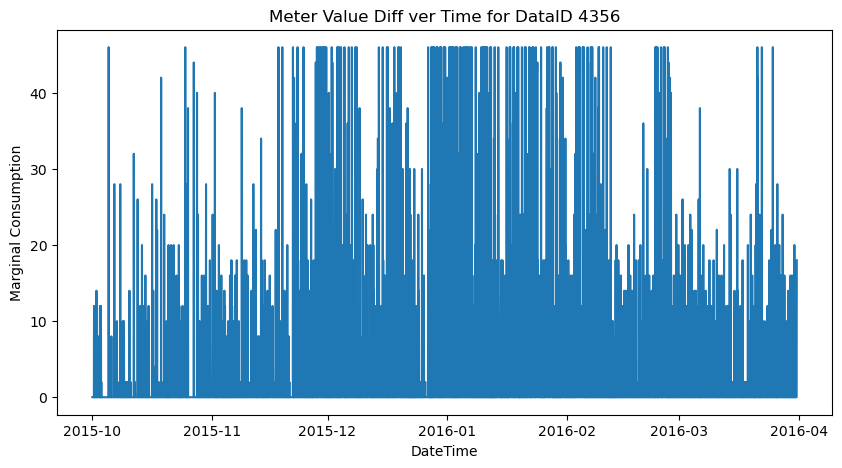

Dataid 4373 threshold: 48.0


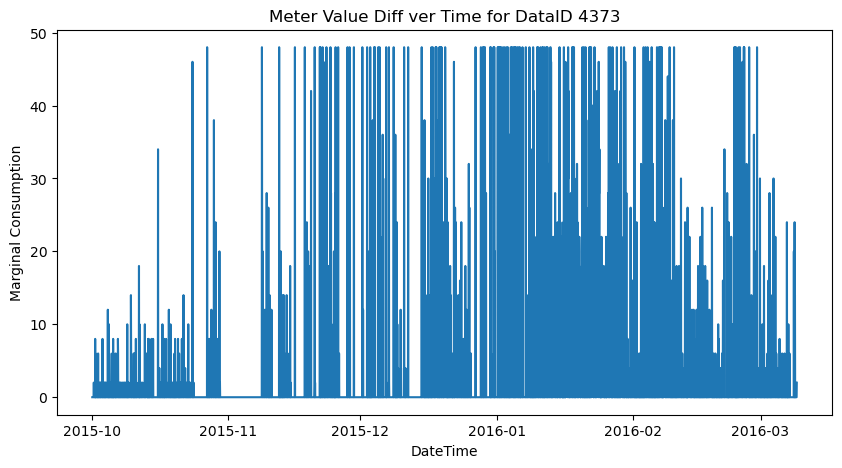

Dataid 4421 threshold: 14.0


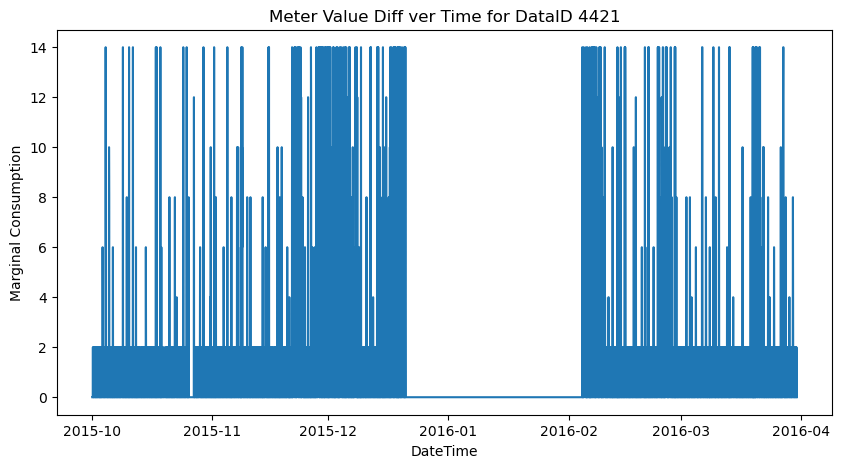

Dataid 4447 threshold: 14.0


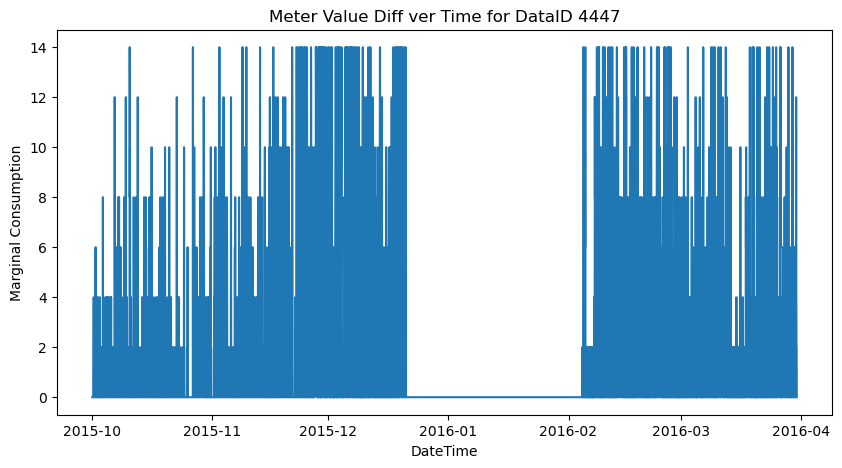

Dataid 4732 threshold: 32.0


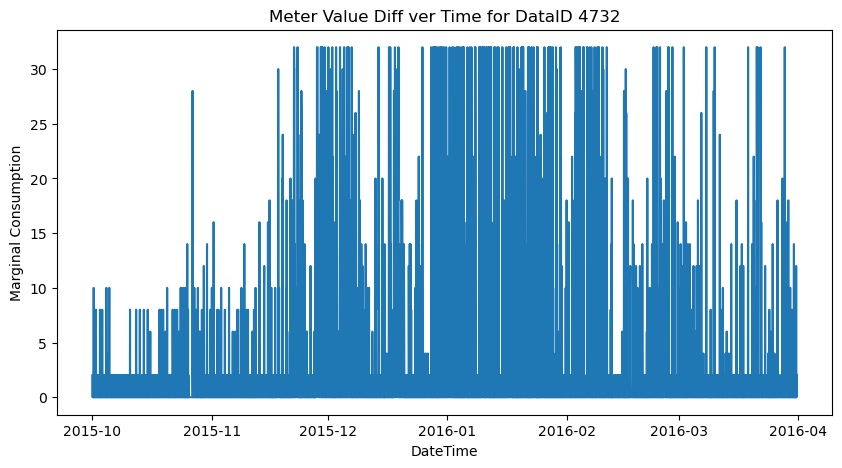

Dataid 4767 threshold: 50.0


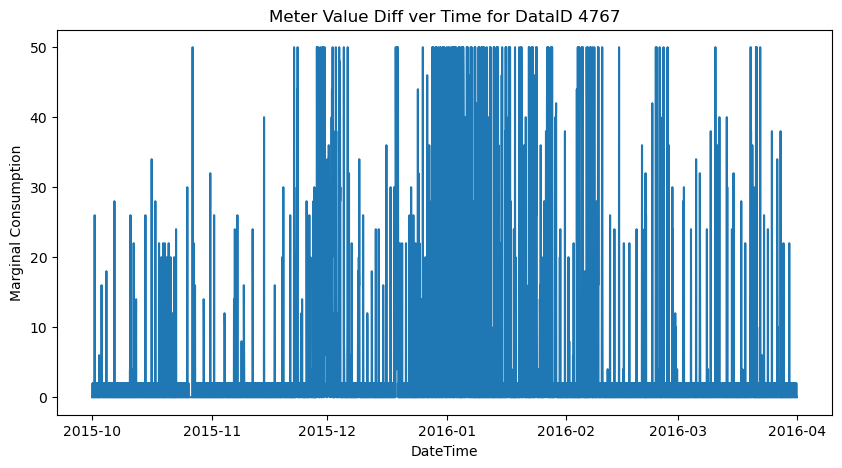

Dataid 4998 threshold: 38.0


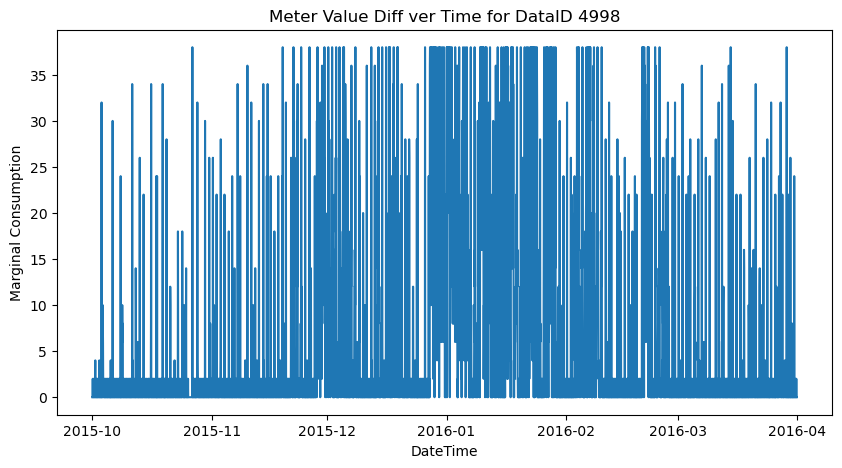

Dataid 5131 threshold: 22.0


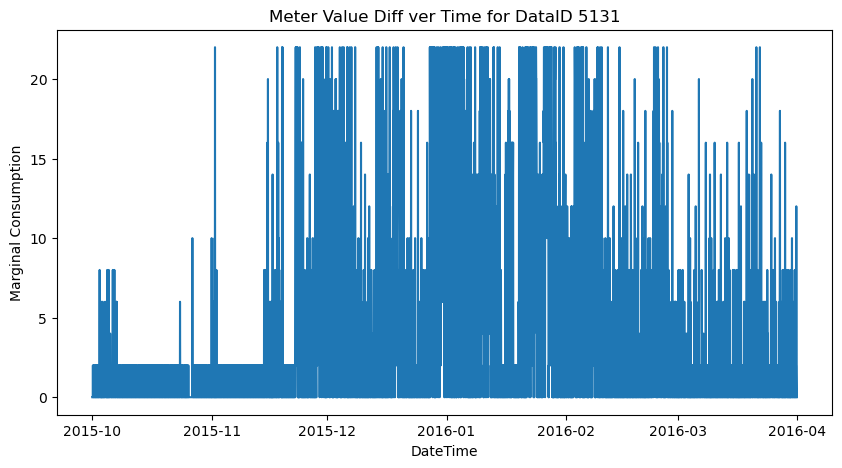

Dataid 5193 threshold: 28.0


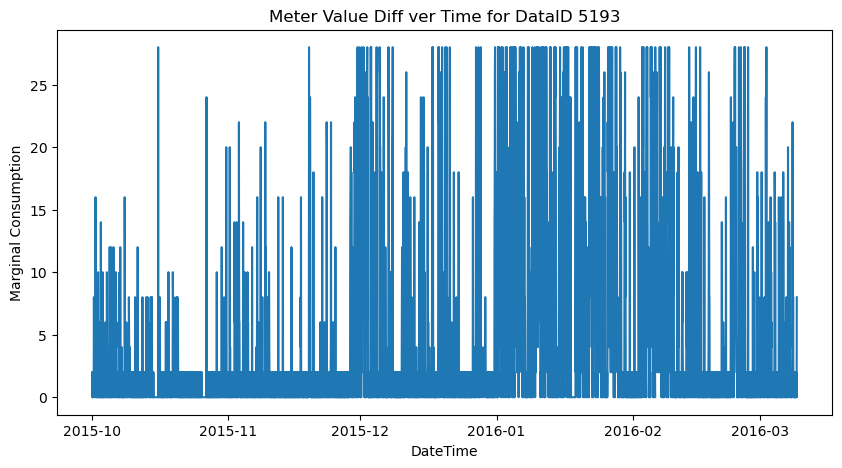

Dataid 5275 threshold: 42.0


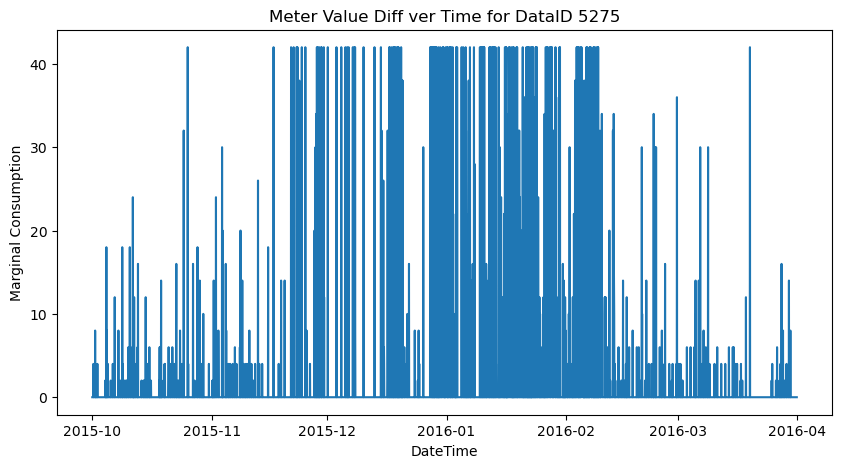

Dataid 5317 threshold: 8.0


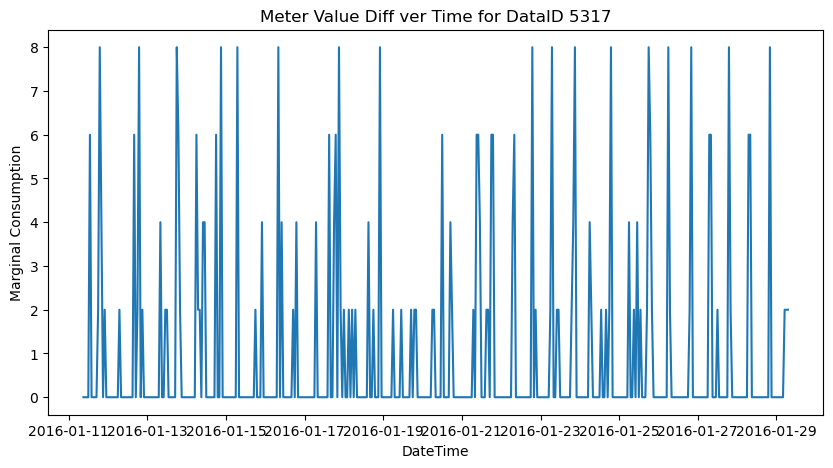

Dataid 5395 threshold: 40.0


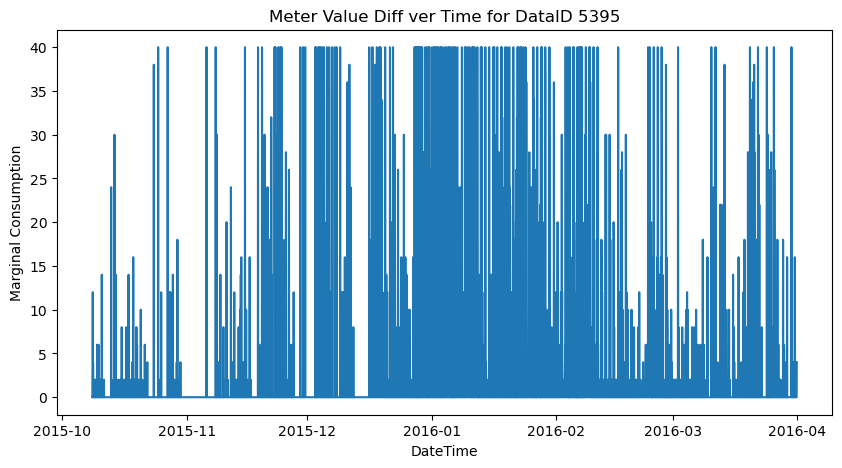

Dataid 5439 threshold: 26.0


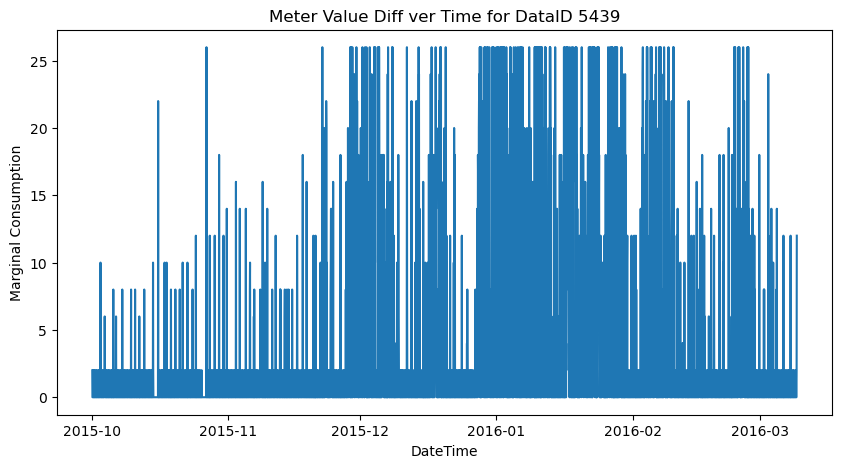

Dataid 5484 threshold: 42.0


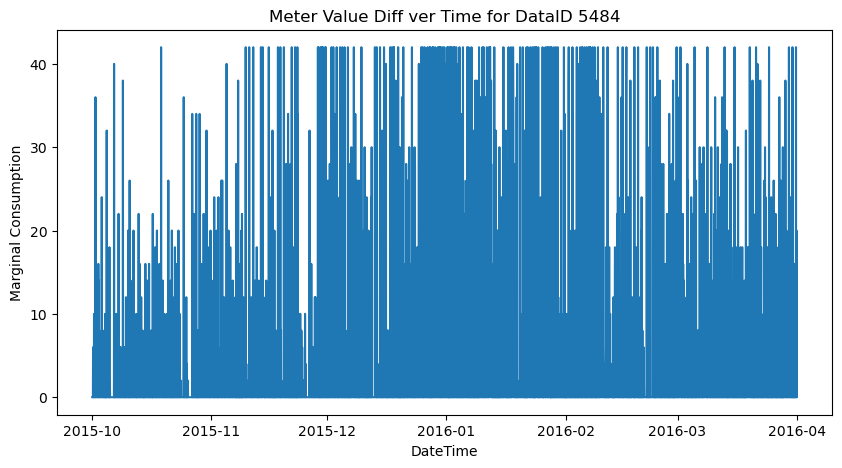

Dataid 5636 threshold: 32.0


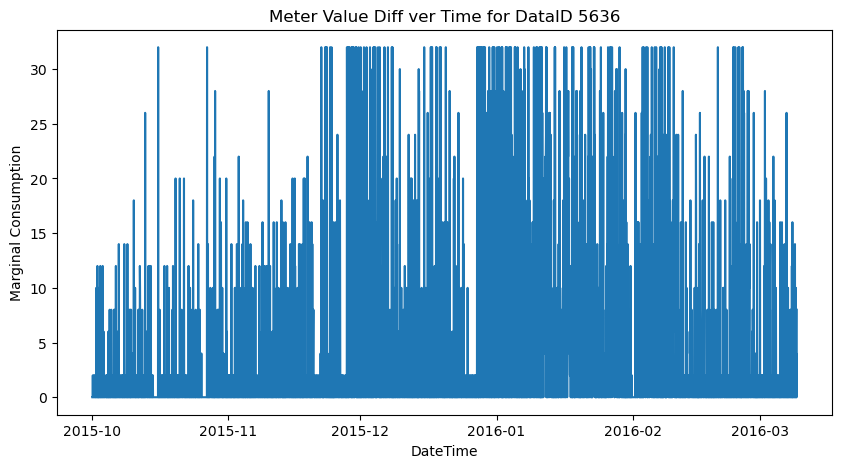

Dataid 5658 threshold: 14.0


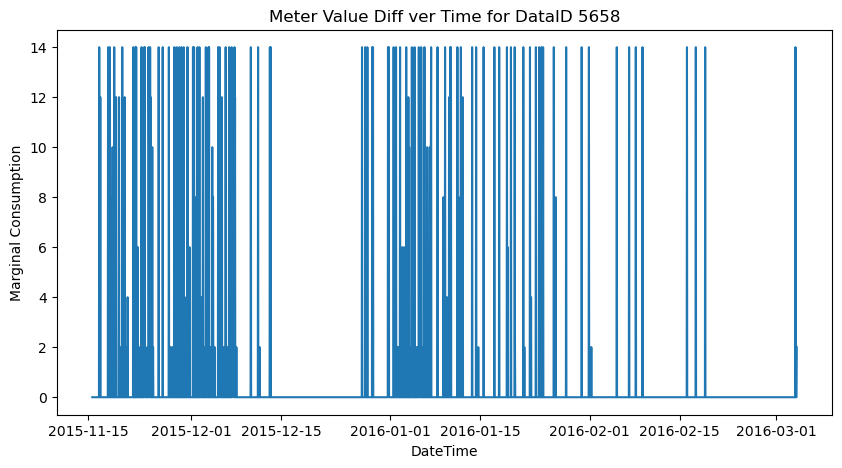

Dataid 5785 threshold: 50.0


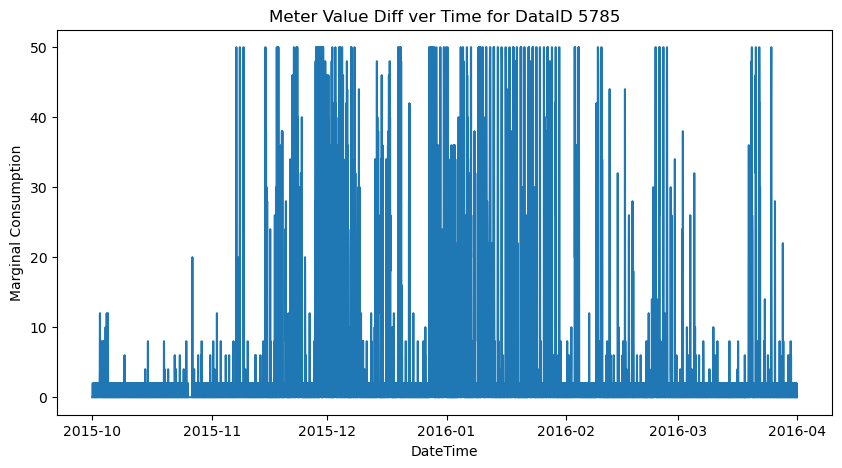

Dataid 5810 threshold: 26.0


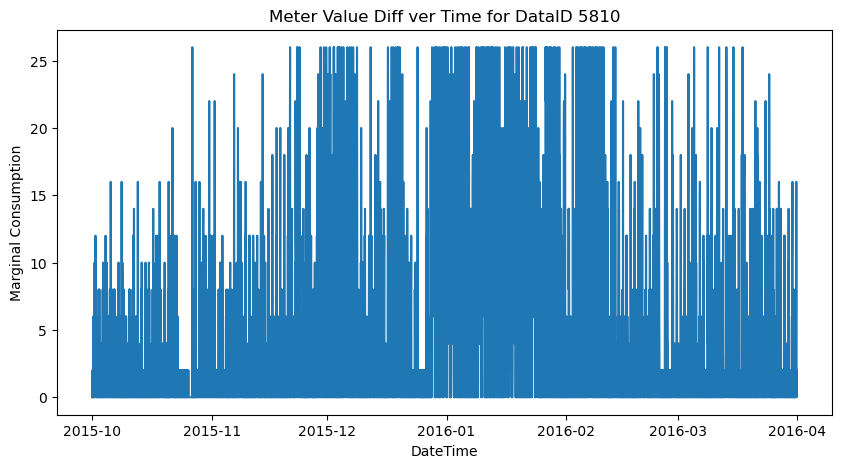

Dataid 5814 threshold: 18.0


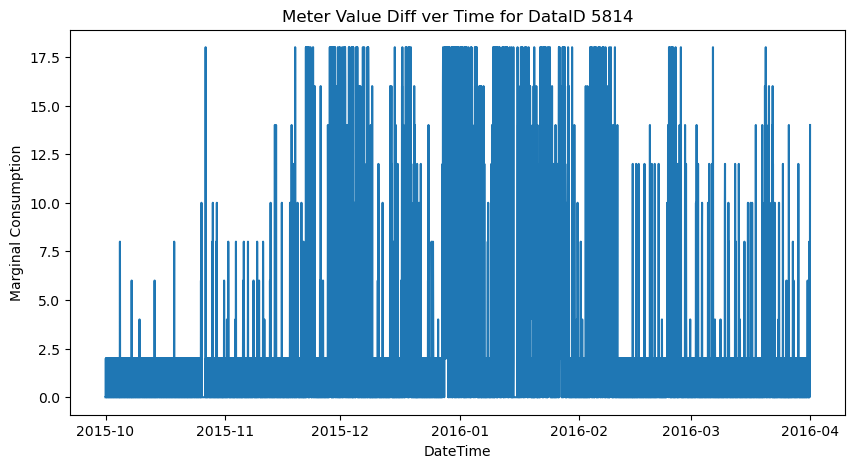

Dataid 5892 threshold: 28.0


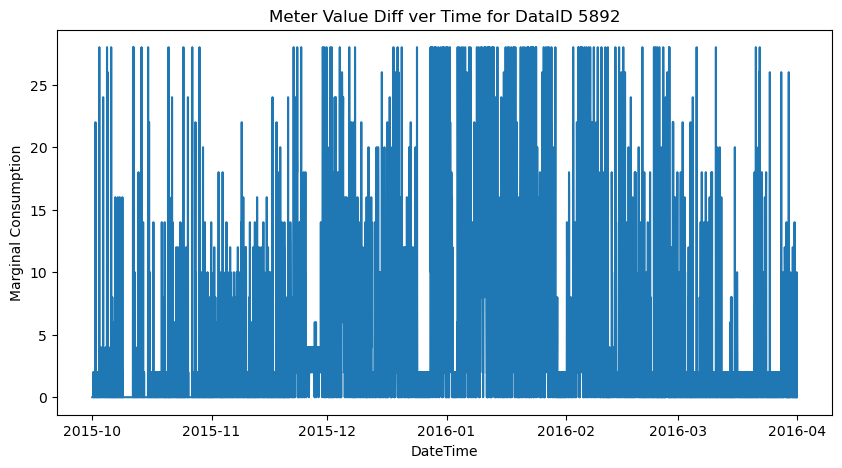

Dataid 5972 threshold: 58.0


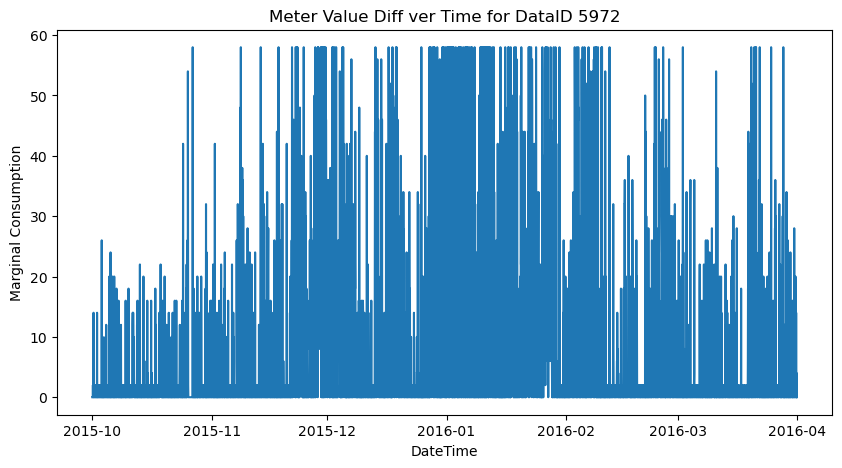

Dataid 6412 threshold: 32.0


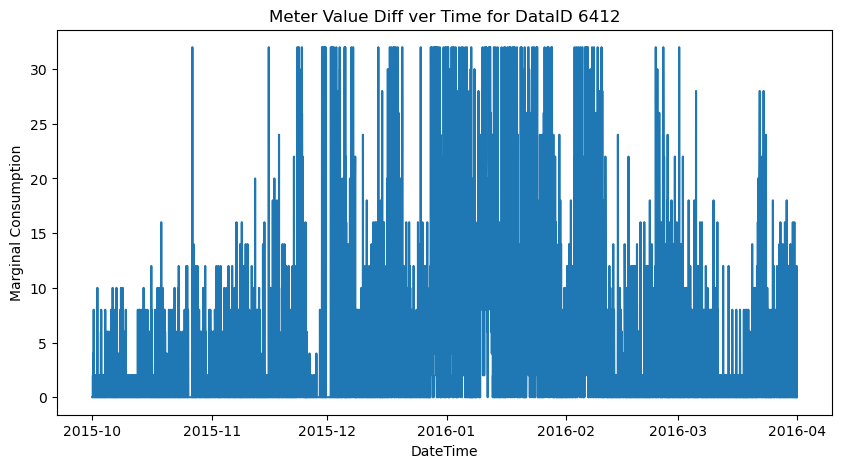

Dataid 6505 threshold: 28.0


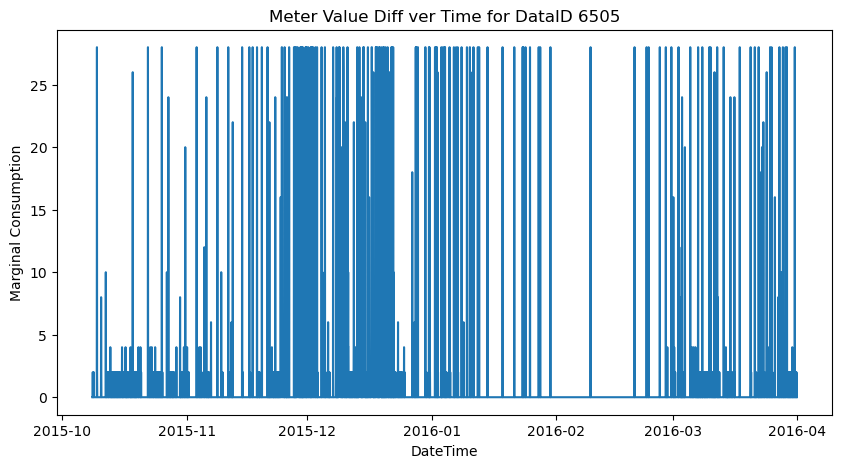

Dataid 6578 threshold: 18.0


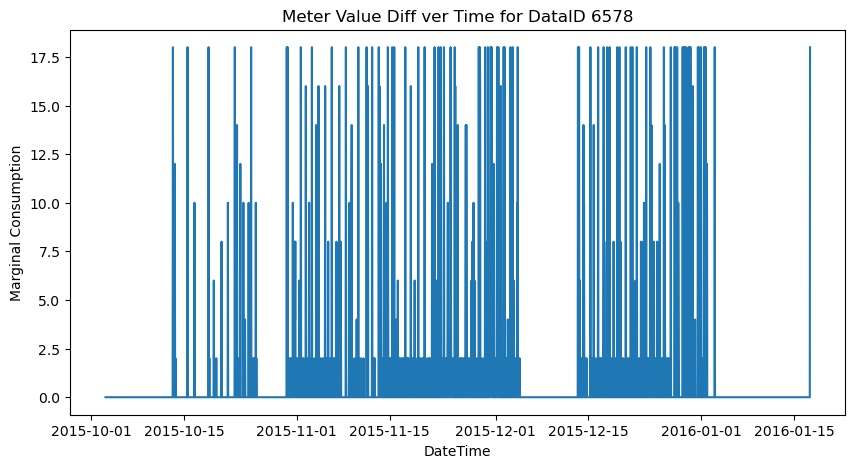

Dataid 6673 threshold: 16.0


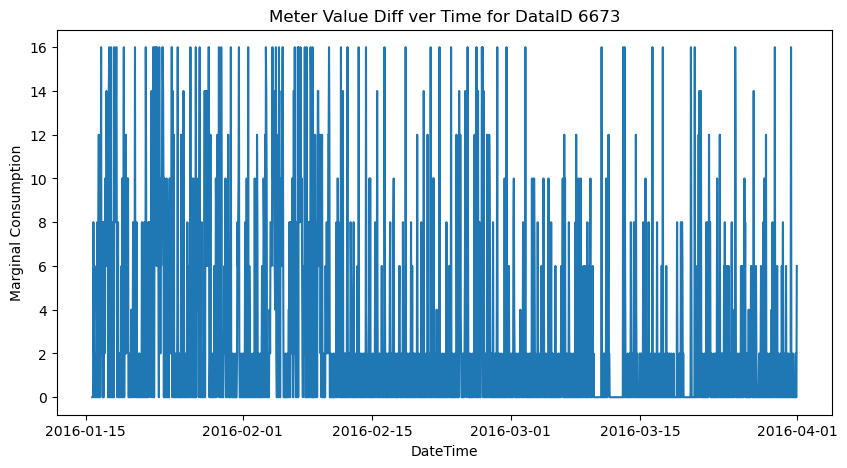

Dataid 6830 threshold: 30.0


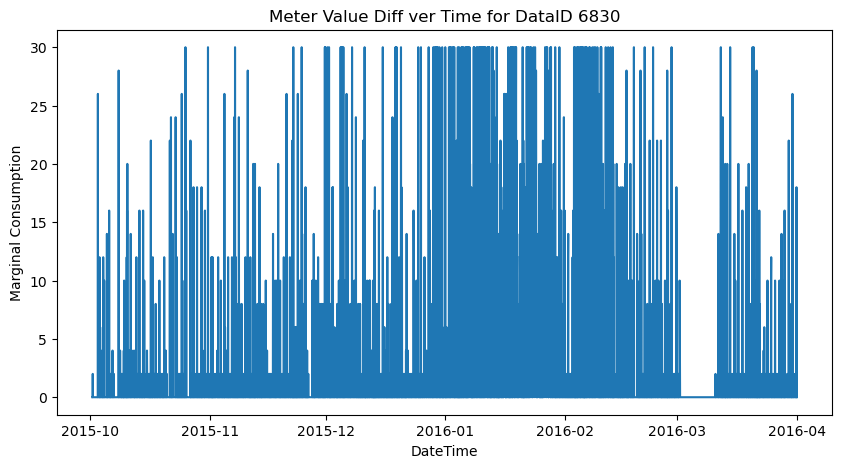

Dataid 6863 threshold: 4.0


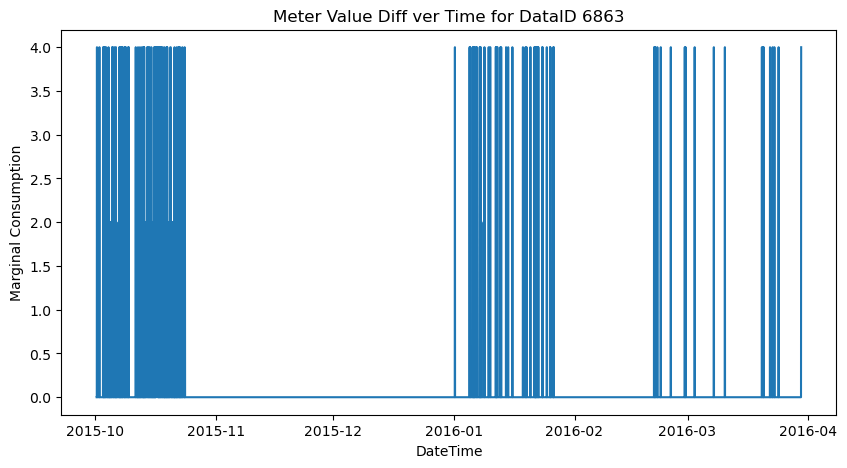

Dataid 6910 threshold: 28.0


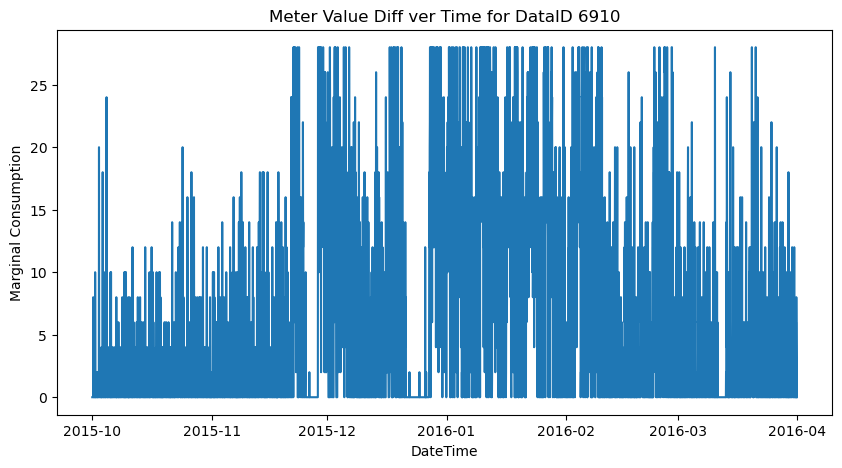

Dataid 7016 threshold: 60.0


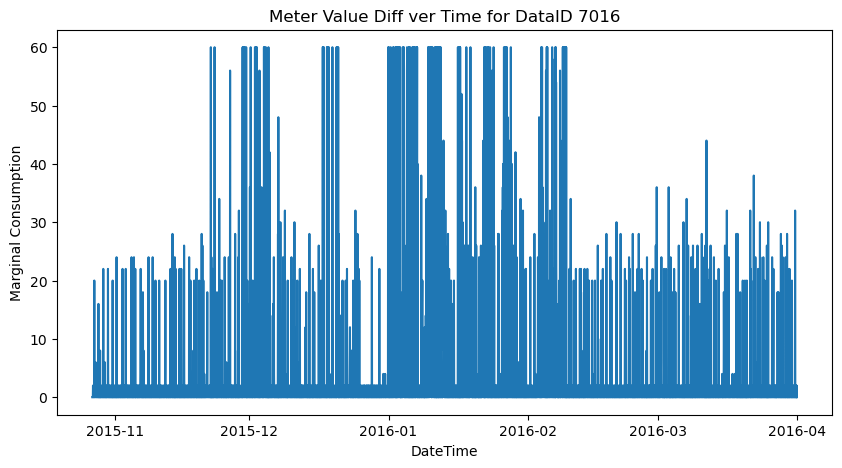

Dataid 7017 threshold: 42.0


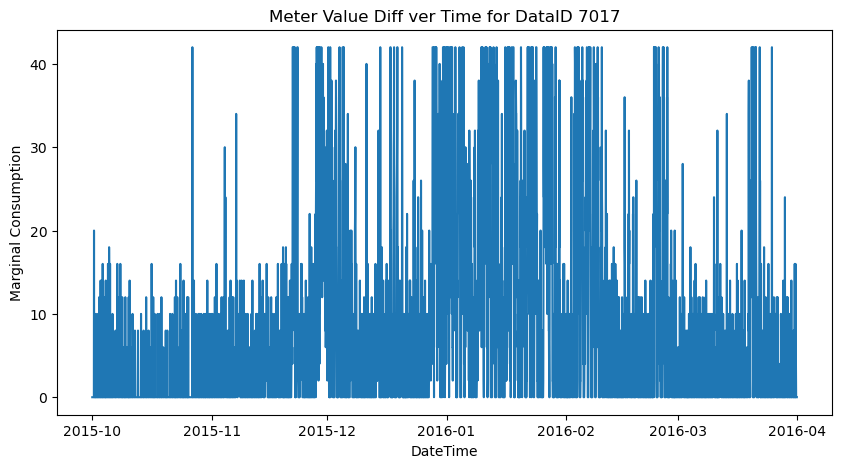

Dataid 7287 threshold: 22.0


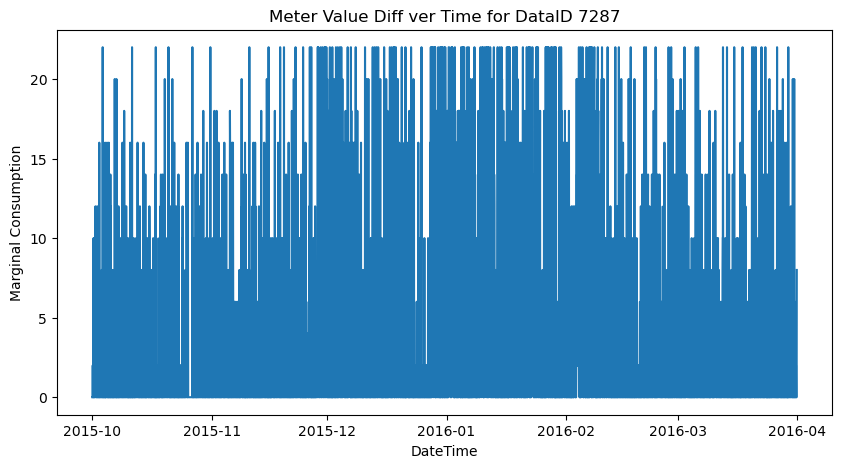

Dataid 7429 threshold: 32.0


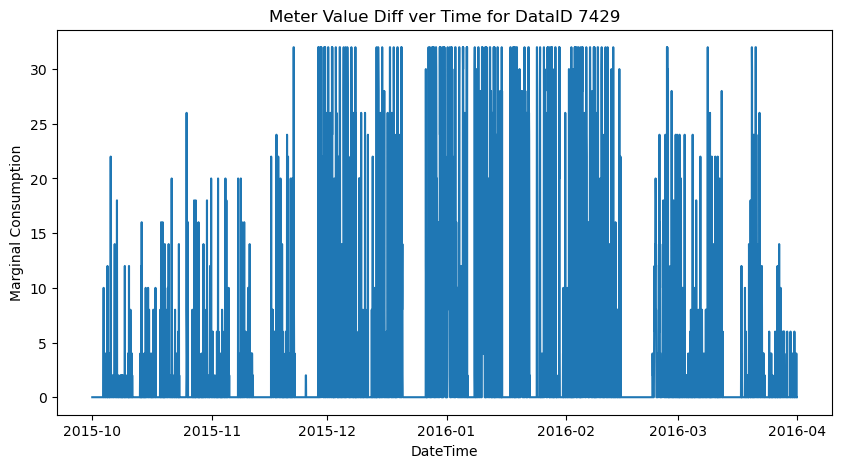

Dataid 7460 threshold: 50.0


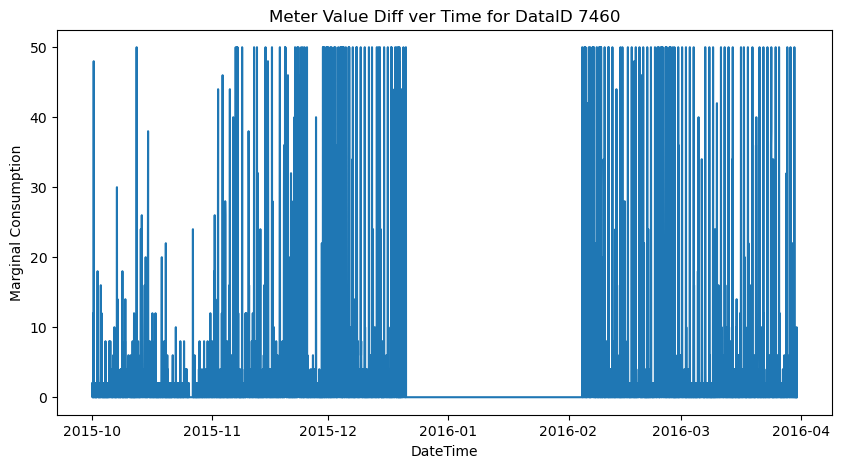

Dataid 7674 threshold: 38.0


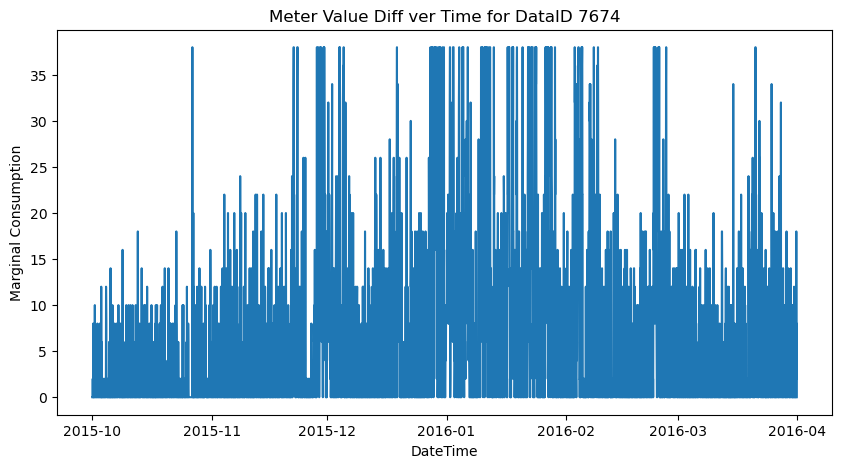

Dataid 7682 threshold: 30.0


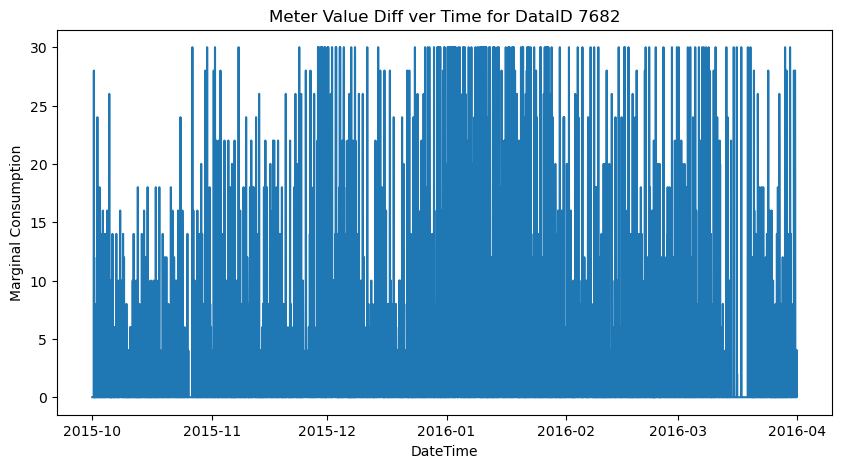

Dataid 7739 threshold: 22.0


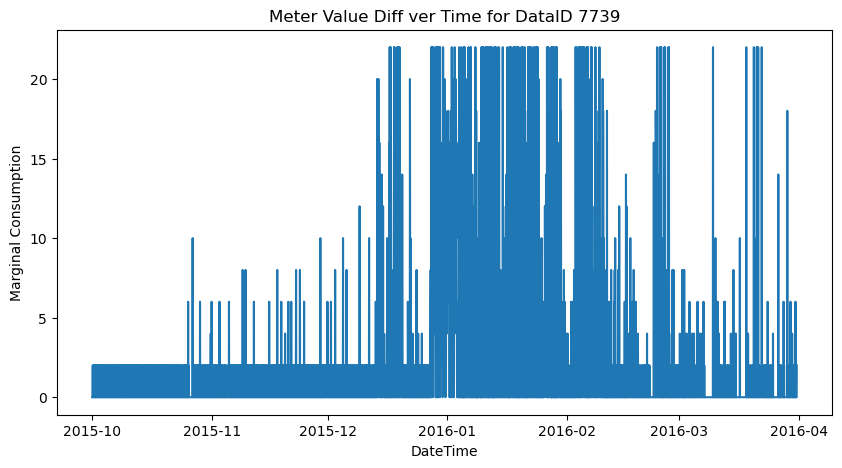

Dataid 7741 threshold: 30.0


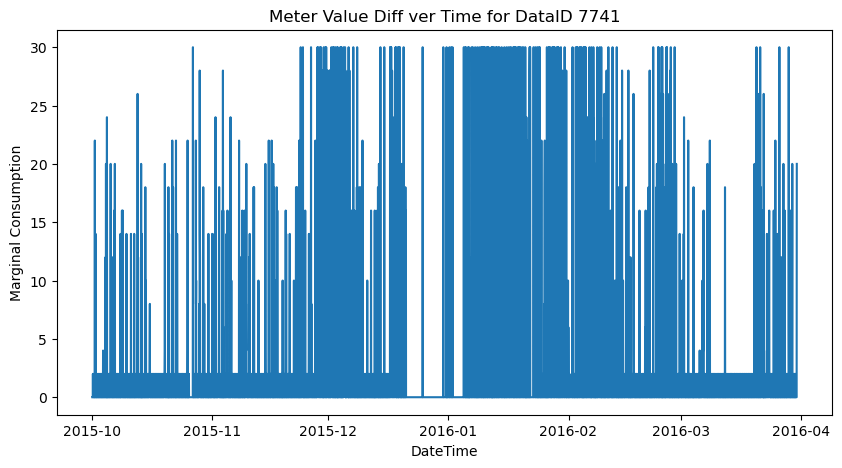

Dataid 7794 threshold: 56.0


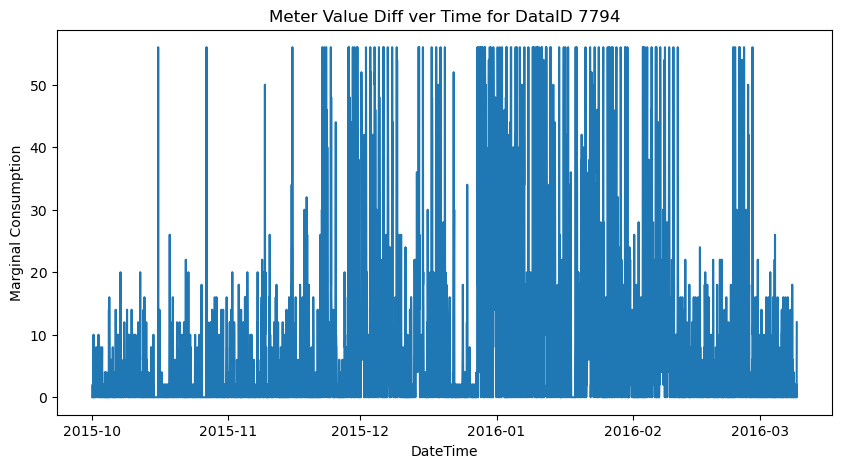

Dataid 7900 threshold: 46.0


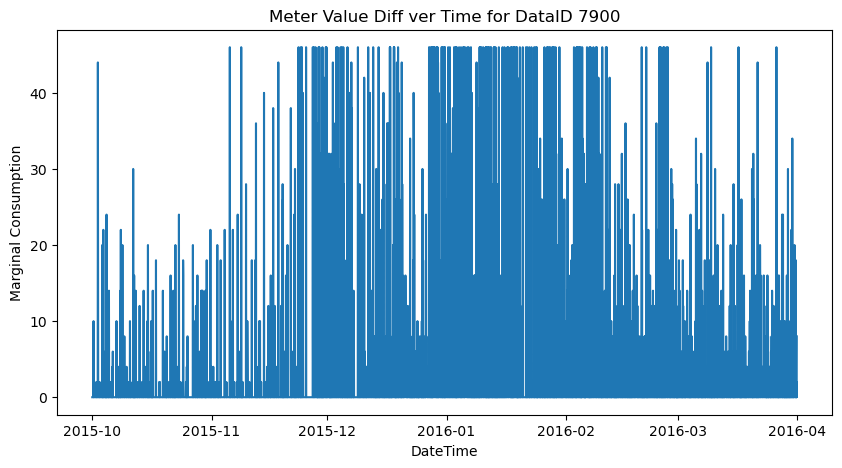

Dataid 7919 threshold: 22.0


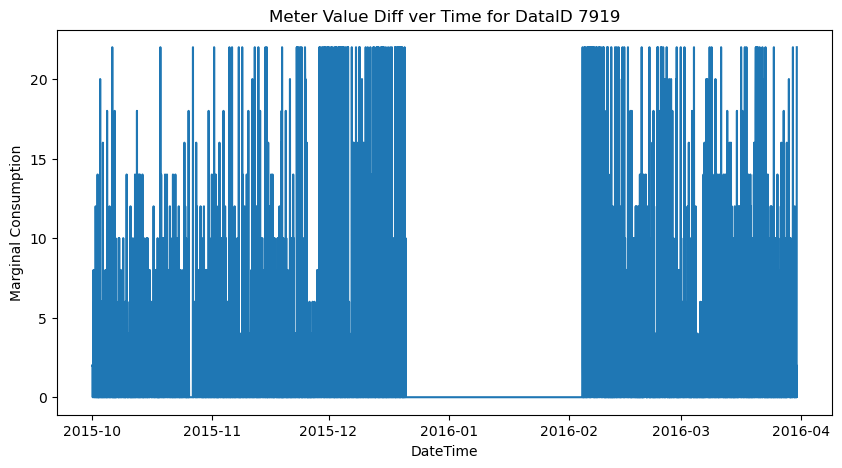

Dataid 7965 threshold: 18.0


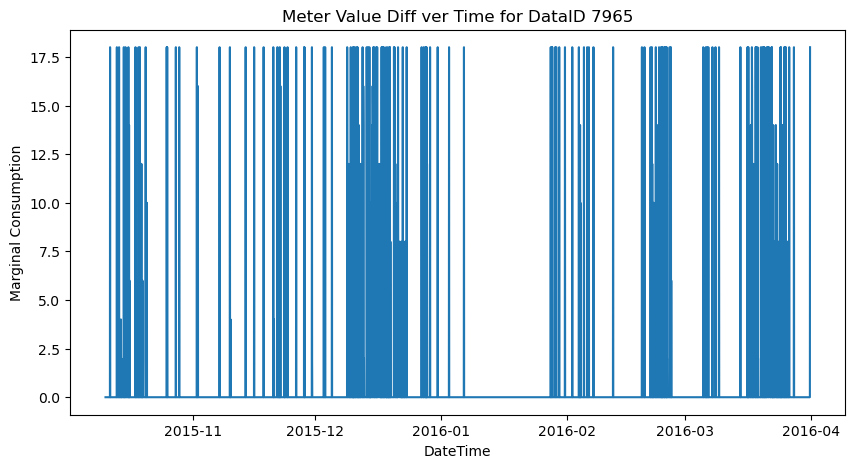

Dataid 7989 threshold: 24.0


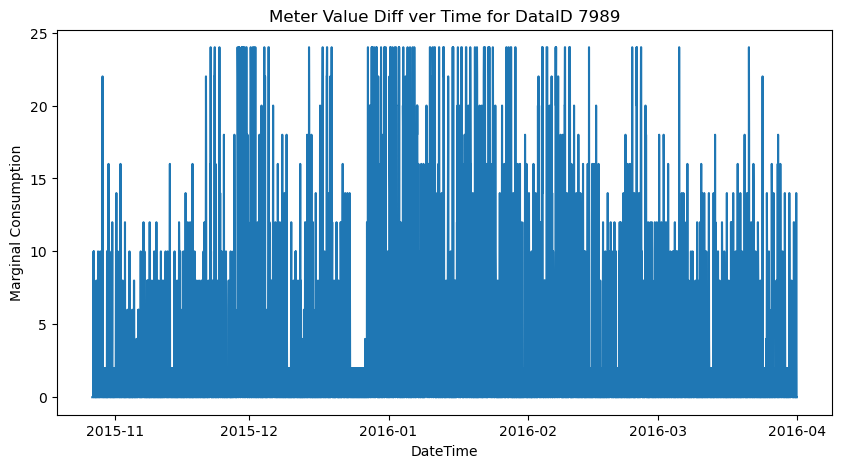

Dataid 8059 threshold: 18.0


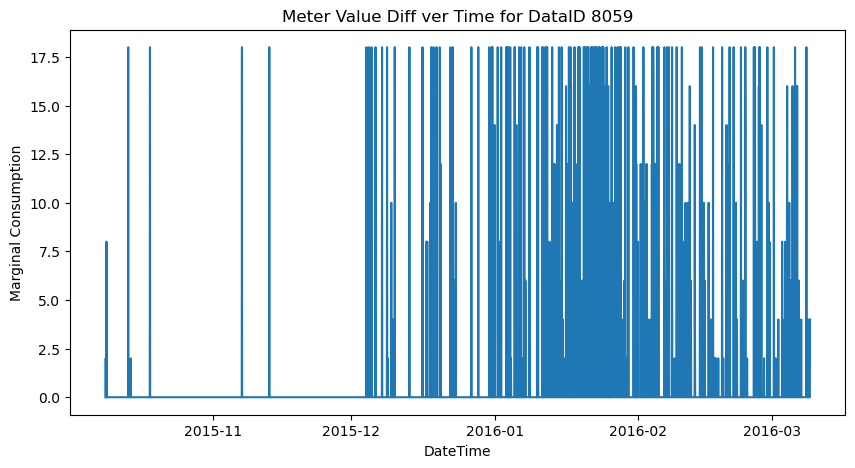

Dataid 8084 threshold: 20.0


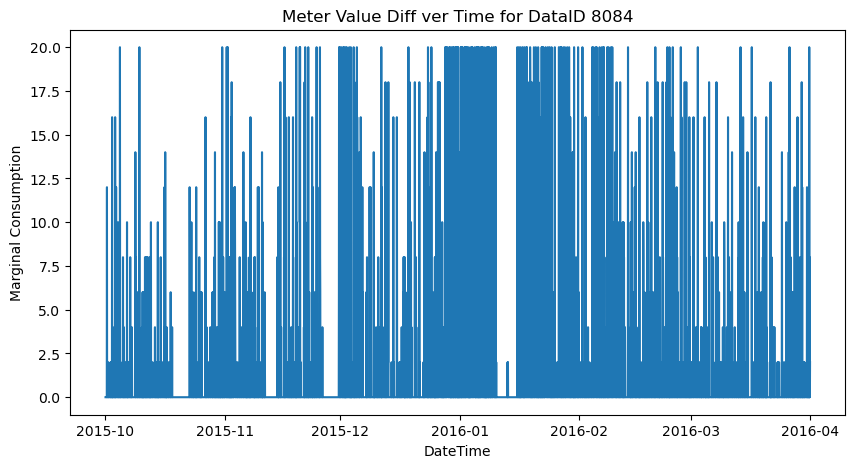

Dataid 8086 threshold: 40.0


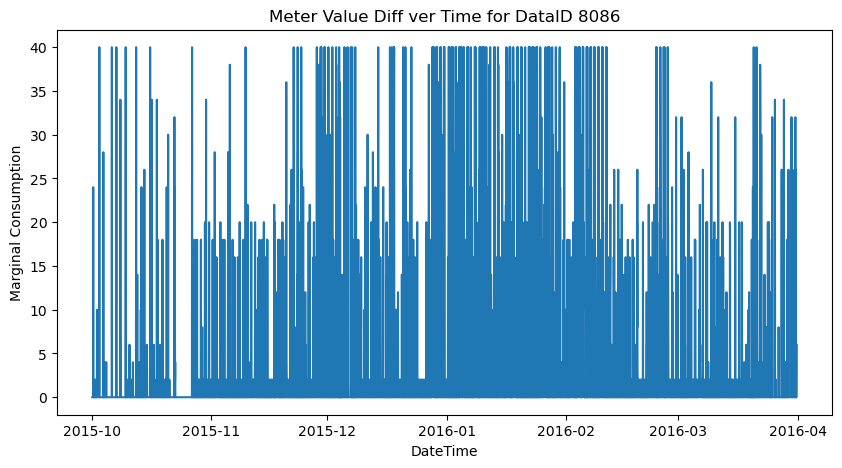

Dataid 8155 threshold: 46.0


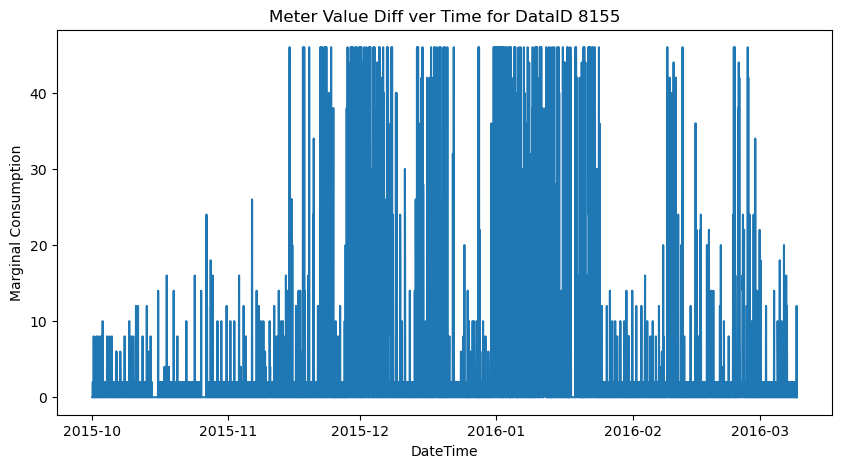

Dataid 8244 threshold: 40.0


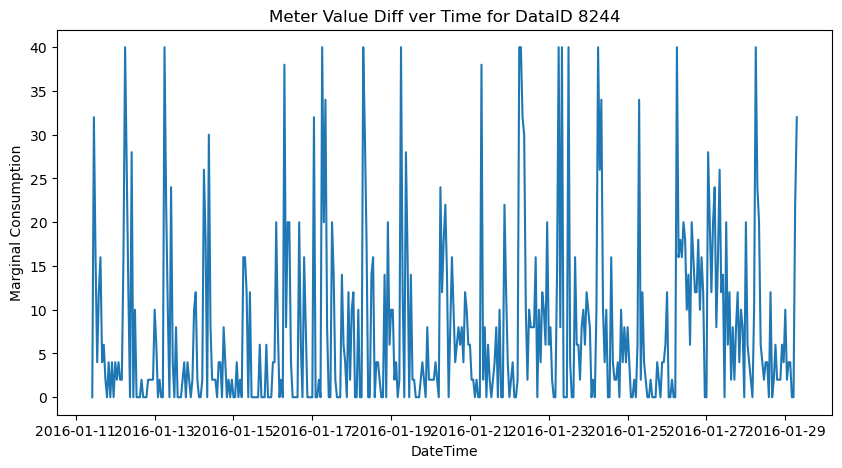

Dataid 8386 threshold: 36.0


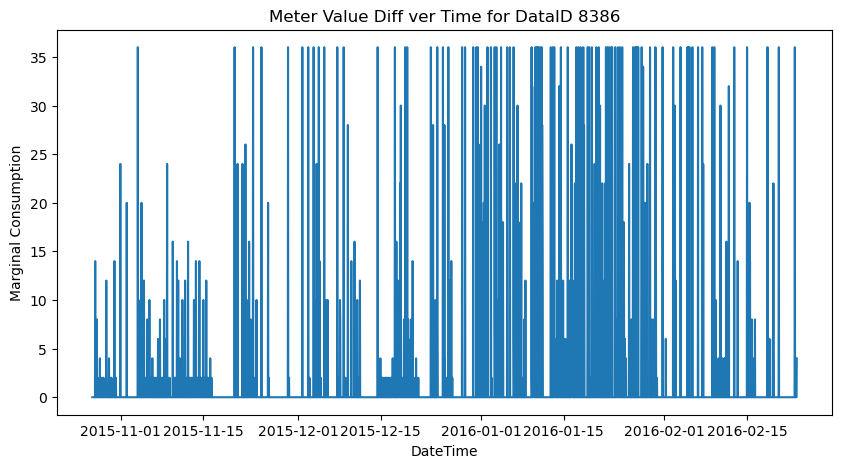

Dataid 8467 threshold: 16.0


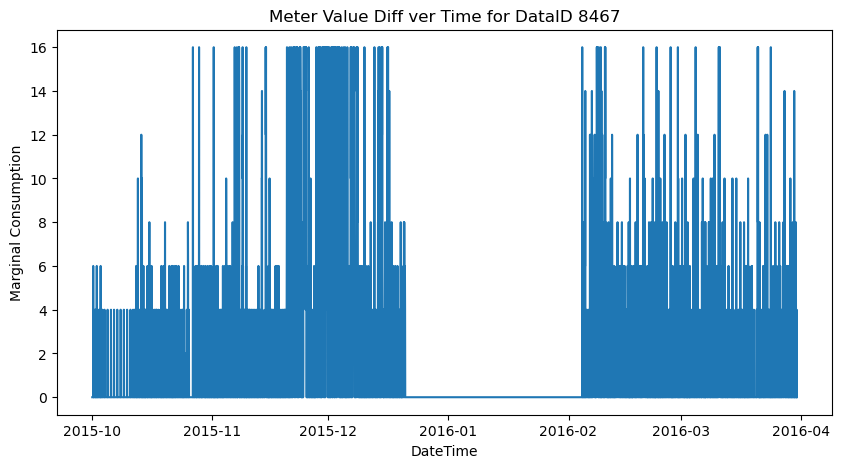

Dataid 8703 threshold: 4.0


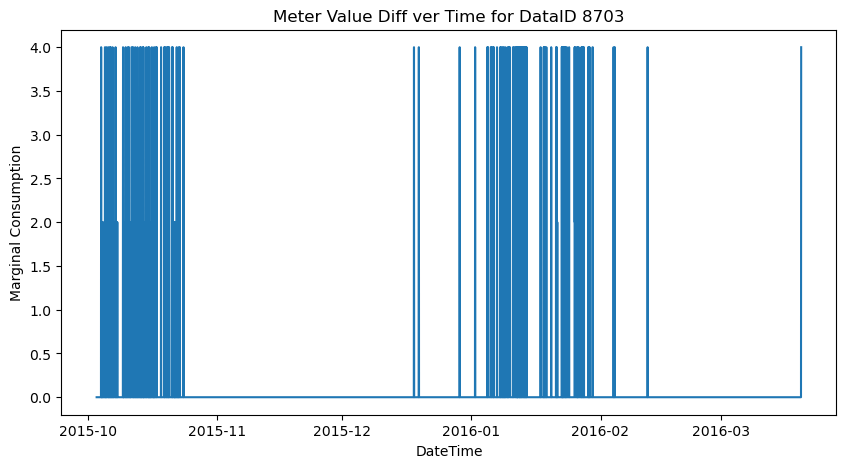

Dataid 8829 threshold: 28.0


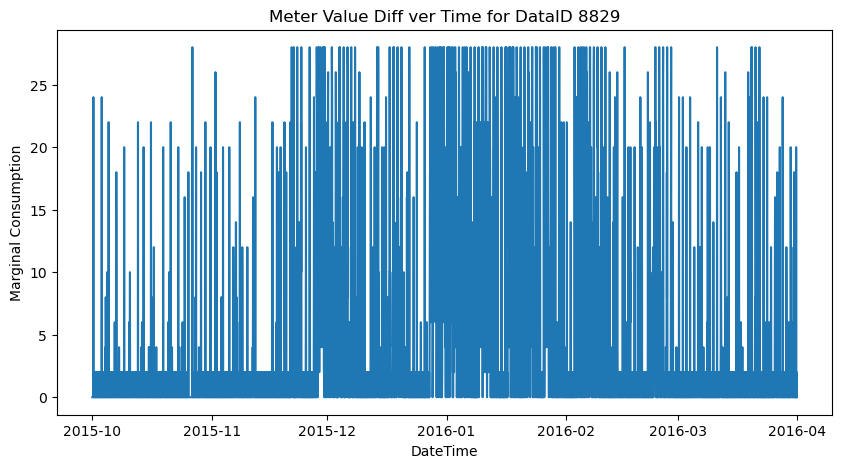

Dataid 8890 threshold: 34.0


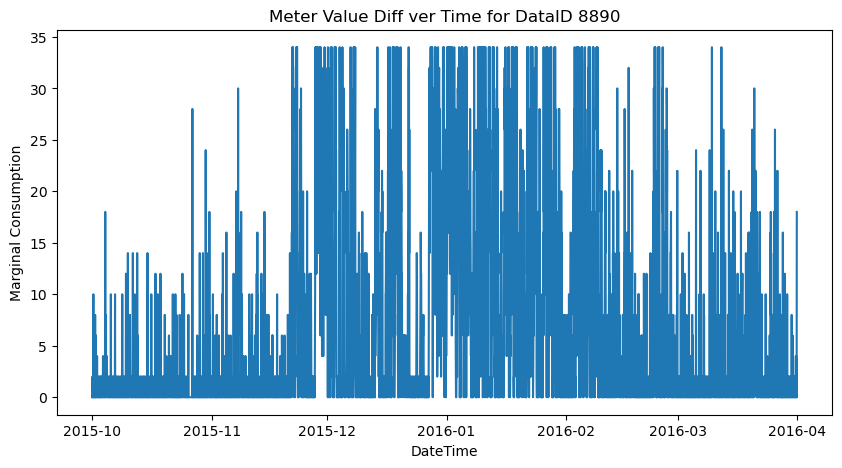

Dataid 8967 threshold: 2.0


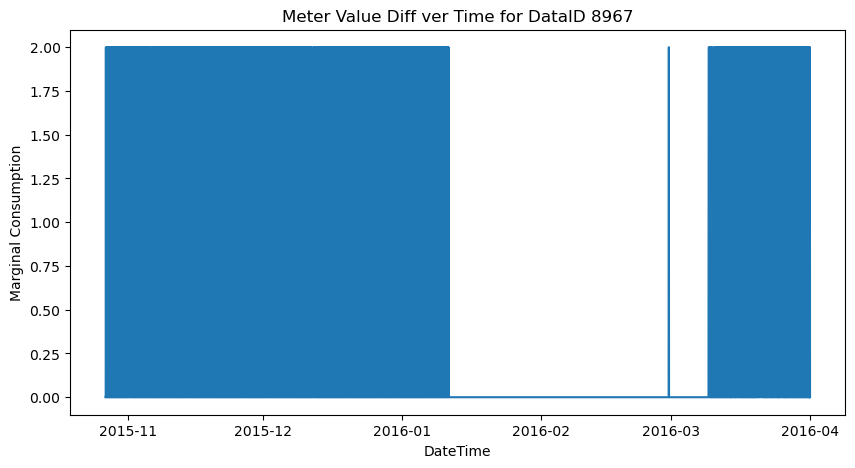

Dataid 9052 threshold: 62.0


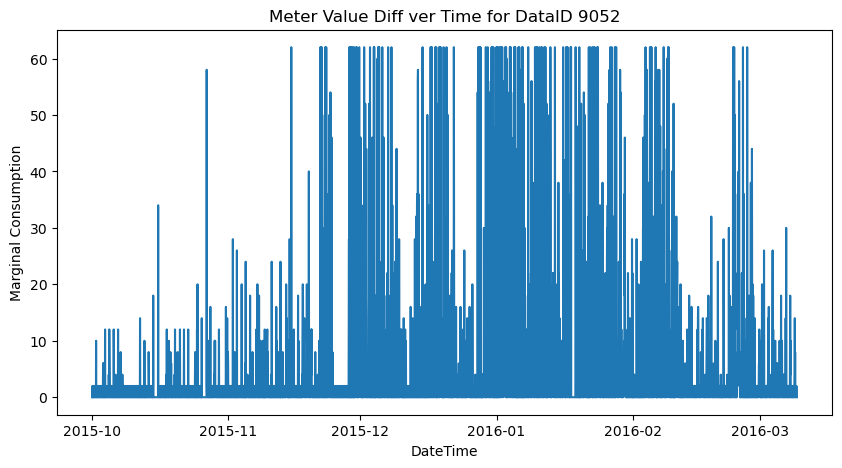

Dataid 9121 threshold: 38.0


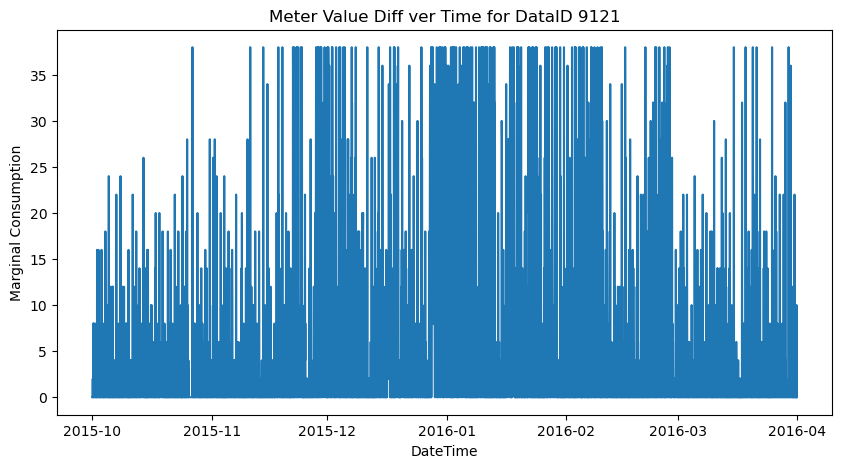

Dataid 9278 threshold: 22.0


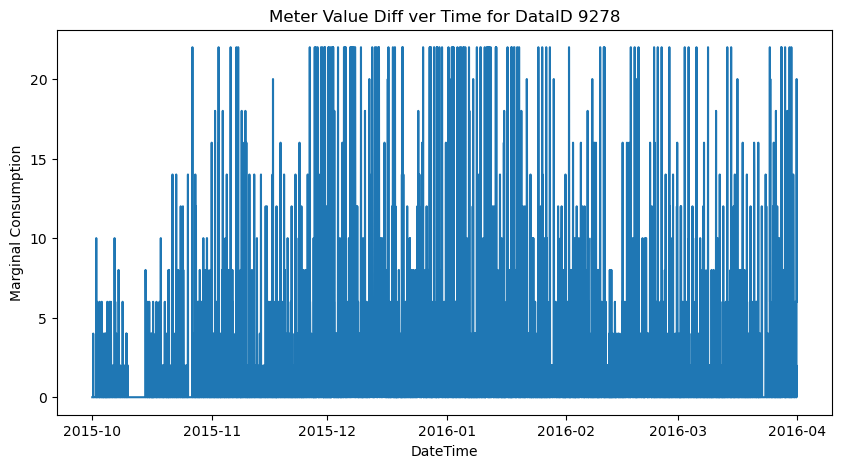

Dataid 9295 threshold: 32.0


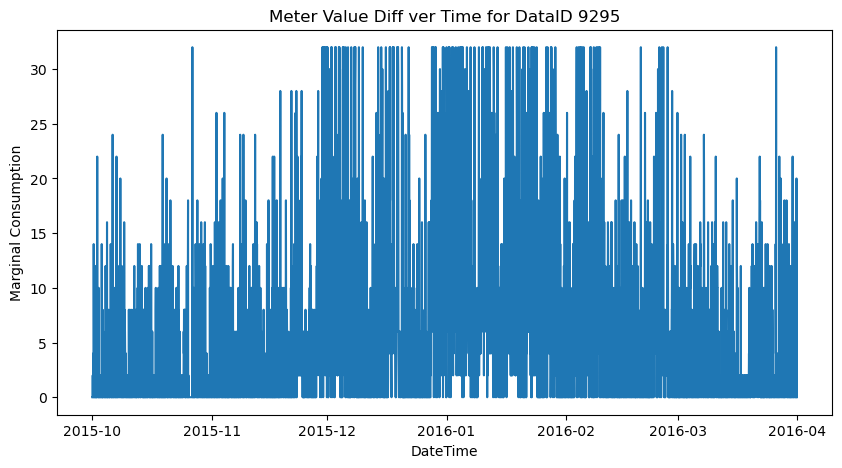

Dataid 9474 threshold: 26.0


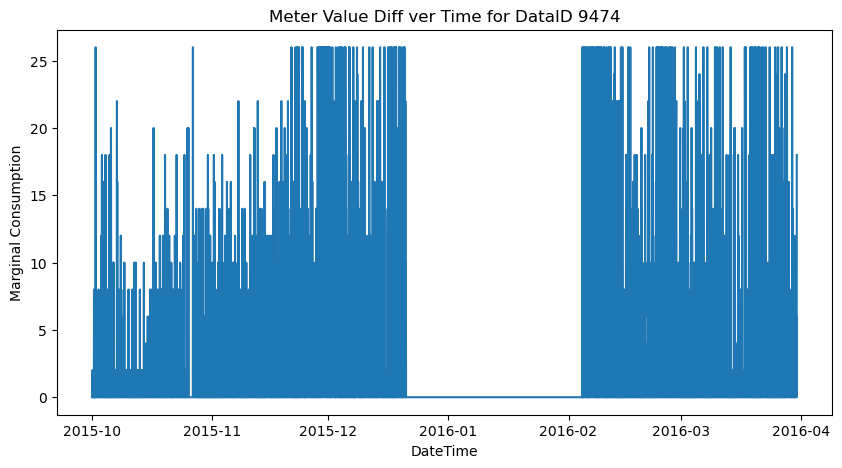

Dataid 9600 threshold: 42.0


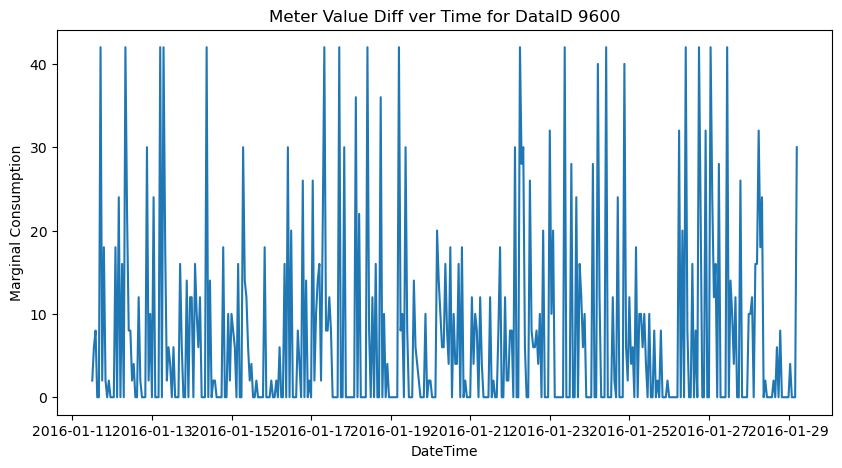

Dataid 9631 threshold: 28.0


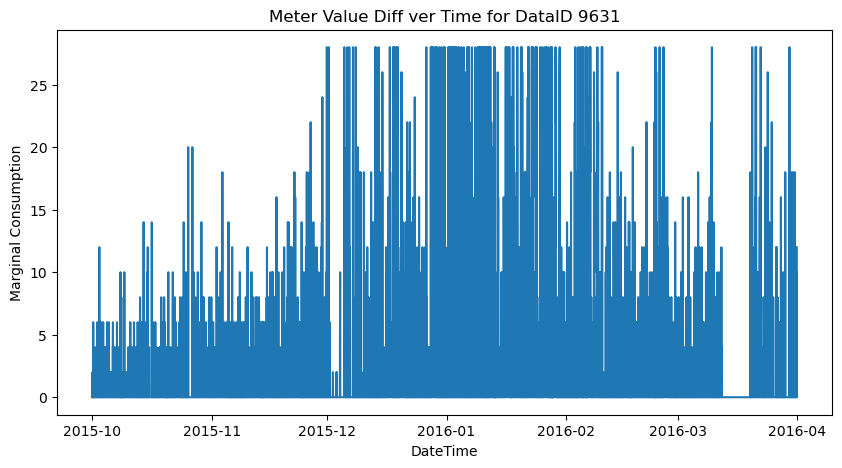

Dataid 9639 threshold: 40.0


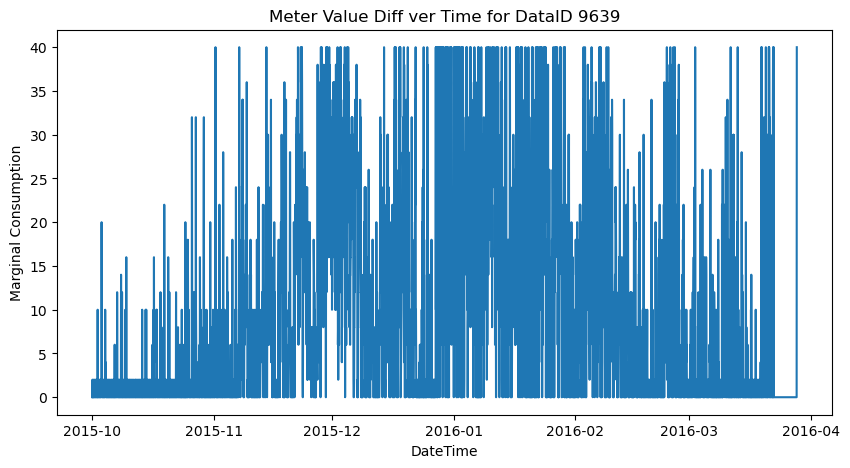

Dataid 9729 threshold: 26.0


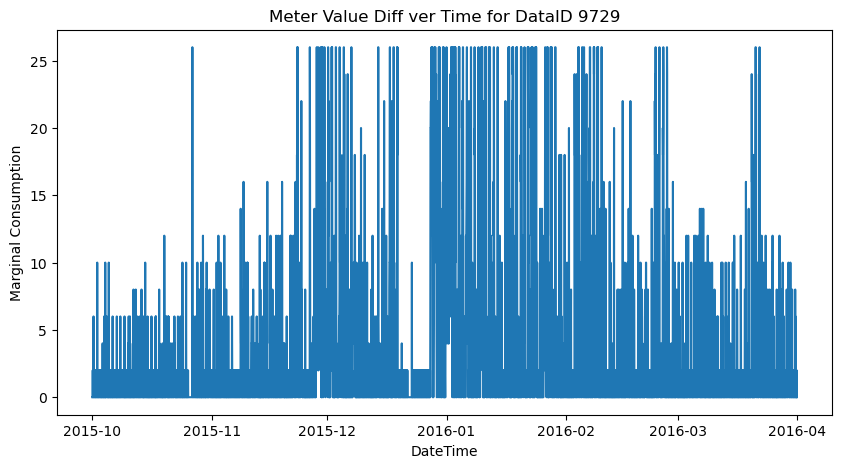

Dataid 9766 threshold: 38.0


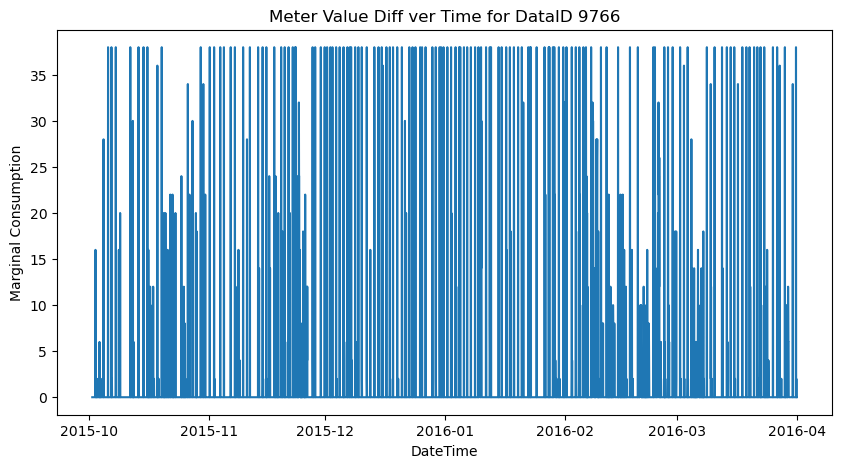

Dataid 9849 threshold: 12.0


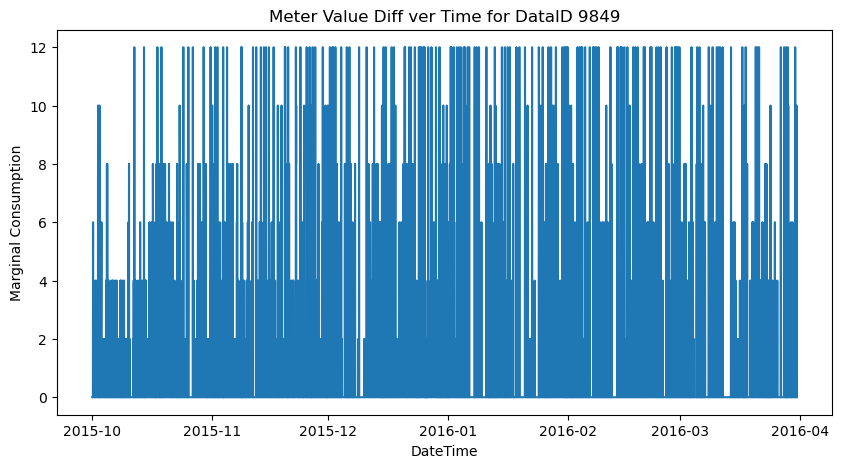

Dataid 9956 threshold: 14.0


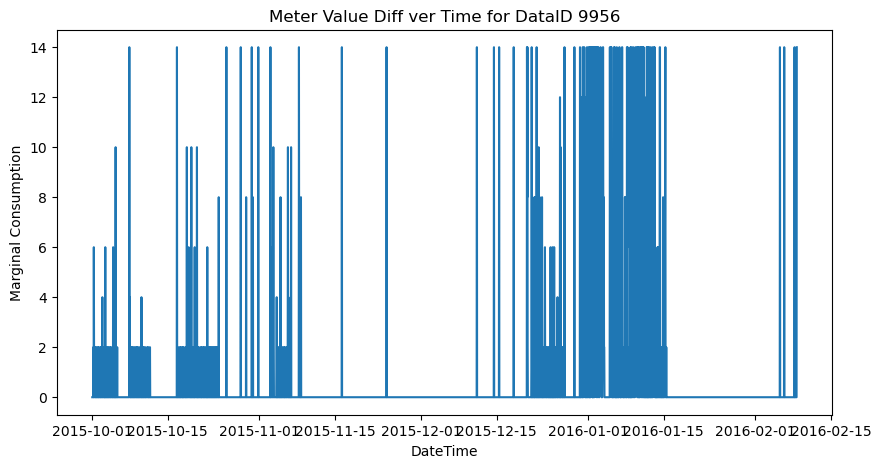

[localminute
 2015-10-01 00:00:00     0.0
 2015-10-01 01:00:00     0.0
 2015-10-01 02:00:00     0.0
 2015-10-01 03:00:00     0.0
 2015-10-01 04:00:00     0.0
                        ... 
 2016-03-31 19:00:00    10.0
 2016-03-31 20:00:00     0.0
 2016-03-31 21:00:00     2.0
 2016-03-31 22:00:00     6.0
 2016-03-31 23:00:00     2.0
 Name: marginal_consumption, Length: 4392, dtype: float64,
 localminute
 2015-10-12 18:00:00     0.0
 2015-10-12 19:00:00     0.0
 2015-10-12 20:00:00     0.0
 2015-10-12 21:00:00    10.0
 2015-10-12 22:00:00     0.0
                        ... 
 2016-03-03 18:00:00     0.0
 2016-03-03 19:00:00     0.0
 2016-03-03 20:00:00     0.0
 2016-03-03 21:00:00     2.0
 2016-03-03 22:00:00     0.0
 Name: marginal_consumption, Length: 3437, dtype: float64,
 localminute
 2015-10-01 01:00:00    0.0
 2015-10-01 02:00:00    0.0
 2015-10-01 03:00:00    0.0
 2015-10-01 04:00:00    0.0
 2015-10-01 05:00:00    0.0
                       ... 
 2016-03-31 19:00:00    0.0
 2016-03-

In [78]:
winsorized = []
for dataid, group in df.groupby('dataid'):
    group['marginal_consumption'] = winsorize(group['marginal_consumption'], limits=[0, 0.03])
    cap = group['marginal_consumption'].max()
    print(f"Dataid {dataid} threshold: {cap}")
    plt.figure(figsize=(10, 5))
    plt.plot(group.index, group['marginal_consumption'], label=f'Meter {dataid}')
    plt.xlabel('DateTime')
    plt.ylabel('Marginal Consumption')
    plt.title(f'Meter Value Diff ver Time for DataID {dataid}')
    plt.show() 
    winsorized.append(group['marginal_consumption'])
winsorized

In [79]:
df_2 = df.copy()
df_2['marginal_consumption'] = pd.concat(winsorized)
df_2['marginal_consumption']

localminute
2015-10-01 00:00:00     0.0
2015-10-01 01:00:00     0.0
2015-10-01 02:00:00     0.0
2015-10-01 03:00:00     0.0
2015-10-01 04:00:00     0.0
                       ... 
2016-02-08 12:00:00     0.0
2016-02-08 13:00:00     0.0
2016-02-08 14:00:00     0.0
2016-02-08 15:00:00     0.0
2016-02-08 16:00:00    14.0
Name: marginal_consumption, Length: 525621, dtype: float64

In [80]:
df_2['marginal_consumption'].skew()

3.4469665967716994

In [81]:
from statsmodels.tsa.seasonal import seasonal_decompose

In [48]:
# for dataid, group in df_2.groupby('dataid'):
#     seasonal = seasonal_decompose(group['marginal_consumption'], model="additive", period=1)
#     seasonal.plot()
#     plt.title(f"Decomposed Data Id {dataid}")
#     plt.show()

We fixed some of the outlier issues using winsorization, and tried to decompose the time series into trend, seasonal and residual. The decomposition showed no seasonal or residual values, so was unable to effectively decompose. Let's now have a look at the autocorrelation

In [82]:
from statsmodels.graphics.tsaplots import plot_acf

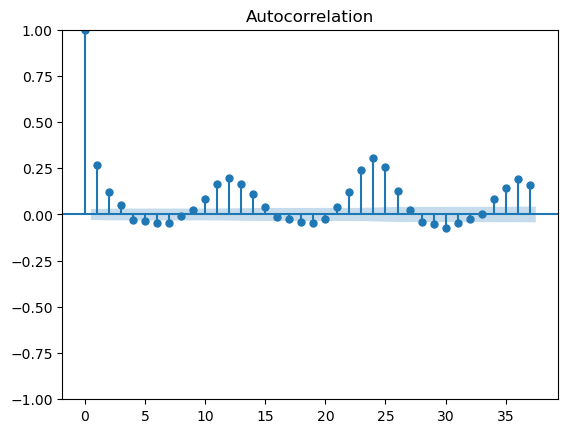

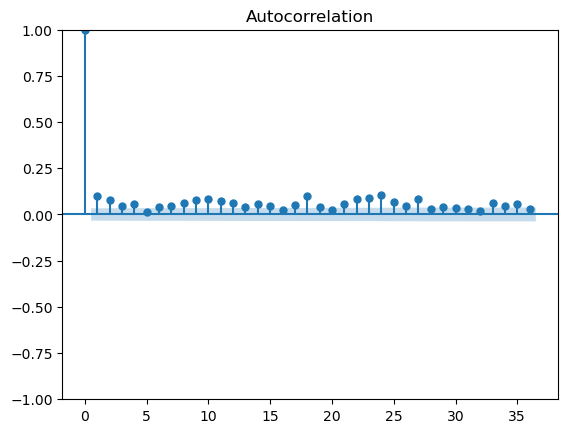

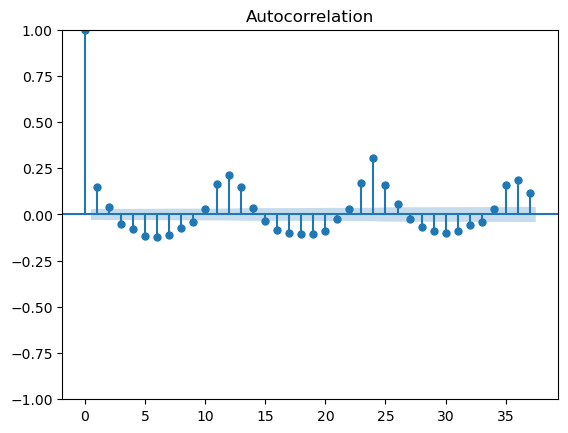

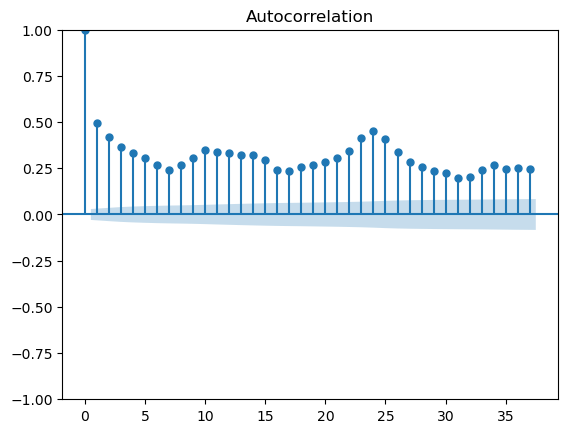

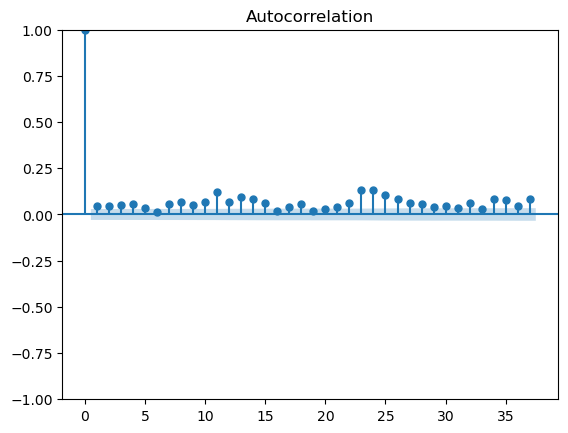

...

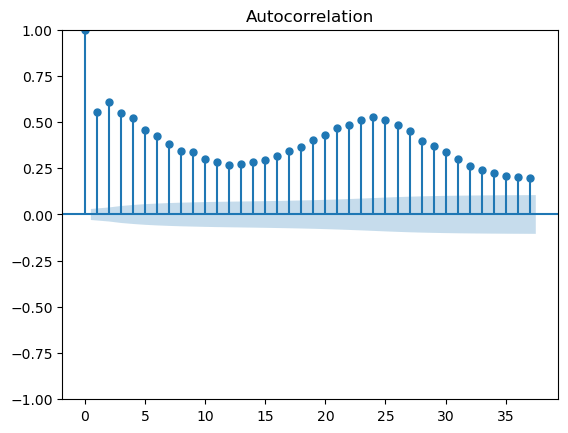

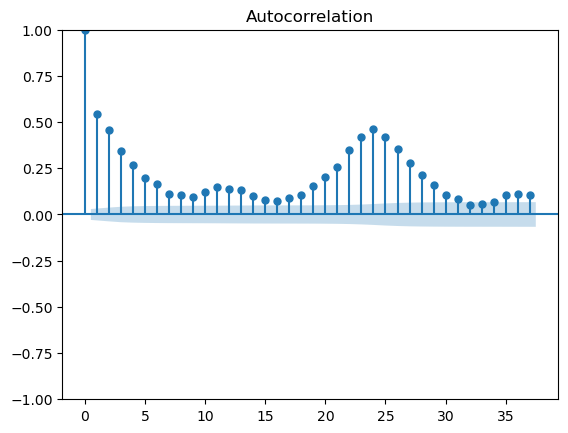

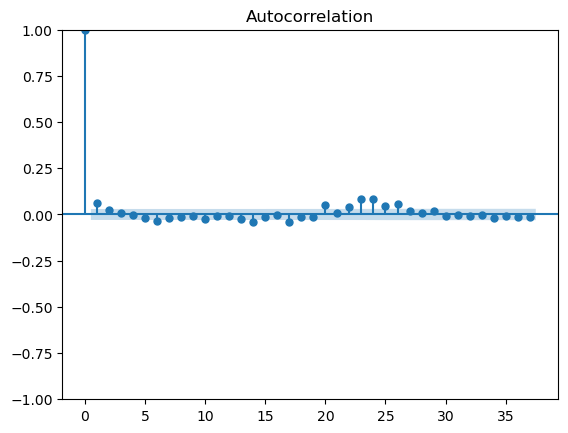

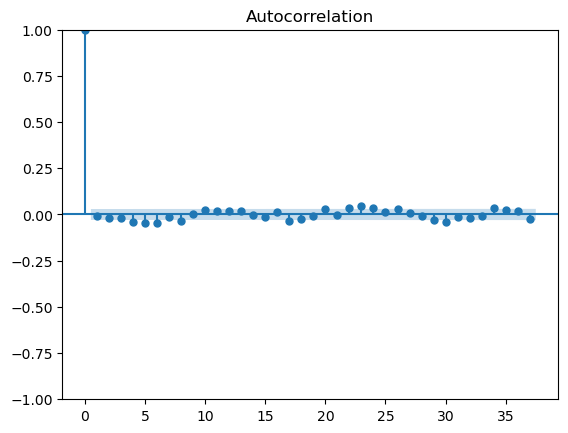

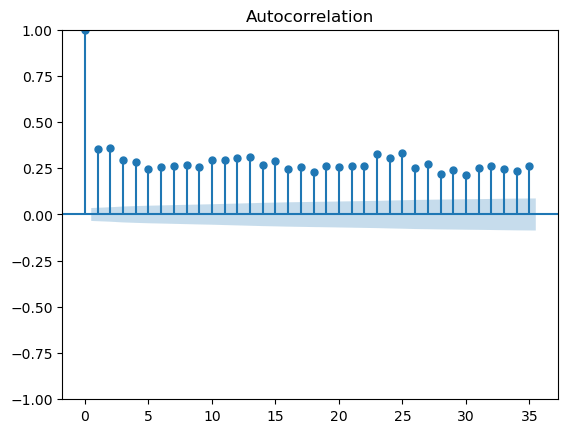

In [50]:
for dataid, group in df_2.groupby('dataid'):
    plot_acf(group['marginal_consumption'])
    plt.show()

from pandas.plotting import register_matplotlib_converters

register_matplotlib_converters()

In [51]:
df_2.describe()

/Users/Dev/Documents/Projects/imputation-research/code/env/lib/python3.12/site-packages/numpy/lib/function_base.py:4824: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  arr.partition(


,marginal_consumption,dataid,DST
count,525621.000000,525621.000000,525621.000000
mean,3.673339,4598.819558,0.250085
std,8.548019,2962.423080,0.433062
min,0.000000,35.000000,0.000000
25%,0.000000,1801.000000,0.000000
50%,0.000000,4296.000000,0.000000
75%,2.000000,7429.000000,1.000000
max,80.000000,9956.000000,1.000000


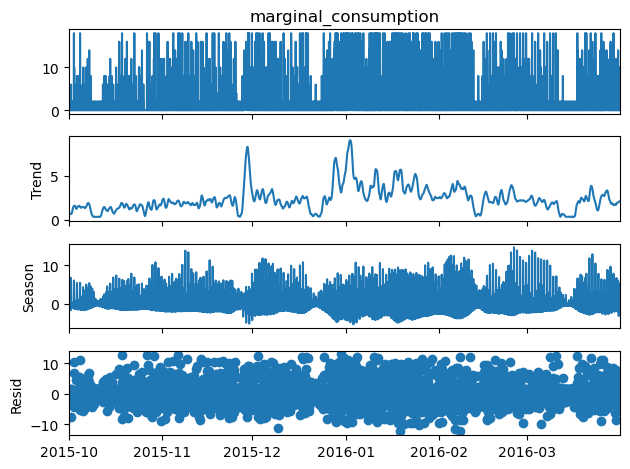

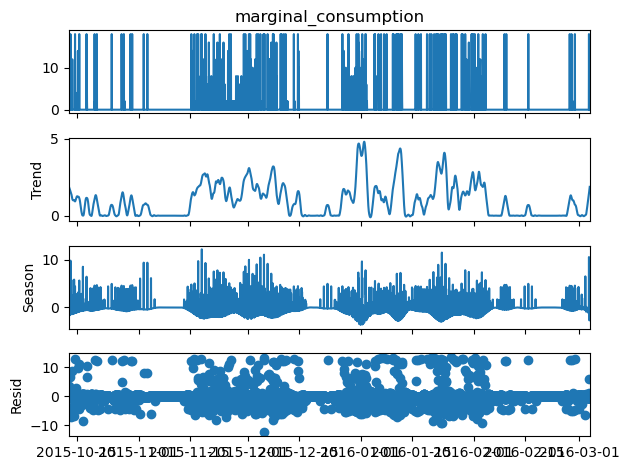

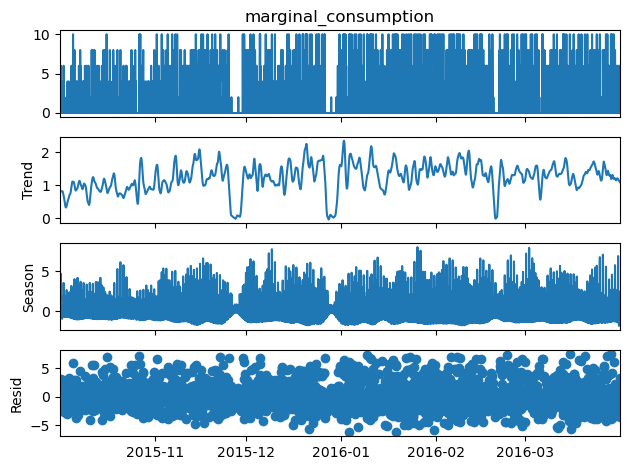

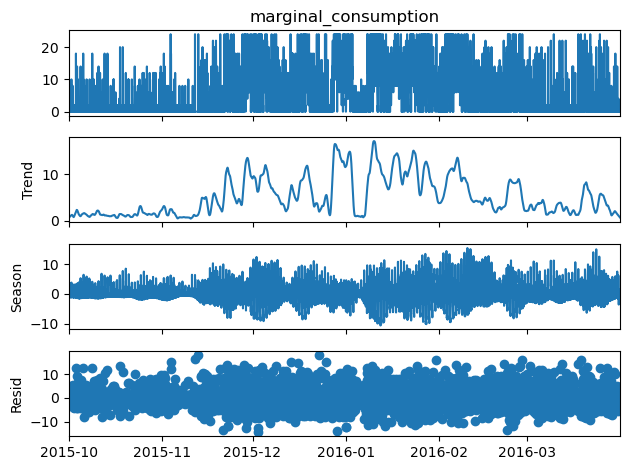

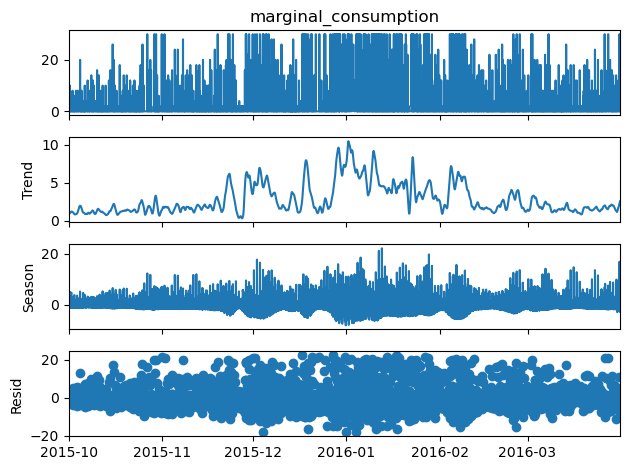

...

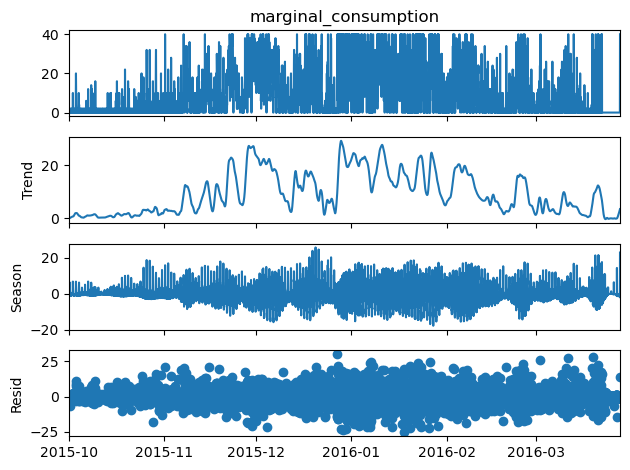

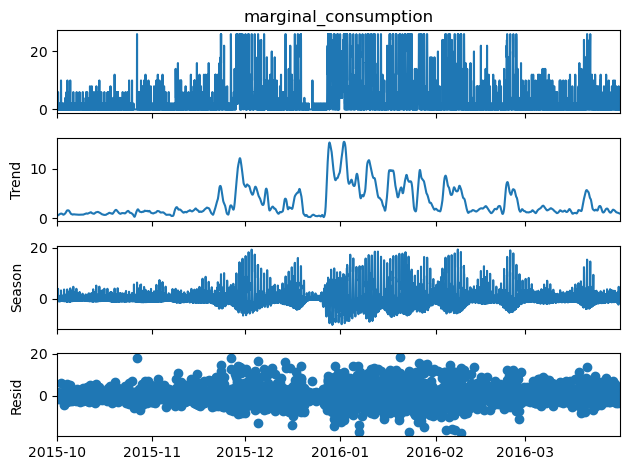

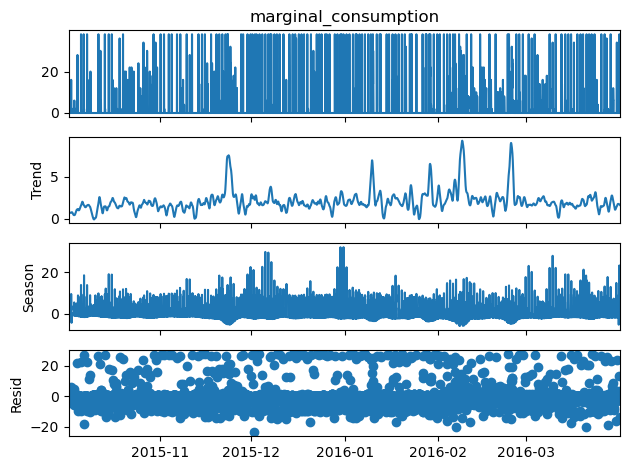

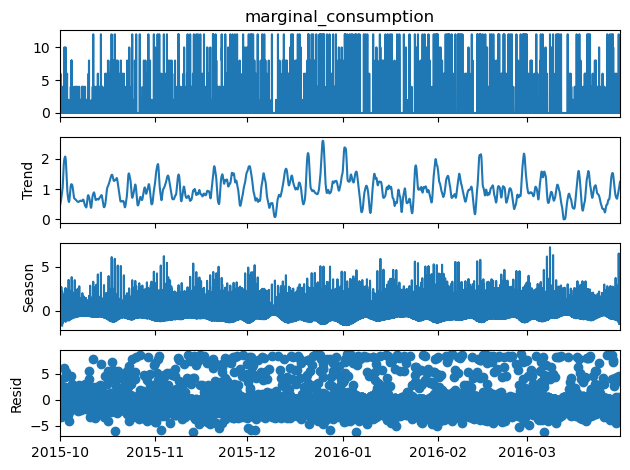

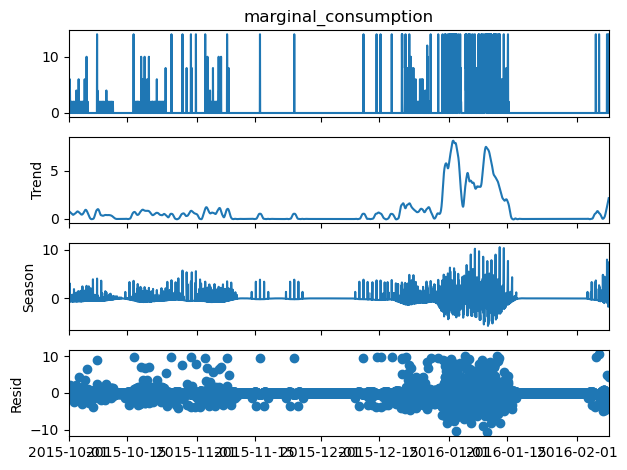

In [52]:
from statsmodels.tsa.seasonal import STL

for dataid, group in df_2.groupby('dataid'):
    stl = STL(group['marginal_consumption'])
    res = stl.fit()
    fig = res.plot()
    plt.show()


In [83]:
transformed['marginal_consumption'].skew()

NameError: name 'transformed' is not defined

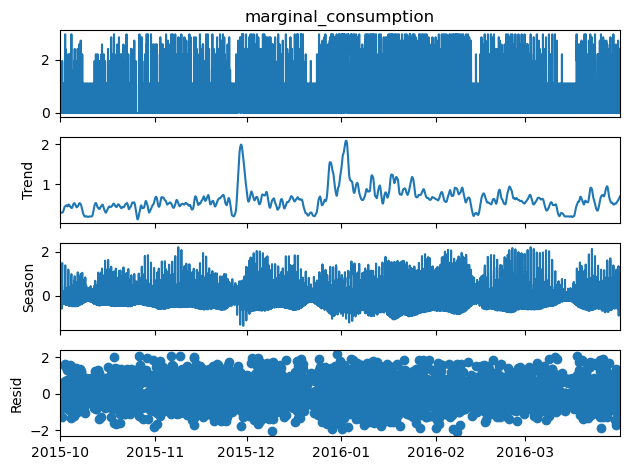

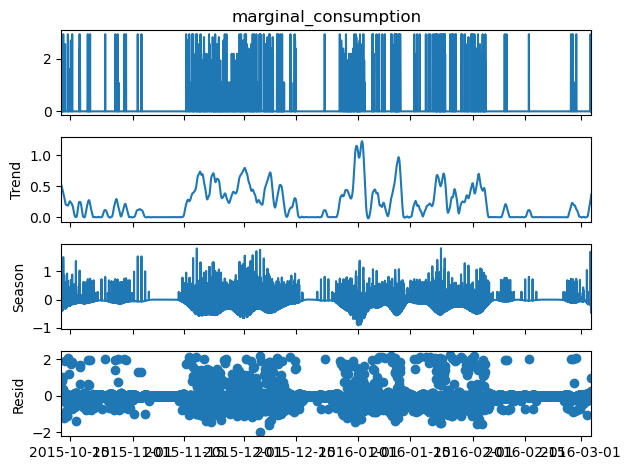

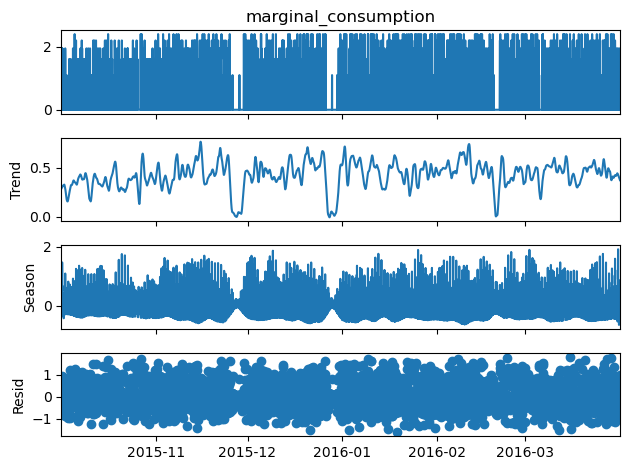

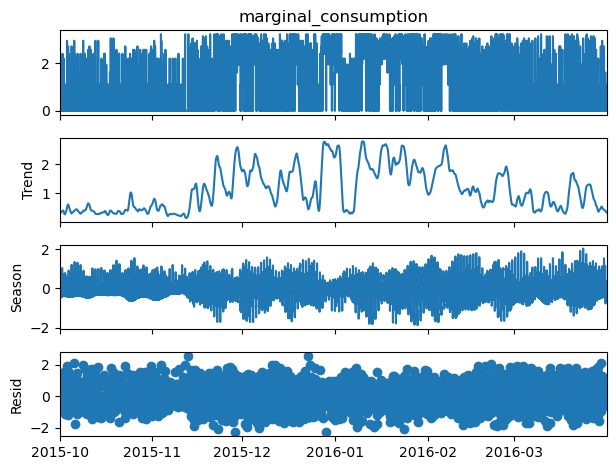

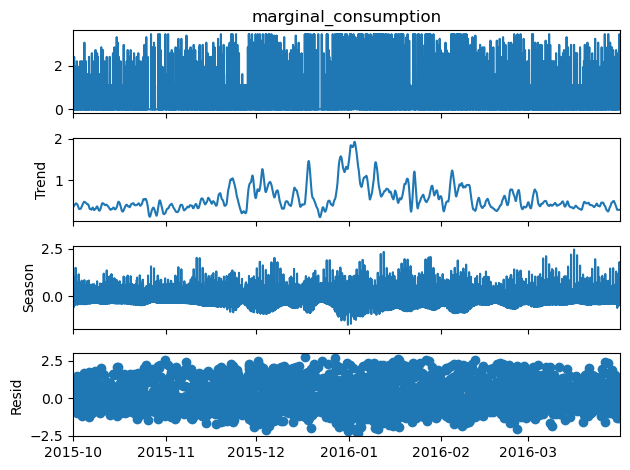

...

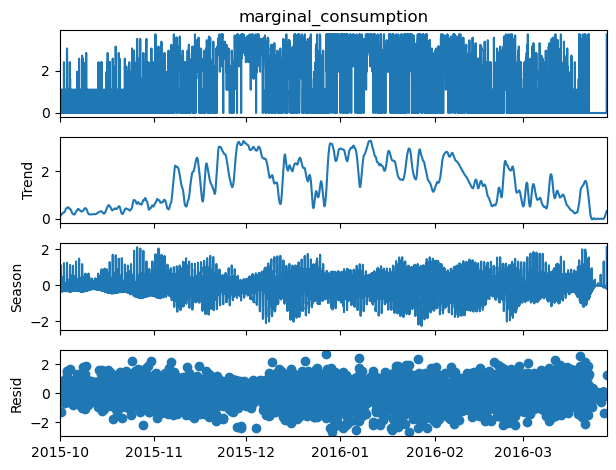

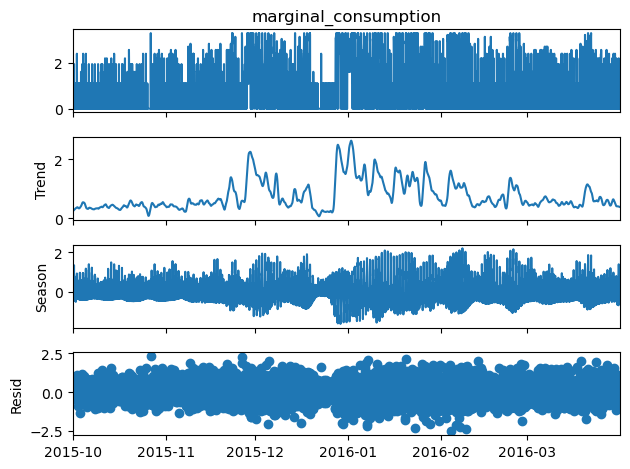

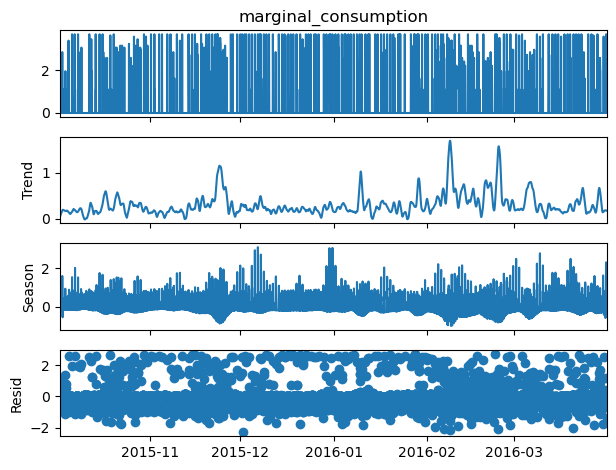

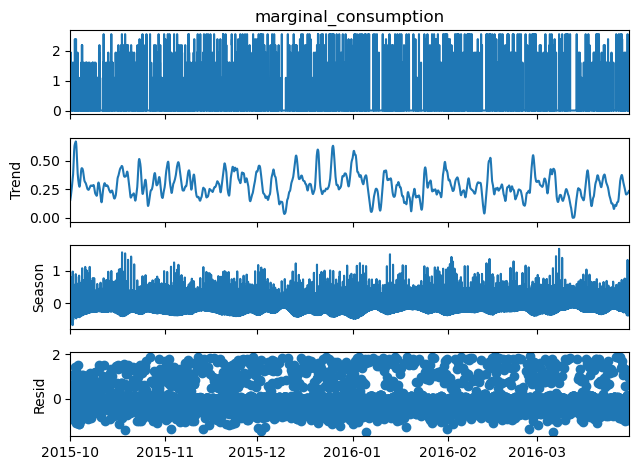

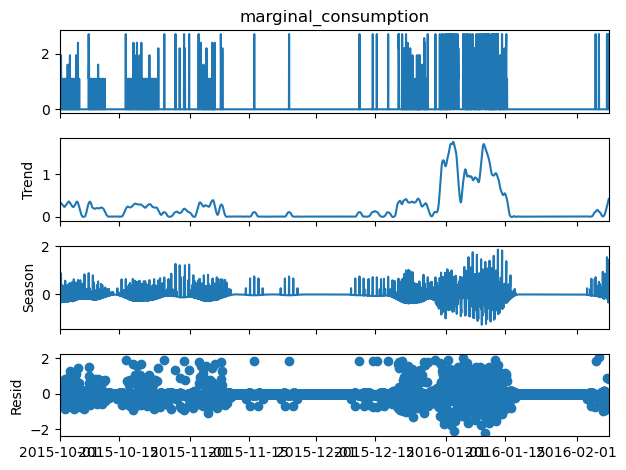

In [55]:
from statsmodels.tsa.seasonal import STL

for dataid, group in transformed.groupby('dataid'):
    stl = STL(group['marginal_consumption'])
    res = stl.fit()
    fig = res.plot()
    plt.show()

So now we've tried to decompose the data and found some issues. The graphs seem a little bit off, and I'm starting to suspects some other issues going on as a lot of graphs and statistics seem to be a little off for our data. We're now going to run some tests to diagnose the exact issue to fix it.

First we are going to test for stationarity using the Augmented Dickey-Fuller Test

In [56]:
from statsmodels.tsa.stattools import adfuller

for dataid, group in df_2.groupby('dataid'):
    result = adfuller(group["marginal_consumption"].values)
    if result[1] <= 0.05:
        print("Stationary")
    else:
        print(f"Not stationary: {dataid}")

Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary

In [57]:
import warnings
from statsmodels.tools.sm_exceptions import InterpolationWarning
warnings.simplefilter('ignore', InterpolationWarning)


In [58]:
from statsmodels.tsa.stattools import kpss
for dataid, group in df_2.groupby('dataid'):
    result = kpss(group["marginal_consumption"].values, regression = "ct")
    if result[1] > 0.05:
        print("Stationary")
    else:
        print(f"Not stationary: {dataid}")

Not stationary: 35
Not stationary: 44
Not stationary: 77
Not stationary: 94
Not stationary: 114
Not stationary: 187
Stationary
Not stationary: 252
Not stationary: 370
Not stationary: 483
Not stationary: 484
Not stationary: 661
Not stationary: 739
Not stationary: 744
Not stationary: 871
Not stationary: 1042
Not stationary: 1086
Not stationary: 1103
Not stationary: 1283
Not stationary: 1415
Not stationary: 1507
Not stationary: 1589
Not stationary: 1619
Not stationary: 1697
Not stationary: 1714
Not stationary: 1718
Not stationary: 1790
Not stationary: 1791
Not stationary: 1792
Not stationary: 1800
Not stationary: 1801
Not stationary: 2018
Not stationary: 2034
Not stationary: 2072
Not stationary: 2094
Not stationary: 2129
Not stationary: 2233
Not stationary: 2378
Not stationary: 2461
Not stationary: 2470
Not stationary: 2575
Not stationary: 2638
Not stationary: 2818
Not stationary: 2945
Not stationary: 2965
Not stationary: 2980
Stationary
Not stationary: 3039
Not stationary: 3310
Not stati

If the ADF test result is stationary and the KPSS test result is non-stationary, the time series is difference stationary — Apply differencing to time series and check for stationarity again 

In [34]:
df_2["marginal_diff"] = df_2["marginal_consumption"].diff()
df_2.fillna(0, inplace=True)

NameError: name 'df_2' is not defined

In [60]:
for dataid, group in df_2.groupby('dataid'):
    result = adfuller(group["marginal_diff"].values)
    if result[1] <= 0.05:
        print("Stationary")
    else:
        print(f"Not stationary: {dataid}")

Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary

In [61]:
from statsmodels.tsa.stattools import kpss
for dataid, group in df_2.groupby('dataid'):
    result = kpss(group["marginal_diff"].values, regression = "ct")
    if result[1] > 0.05:
        print("Stationary")
    else:
        print(f"Not stationary: {dataid}")

Not stationary: 35
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Not stationary: 1791
Not stationary: 1792
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Not stationary: 3367
Stationary
Not stationary: 3577
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Not stationary: 5395
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Stationary
Station

In [84]:
df_2["transformed"] = np.log(df_2["marginal_consumption"].values + 1)

In [85]:
df_2

,marginal_consumption,dataid,DST,transformed
localminute,,,,
2015-10-01 00:00:00,0.0,35,1,0.00000
2015-10-01 01:00:00,0.0,35,1,0.00000
2015-10-01 02:00:00,0.0,35,1,0.00000
2015-10-01 03:00:00,0.0,35,1,0.00000
2015-10-01 04:00:00,0.0,35,1,0.00000
...,...,...,...,...
2016-02-08 12:00:00,0.0,9956,0,0.00000
2016-02-08 13:00:00,0.0,9956,0,0.00000
2016-02-08 14:00:00,0.0,9956,0,0.00000


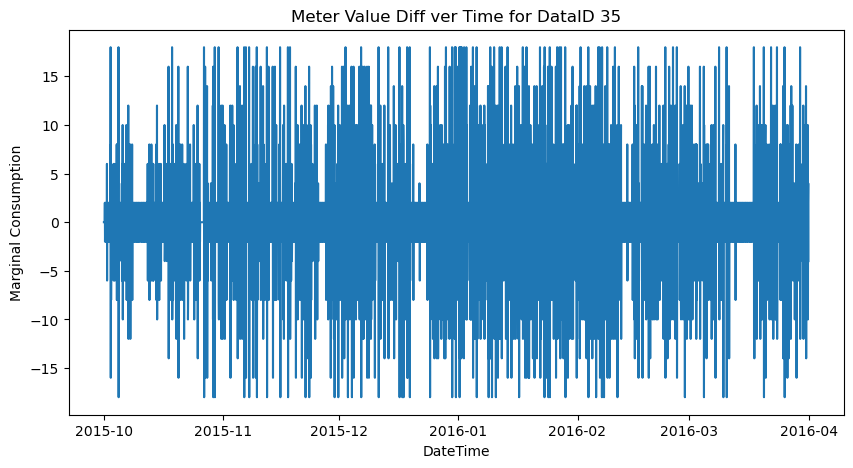

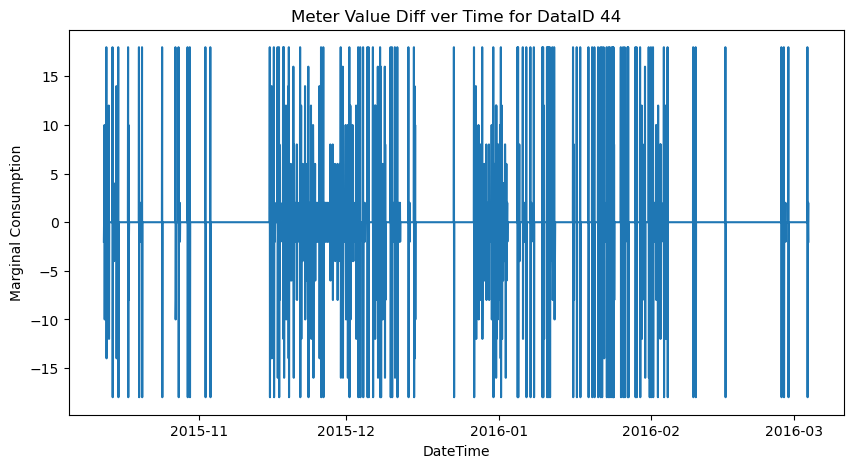

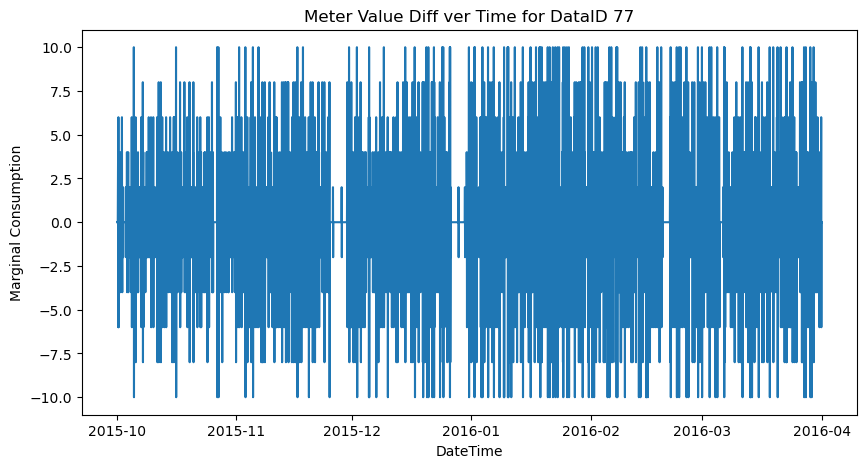

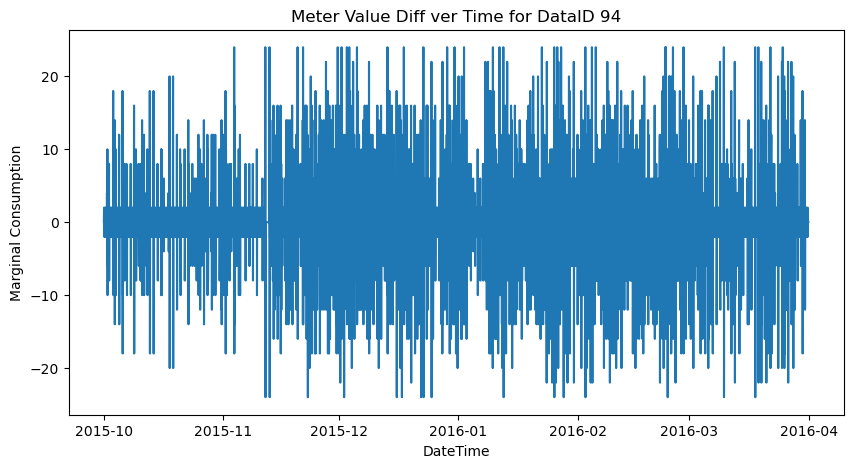

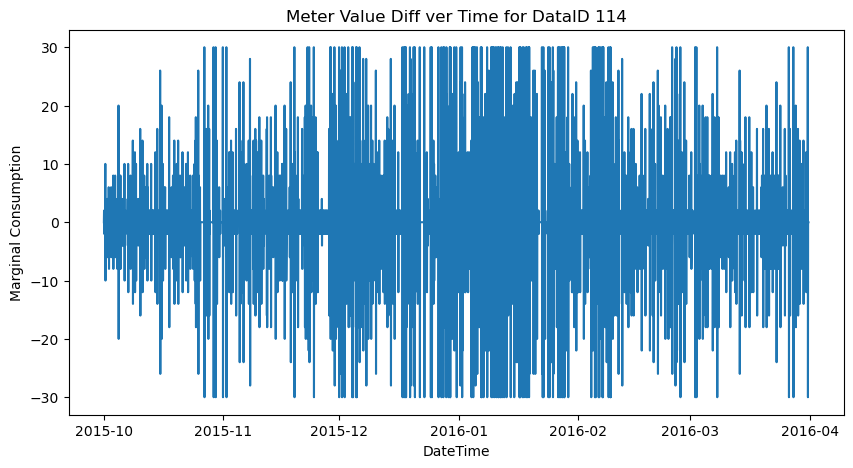

...

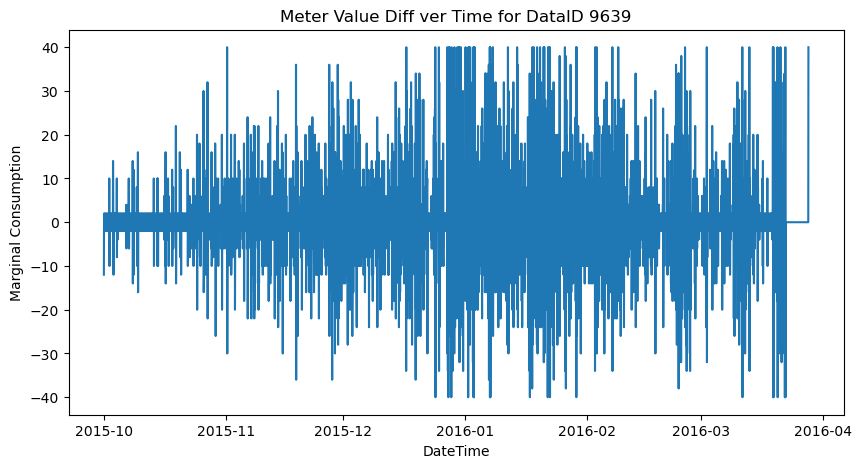

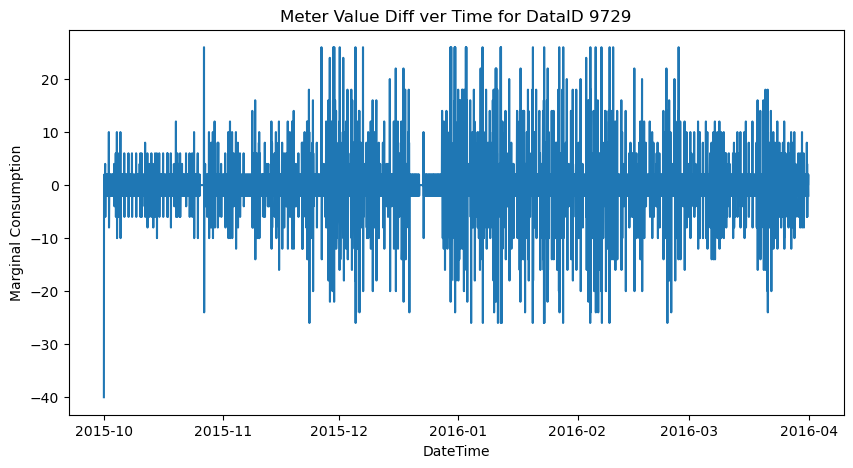

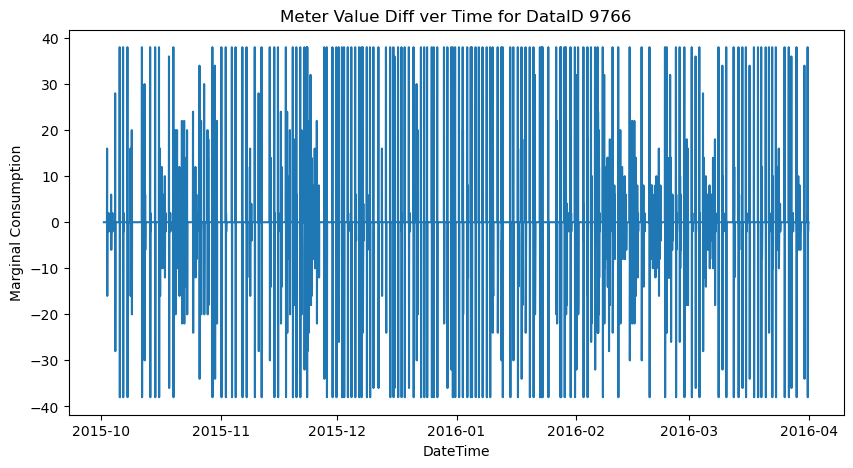

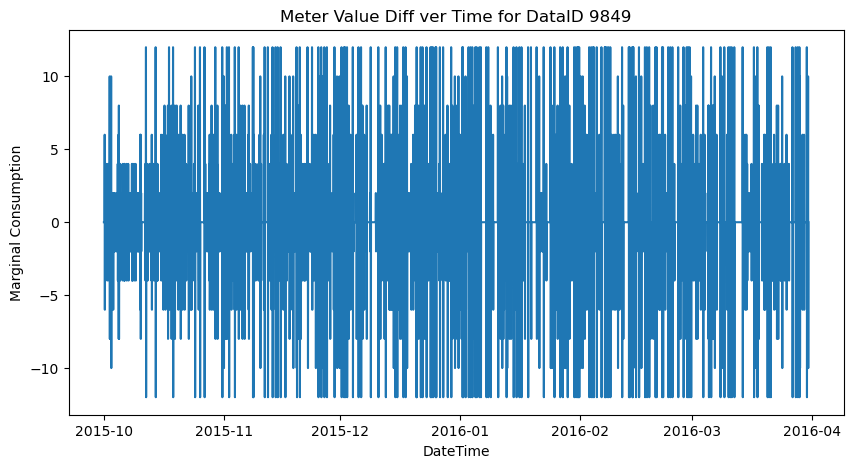

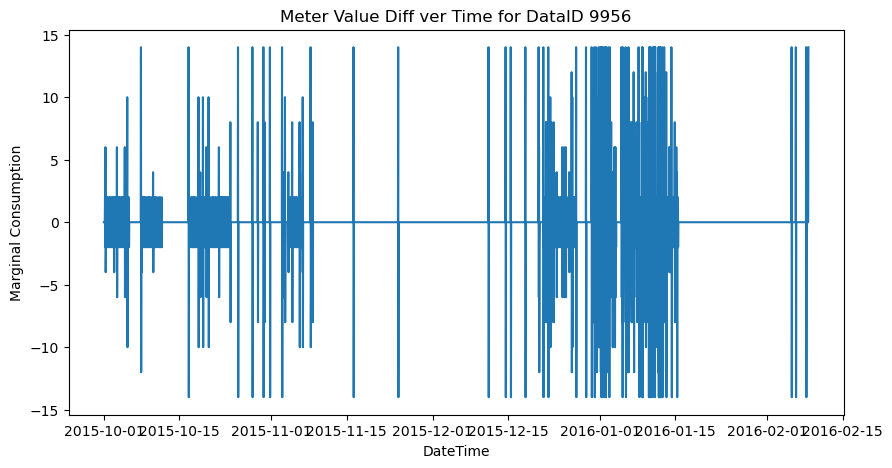

In [64]:
for dataid, group in df_2.groupby('dataid'):
    plt.figure(figsize=(10, 5))
    plt.plot(group.index, group['marginal_diff'], label=f'Meter {dataid}')
    plt.xlabel('DateTime') 
    plt.ylabel('Marginal Consumption')
    plt.title(f'Meter Value Diff ver Time for DataID {dataid}')
    plt.show() 

In [65]:
# from statsmodels.tsa.seasonal import STL

# for dataid, group in df_2.groupby('dataid'):
#     stl = STL(group['marginal_diff'])
#     res = stl.fit()
#     fig = res.plot()
#     plt.show()

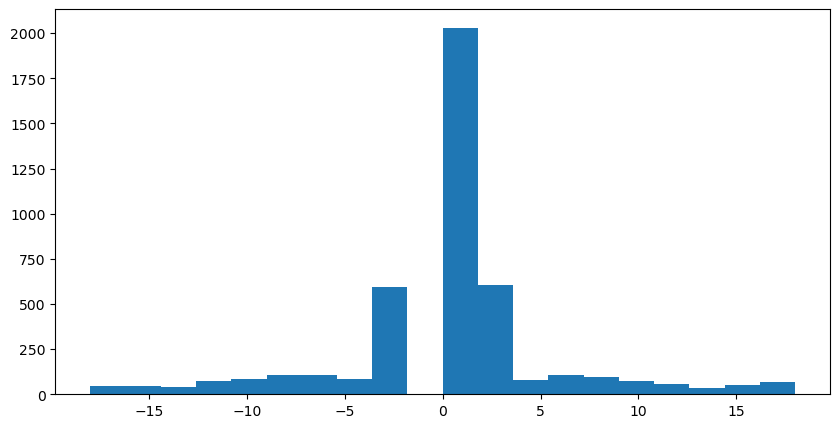

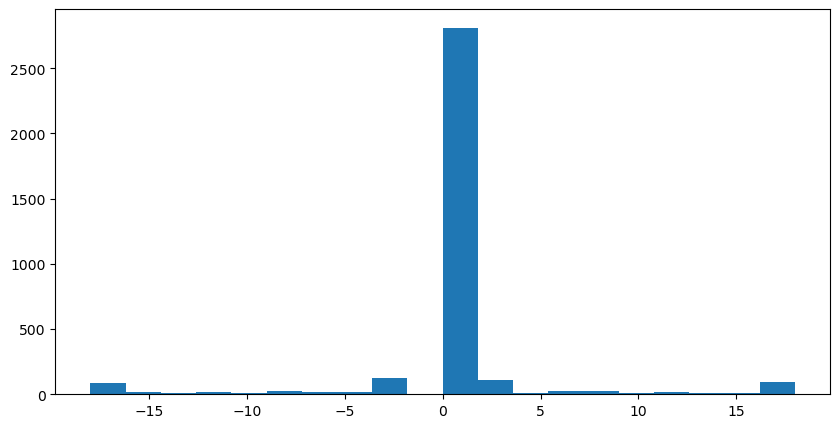

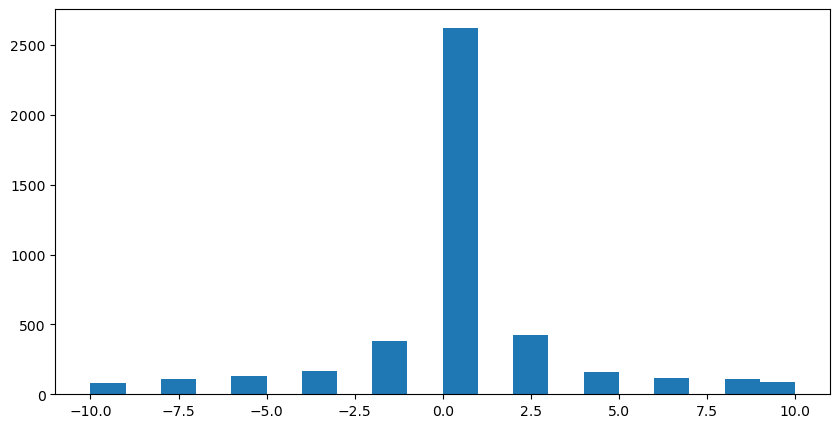

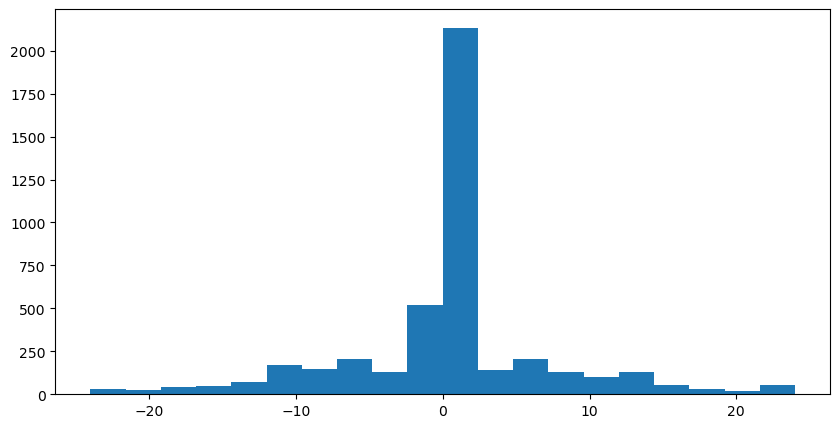

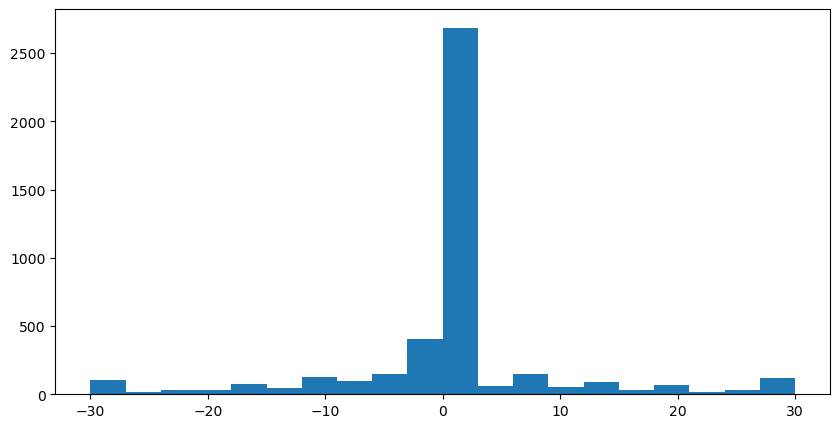

...

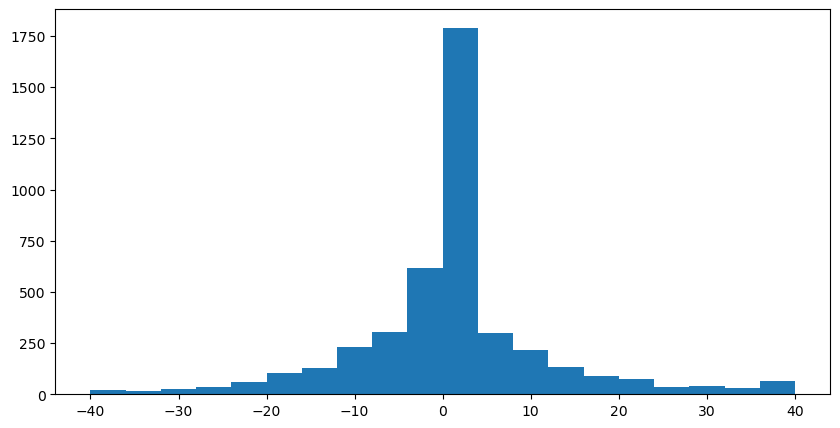

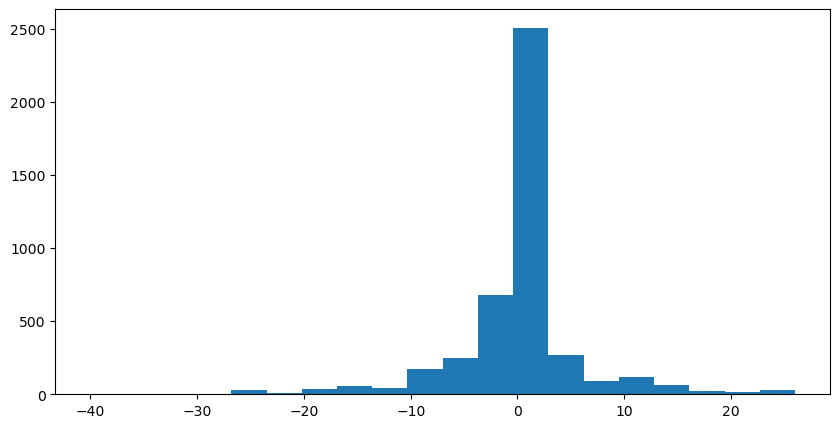

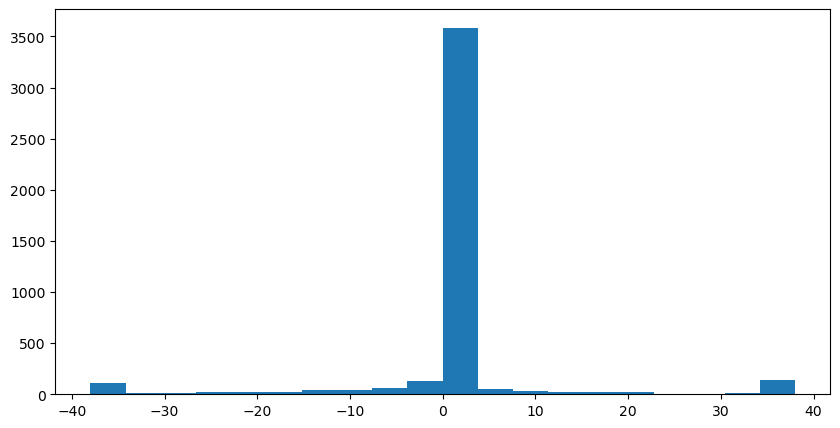

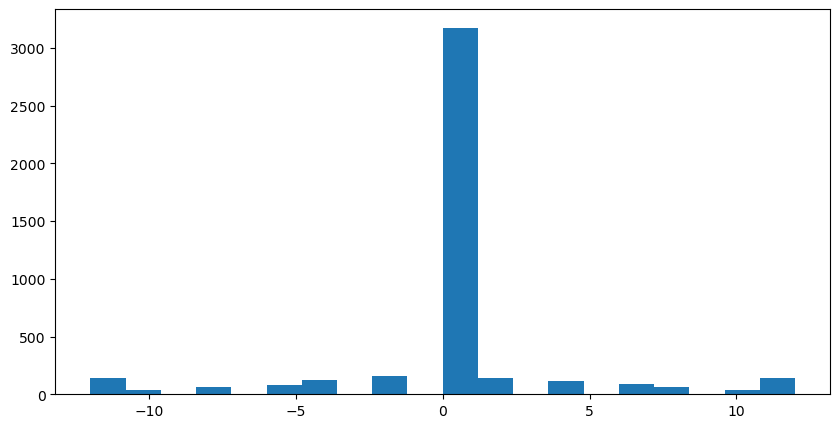

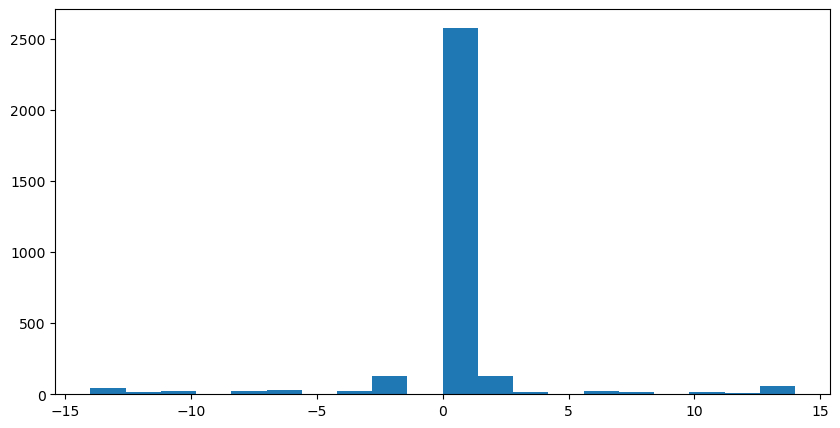

In [66]:
for dataid, group in df_2.groupby('dataid'):
    plt.figure(figsize=(10, 5))
    plt.hist(group['marginal_diff'], label=f'Meter {dataid}', bins=20)
    plt.show()

In [86]:
df_2.reset_index(inplace=True)

In [68]:
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import het_breuschpagan

def test_model(col):
 s = []
 for i in col:
     a = [1,i]
     s.append(a)
 return (np.array(s))

for dataid, group in df_2.groupby('dataid'):
    f = 'marginal_diff~localminute'
    group_model = ols(formula=f, data=group).fit()
    model = test_model(group['marginal_diff'])  
    bp_test = het_breuschpagan(group_model.resid, model)
    print (f'{dataid}')
    if bp_test[1] < 0.05:
        print('heteroschedastic')
    if bp_test[1] >= 0.05:
        print("homo")
    print (bp_test[1])

35
homo
0.9812825076877826
44
heteroschedastic
0.00022019818255954328
77
homo
0.664101510966657
94
homo
0.7856155901663515
114
homo
0.9345846817186078
187
homo
0.20592710435109748
222
heteroschedastic
0.035357349301981277
252
homo
0.8498846169447352
370
homo
0.47683496971653316
483
heteroschedastic
0.02622481307171274
484
homo
0.1930141938325422
661
homo
0.10082081512437342
739
homo
0.518758010797427
744
homo
0.6533524122433902
871
homo
0.7183812614621397
1042
homo
0.8831063977120771
1086
homo
0.3179971684423706
1103
homo
0.8661386684614663
1283
homo
0.9713674464023203
1415
homo
0.929893327938423
1507
homo
0.30838180006468874
1589
homo
0.9234921162696943
1619
homo
0.11815172368300993
1697
homo
0.27095320170605086
1714
homo
0.6638201679759015
1718
heteroschedastic
0.030705400025704037
1790
homo
0.46684080257283067
1791
homo
0.562430692969766
1792
homo
0.1297841891777644
1800
homo
0.8994343991883389
1801
homo
0.6111866252669104
2018
homo
0.28625397615258086
2034
heteroschedastic
0.011519

In [71]:
for dataid, group in df_2.groupby('dataid'):
    f = 'transformed~localminute'
    group_model = ols(formula=f, data=group).fit()t
    model = test_model(group['transformed'])  
    bp_test = het_breuschpagan(group_model.resid, model)
    print (f'{dataid}')
    if bp_test[1] < 0.05:
        print('heteroschedastic')
    if bp_test[1] >= 0.05:
        print("homo")
    print (bp_test[1])

35
homo
0.13989942321407184
44
heteroschedastic
1.543268967278328e-07
77
homo
0.704105556276891
94
heteroschedastic
0.011566112708055763
114
homo
0.6082766612298633
187
homo
0.1627545691021538
222
homo
0.4809457796038419
252
homo
0.36126728874661274
370
homo
0.17856978593834702
483
homo
0.6281008577666847
484
homo
0.27314762678655774
661
homo
0.8478703809521906
739
homo
0.30735761082749613
744
homo
0.08453007126480376
871
homo
0.37085078600690013
1042
homo
0.8192492554709371
1086
homo
0.24617490579081078
1103
homo
0.99626356502231
1283
homo
0.05557949141008428
1415
homo
0.9715813306515942
1507
homo
0.14762746961830137
1589
homo
0.24454470274602444
1619
homo
0.9586212209673878
1697
homo
0.35433307400146363
1714
homo
0.31628776257424995
1718
homo
0.5503961996325497
1790
homo
0.1800648929935221
1791
homo
0.34393015103464386
1792
homo
0.0531581379025335
1800
homo
0.18116827665523957
1801
homo
0.2759075476519257
2018
homo
0.9090706485717762
2034
homo
0.3597222872121131
2072
homo
0.341020018

In [87]:
df_2.to_csv("./formatted_data.csv")